In [1]:
import os
import pickle
import time

os.environ["PRIVBAYES_BIN"] = "./ydnpd/harness/synthesis/privbayes/mac_bin"

import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from IPython.display import display, Markdown
import wandb
import tqdm

import ydnpd
from additional import ADDITIONAL_EXPERIMENTS, ADDITIONAL_PATH

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [3]:
ADDITIONAL_DATASETS = sum(list(ADDITIONAL_EXPERIMENTS.values()), [])

WANDB_GROUPS = ["gen", "gem"] #["acs-core", "edad-core", "we-core", "csv_sdscm", "gen"]

## Tasks

In [4]:
total_task_size = 0
for idx, task in enumerate(ydnpd.span_utility_tasks(additional_datasets=ADDITIONAL_DATASETS), start=1):
    print(f"{idx:2} {task}")
    total_task_size += task.size()
print(f"\nTotal task size: {total_task_size}")

 1 <UtilityTask (#configs=80): aim_jax & acs/gen-MIX-MAX>
 2 <UtilityTask (#configs=80): aim_jax & acs/csv-gpt>
 3 <UtilityTask (#configs=80): aim_jax & acs/gen-gpt-MIX-MAX>
 4 <UtilityTask (#configs=80): aim_jax & acs/sdscm-gpt2>
 5 <UtilityTask (#configs=80): aim_jax & acs/gen-llama-MIX-MAX>
 6 <UtilityTask (#configs=80): aim_jax & acs/sdscm-olmo-1b-hf>
 7 <UtilityTask (#configs=80): aim_jax & acs/gen-gpt-MIX-UNIF>
 8 <UtilityTask (#configs=80): aim_jax & acs/gen-claude-MIX-MAX>
 9 <UtilityTask (#configs=80): aim_jax & acs/csv-claude>
10 <UtilityTask (#configs=80): aim_jax & acs/gen-claude-MIX-UNIF>
11 <UtilityTask (#configs=80): aim_jax & acs/gen-MIX-UNIF>
12 <UtilityTask (#configs=80): aim_jax & acs/gen-llama-MIX-UNIF>
13 <UtilityTask (#configs=80): aim_jax & acs/sdscm-llama-3-8b>
14 <UtilityTask (#configs=80): aim_jax & acs/csv-llama>
15 <UtilityTask (#configs=80): aim_jax & edad/gen-MIX-MAX>
16 <UtilityTask (#configs=80): aim_jax & edad/csv-gpt>
17 <UtilityTask (#configs=80): aim

## Load Results from W&B

In [5]:
# utility_tasks_results = []

# for group in WANDB_GROUPS:

#     try:
#         del api
#     except NameError:
#         pass

#     api = wandb.Api(timeout=60)

#     success = False
#     while not success:
#         try:
#             run_results = []

#             runs = api.runs(path=f"shlomihod/ydnpd-harness", filters={"group": group})

#             for run in tqdm.tqdm(runs):
#                     for step_data in run.history().to_dict(orient="records"):

#                         # TODO: why does this happen?
#                         if step_data["_step"] >= ydnpd.harness.config.NUM_RUNS:
#                             print(f"Run {run.id} has more than {ydnpd.config.NUM_RUNS} steps")
#                             continue

#                         for metric in step_data:
#                             if not metric.startswith("_") and step_data[metric] in ["NaN"]:
#                                 print(f"Run {run.id} with NaN at metric {metric}")
#                                 step_data[metric] = np.nan

#                         utility_tasks_results.append(dict(run.config) | {"evaluation": step_data})

#         except Exception as err :
#             print(f"Error: {err}")
#             print(f"Failed {group}! Try again...")
#         else:
#             success = True
#             utility_tasks_results.extend(run_results)
#             time.sleep(10)

In [6]:
with open("./results/harness.pkl", "rb") as f:
    utility_tasks_results = pickle.load(f)

## Missing Runs

In [7]:
# ydnpd.analyze_grid_search_completeness(utility_tasks_results, ADDITIONAL_DATASETS)

## Utility-Related Tasks

In [8]:
utility_tasks_results = [x for x in utility_tasks_results
                         if not (x["dataset_name"].startswith("edad/gen-llama") or x["dataset_name"].startswith("edad/sdscm-gpt2"))]

for x in utility_tasks_results:
    if type(x["evaluation"]["error_rate_diff"]) == list:
        assert len(x["evaluation"]["error_rate_diff"]) == 1
        x["evaluation"]["error_rate_diff"] = x["evaluation"]["error_rate_diff"][0]


In [10]:
SUBSET_ADDITIONAL_DATASETS = ["csv"] # csv, UNIF, sdscm
SUBSET_ADDITIONAL_EXPERIMENTS = {
    family: [dataset_pointer for dataset_pointer in family_datasets if any(model_name in dataset_pointer[0] for model_name in SUBSET_ADDITIONAL_DATASETS)]
    for family, family_datasets in ADDITIONAL_EXPERIMENTS.items()

}

SUBSET_ADDITIONAL_EXPERIMENTS

{'acs': [('acs/csv-gpt', 'llm_datasets'),
  ('acs/csv-claude', 'llm_datasets'),
  ('acs/csv-llama', 'llm_datasets')],
 'edad': [('edad/csv-gpt', 'llm_datasets'),
  ('edad/csv-claude', 'llm_datasets'),
  ('edad/csv-llama', 'llm_datasets')],
 'we': [('we/csv-gpt', 'llm_datasets'),
  ('we/csv-claude', 'llm_datasets'),
  ('we/csv-llama', 'llm_datasets')]}

## ACS

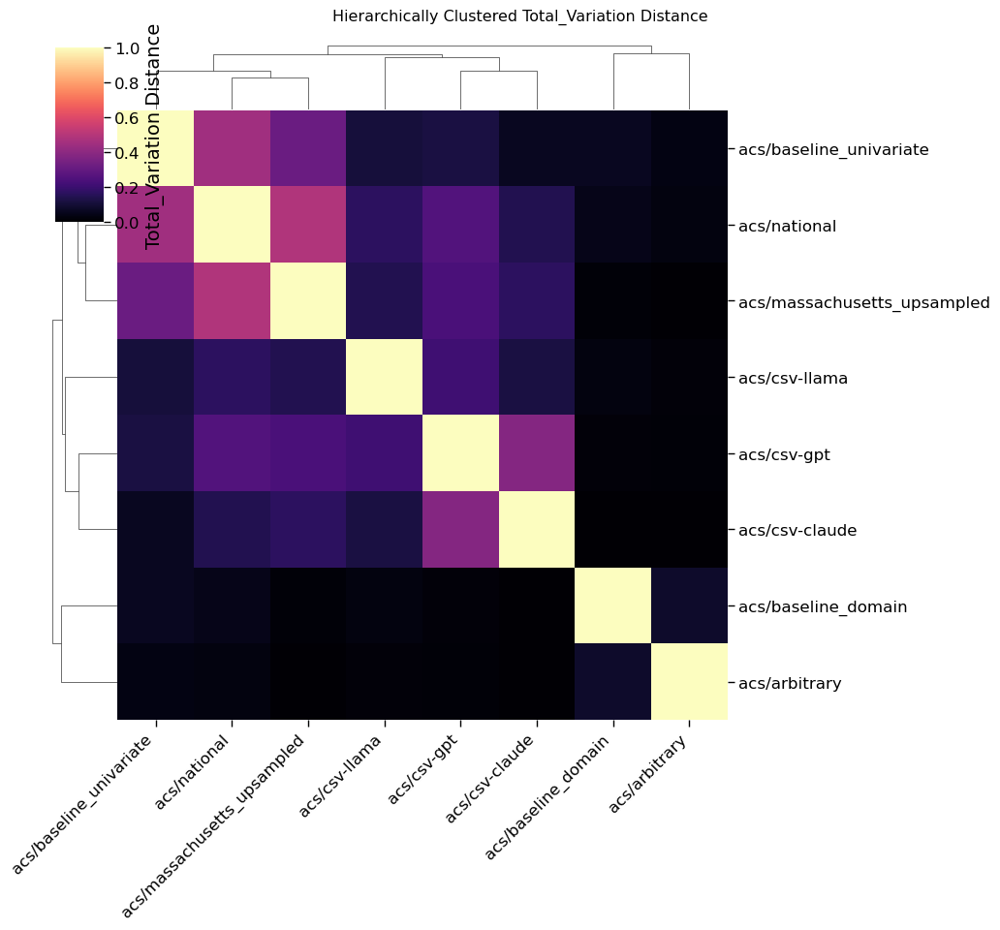


Processing measure: correspond_test

Processing measure: best_dev


/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:555: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:555: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:555: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:569: UserWarning:

Tight layout not applied. tight_layout cannot make Axes height small enough to accommodate all Axes decorations.



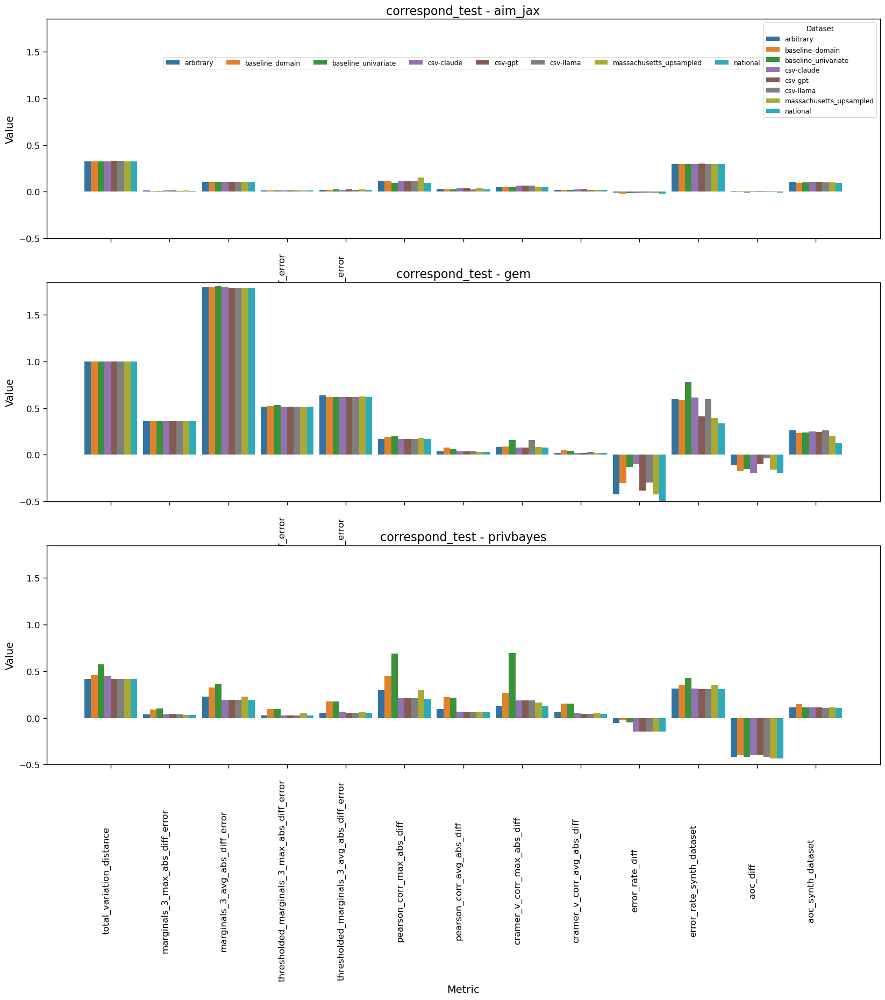

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:555: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:555: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:555: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:569: UserWarning:

Tight layout not applied. tight_layout cannot make Axes height small enough to accommodate all Axes decorations.



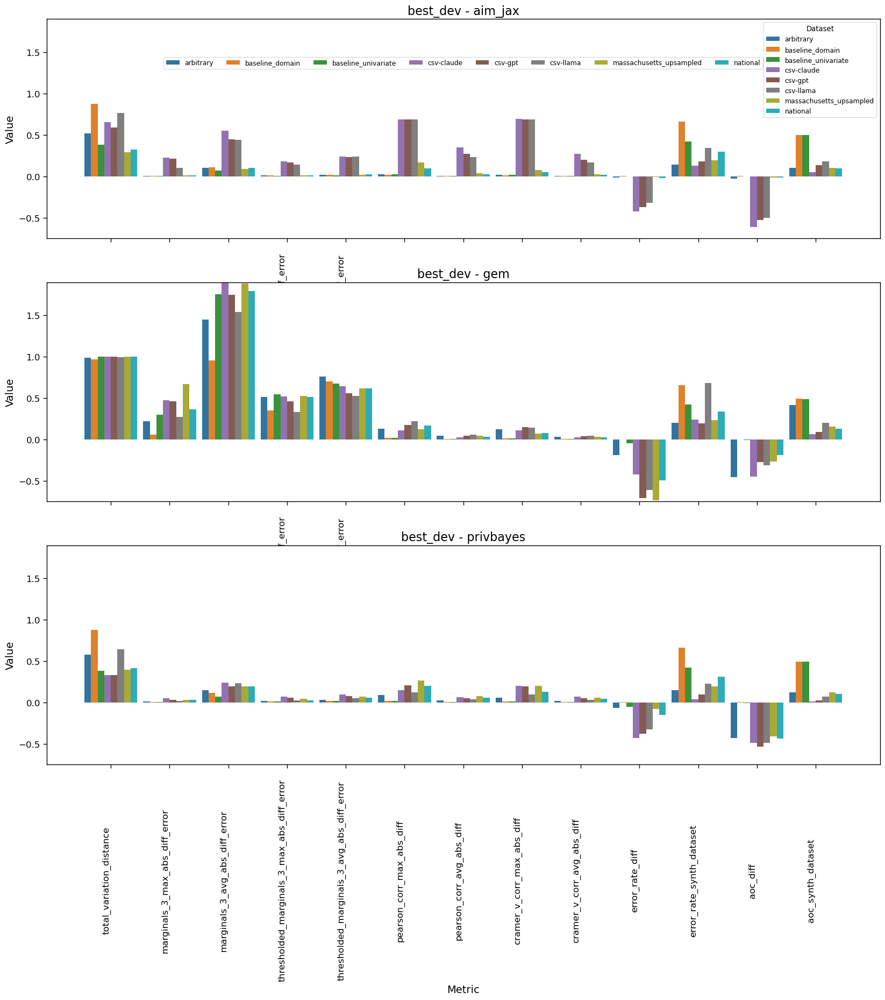

### total_variation_distance

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

18.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



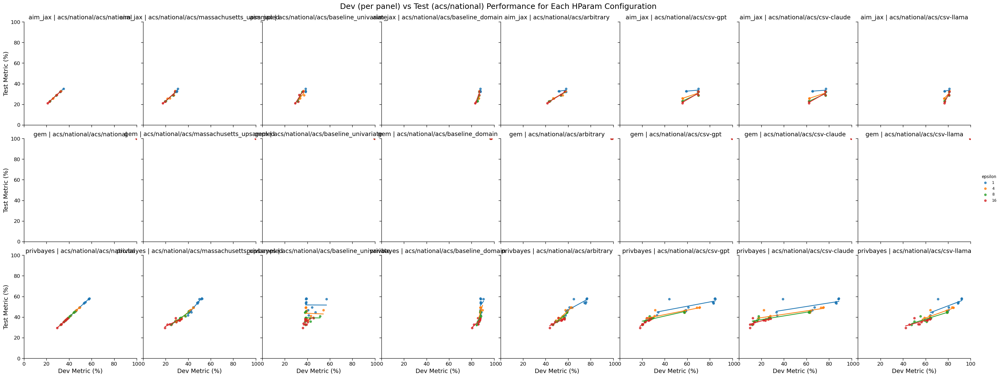

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



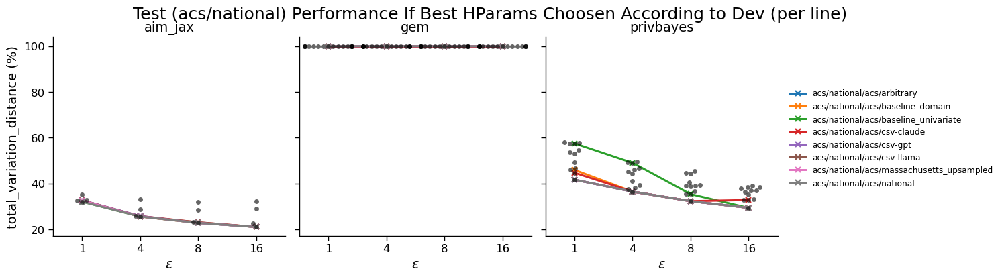

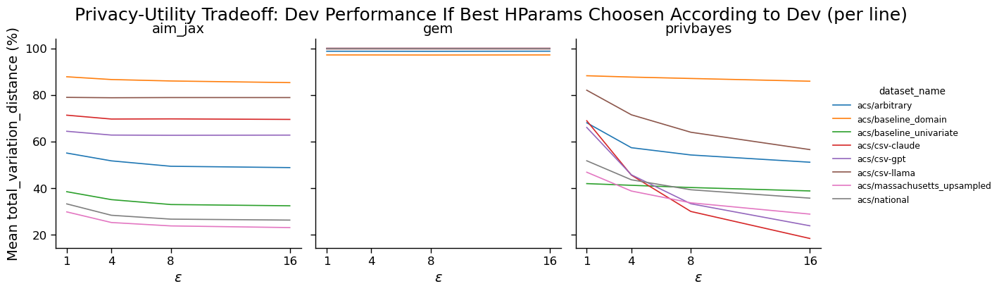

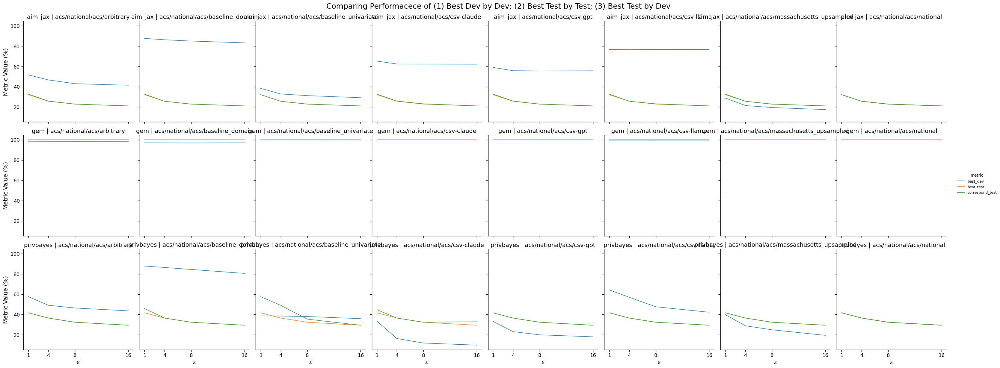

### marginals_3_max_abs_diff_error

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

18.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



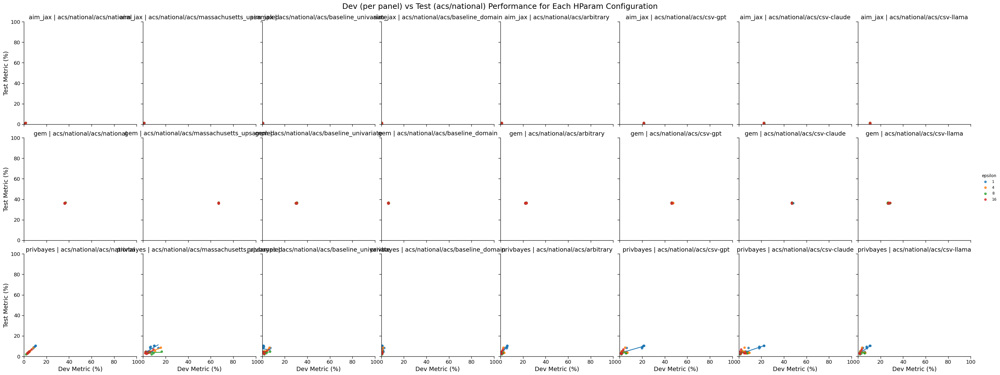

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



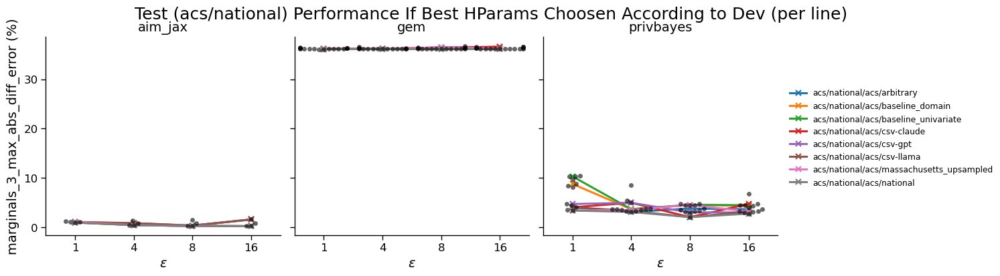

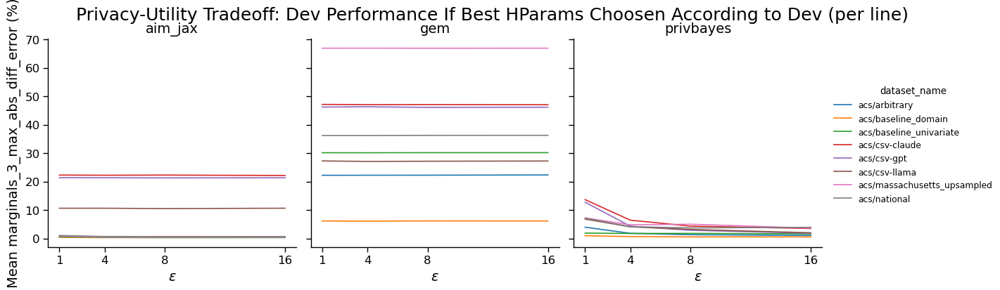

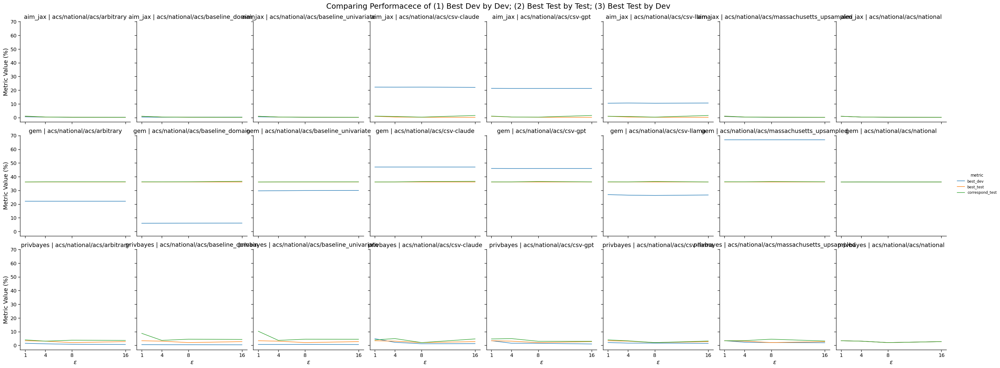

### marginals_3_avg_abs_diff_error

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

18.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



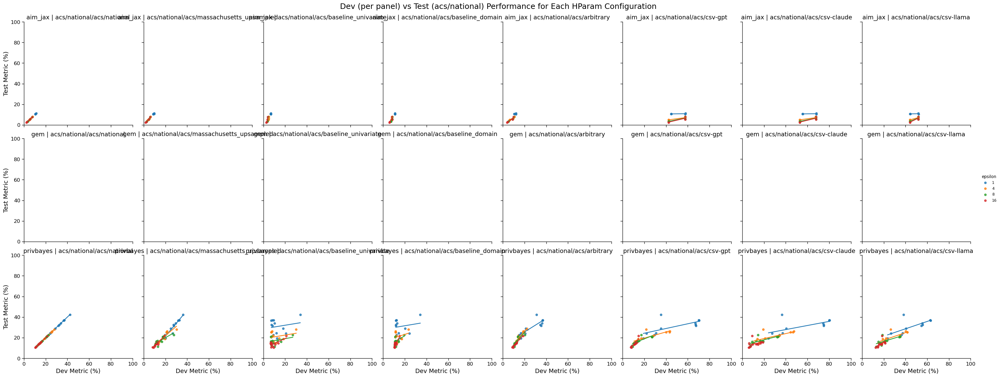

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



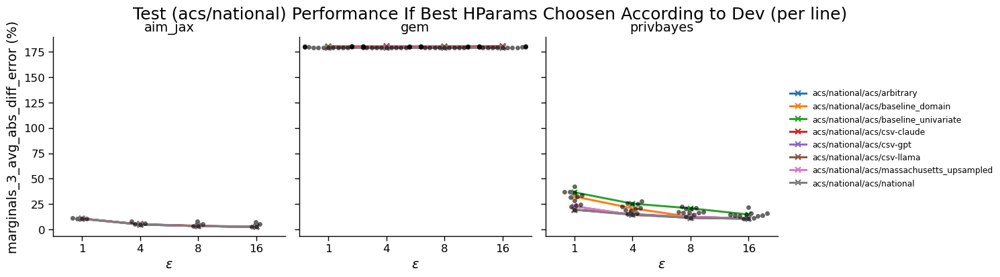

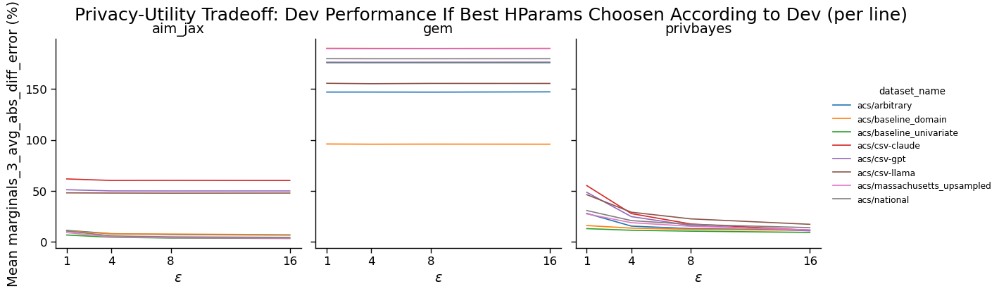

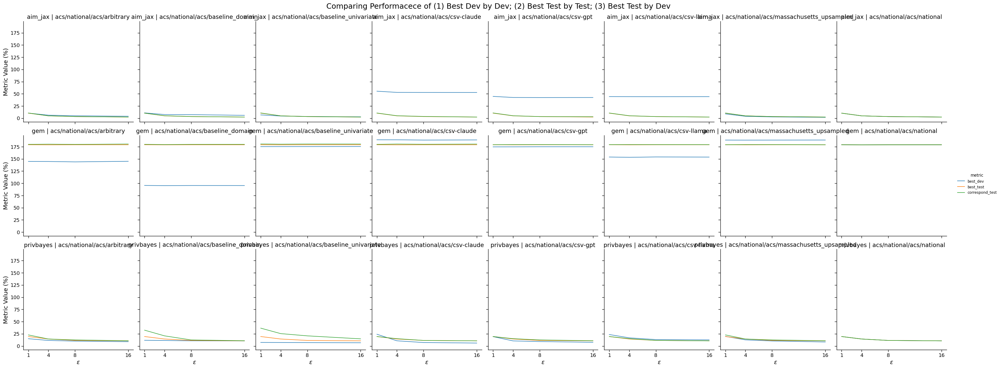

### thresholded_marginals_3_max_abs_diff_error

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

18.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

12.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/catego

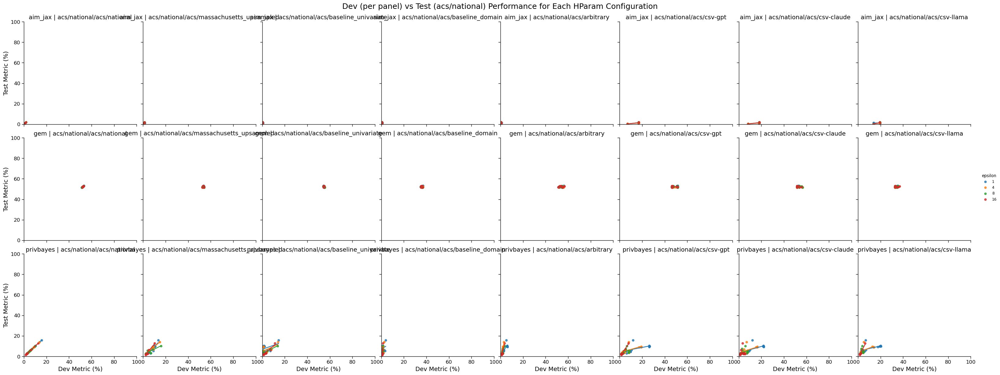

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

37.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



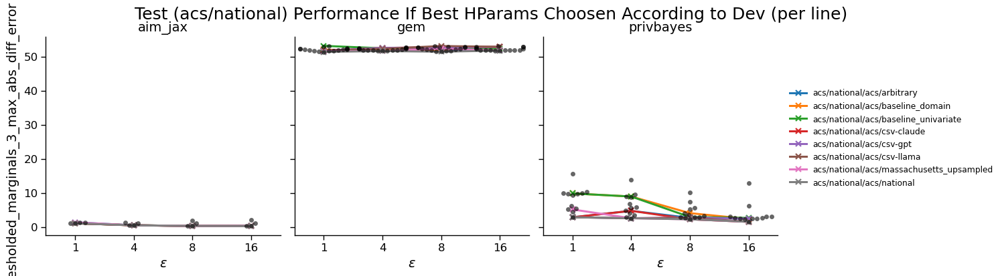

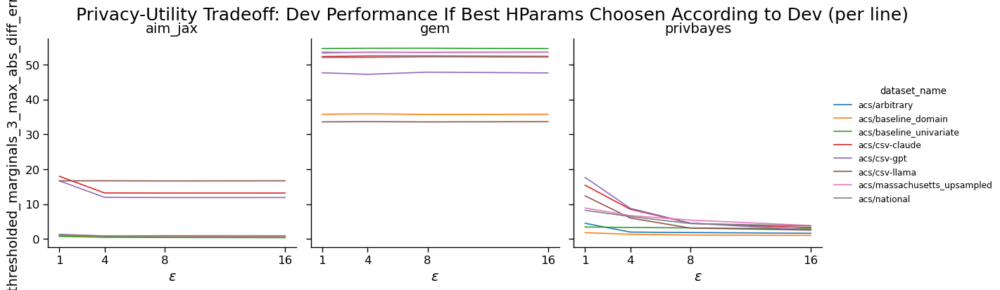

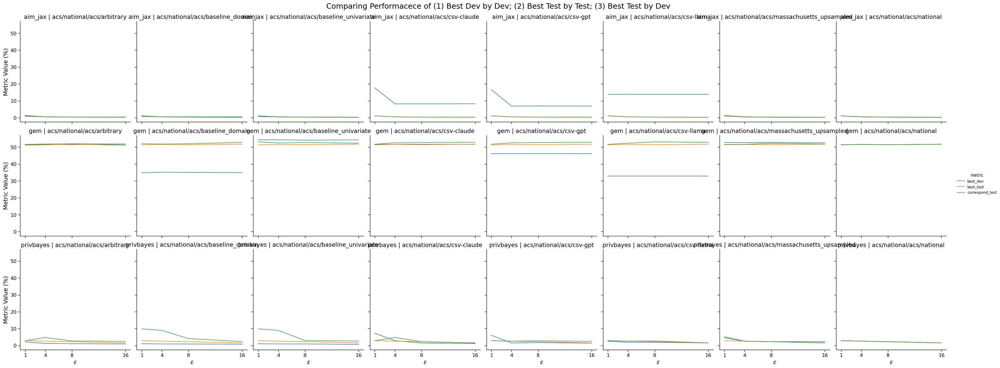

### thresholded_marginals_3_avg_abs_diff_error

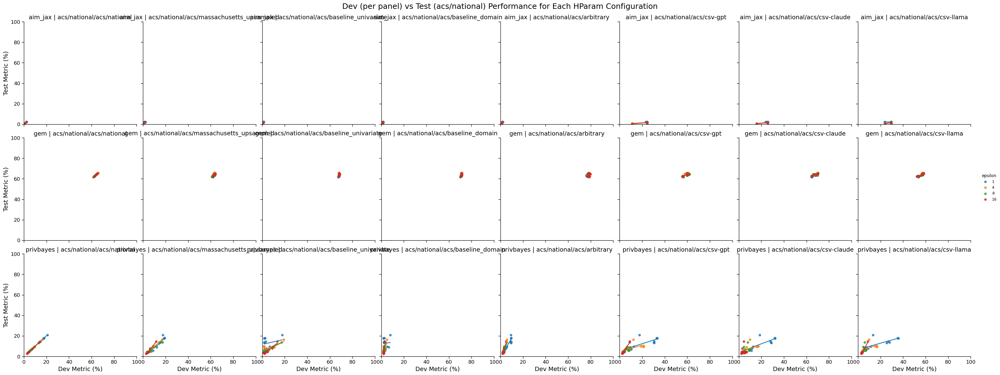

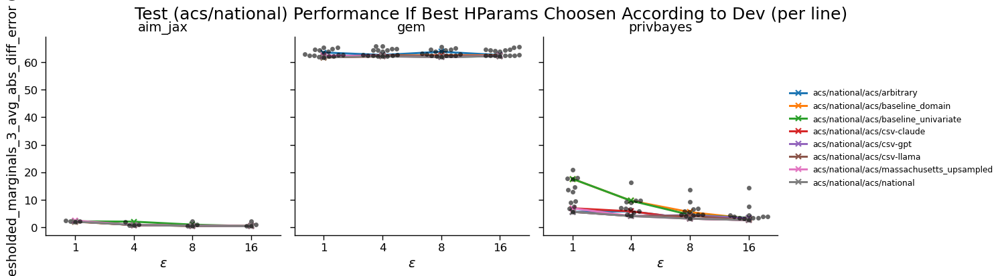

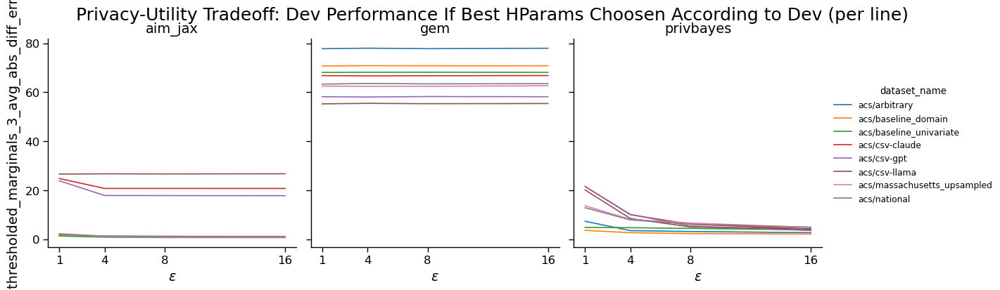

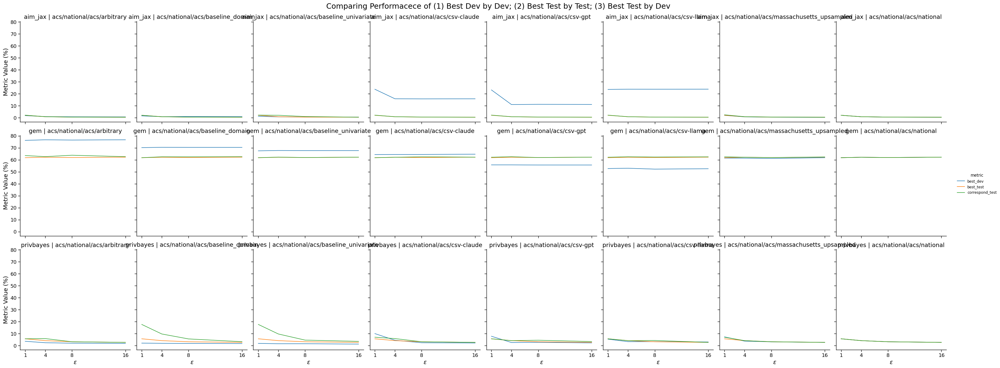

### pearson_corr_max_abs_diff

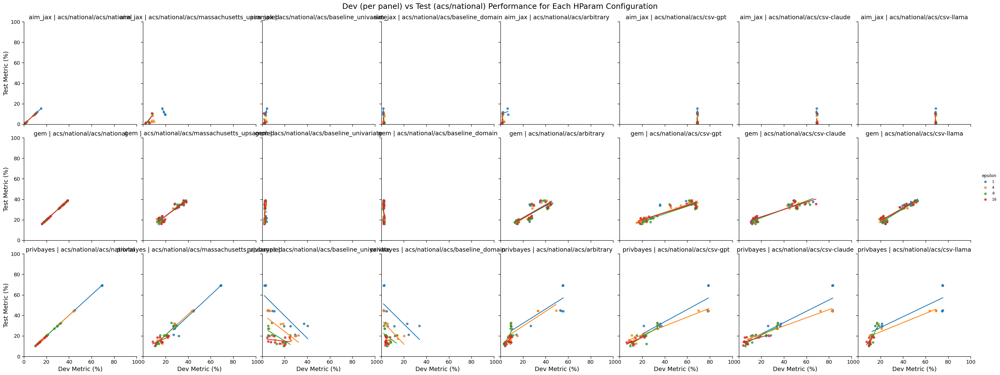

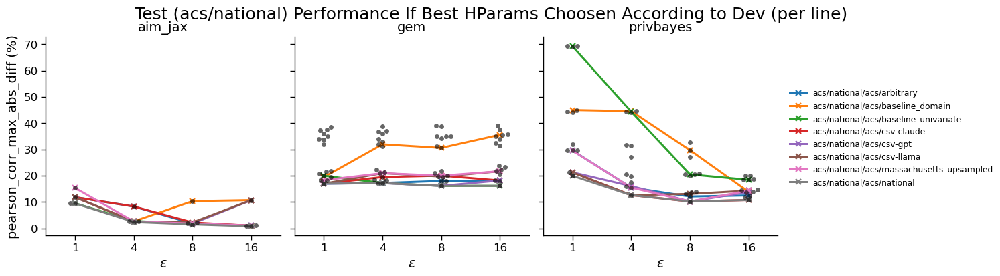

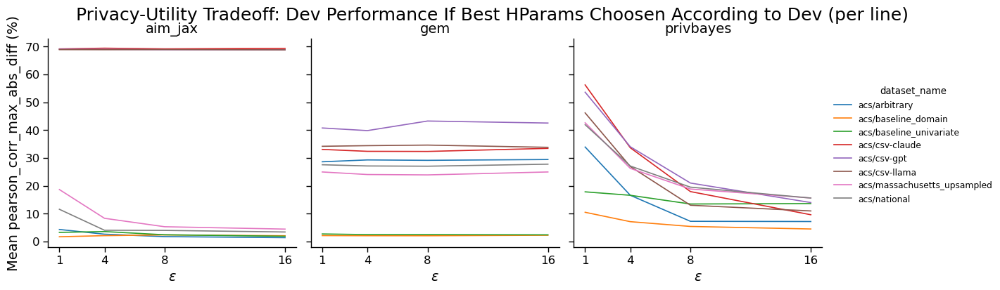

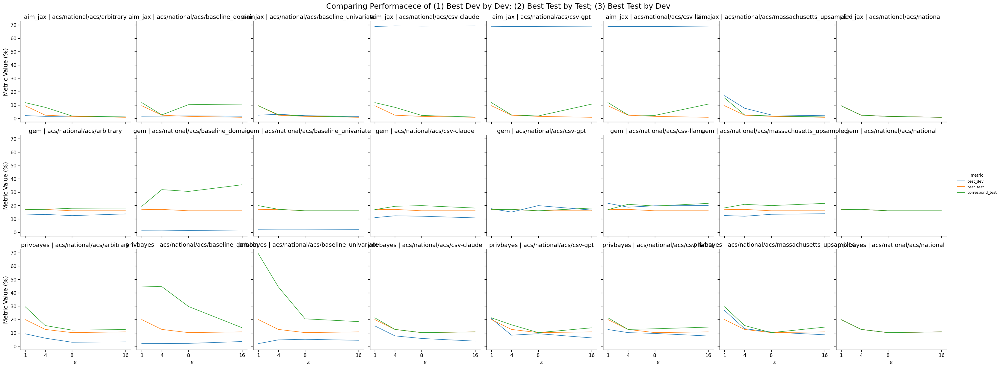

### pearson_corr_avg_abs_diff

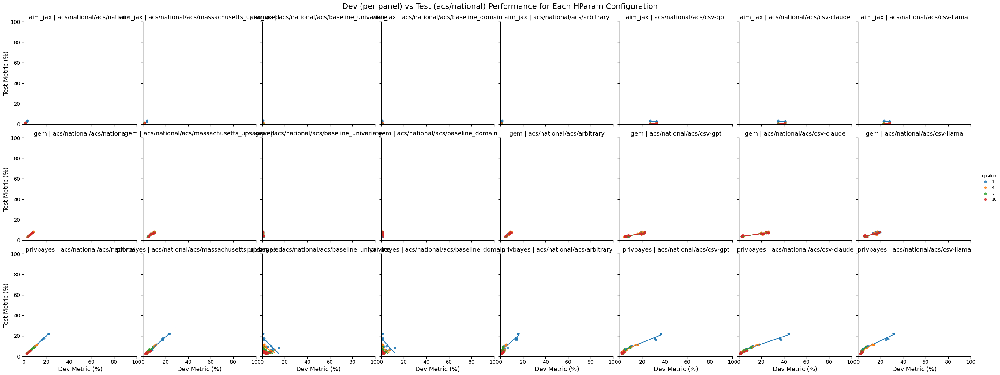

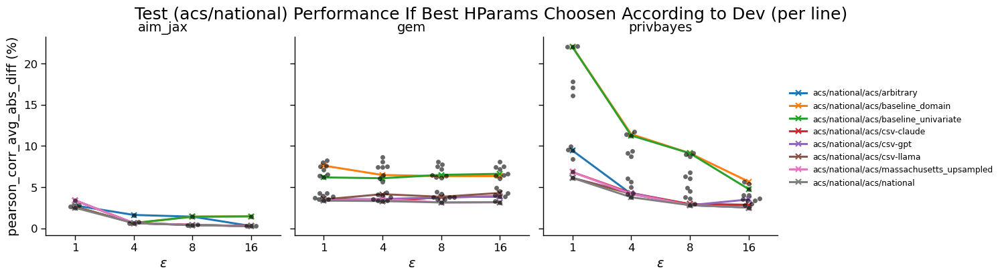

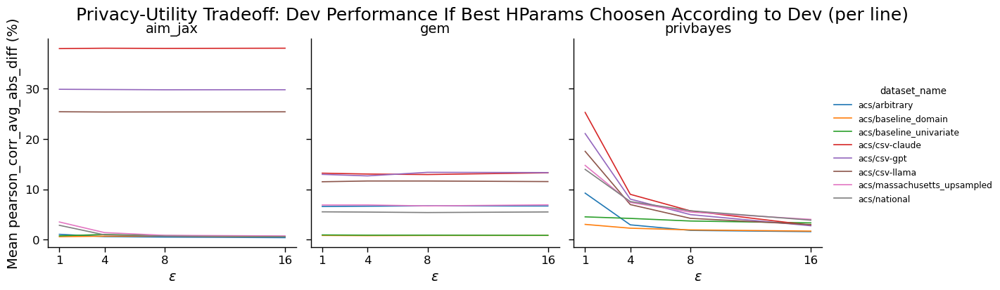

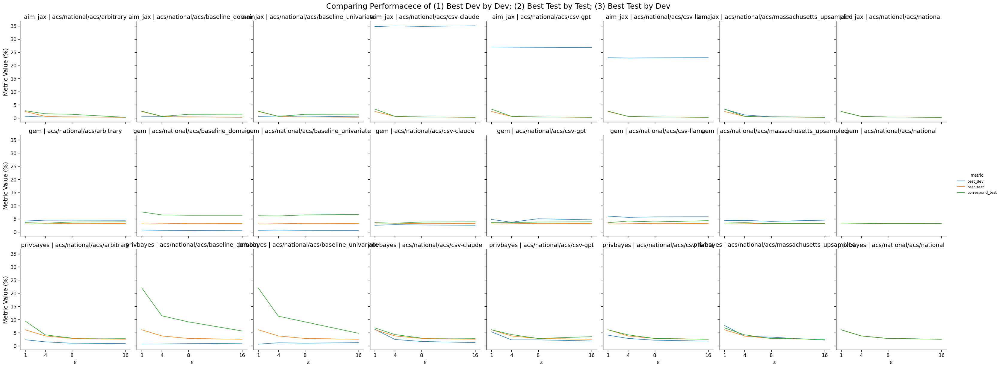

### cramer_v_corr_max_abs_diff

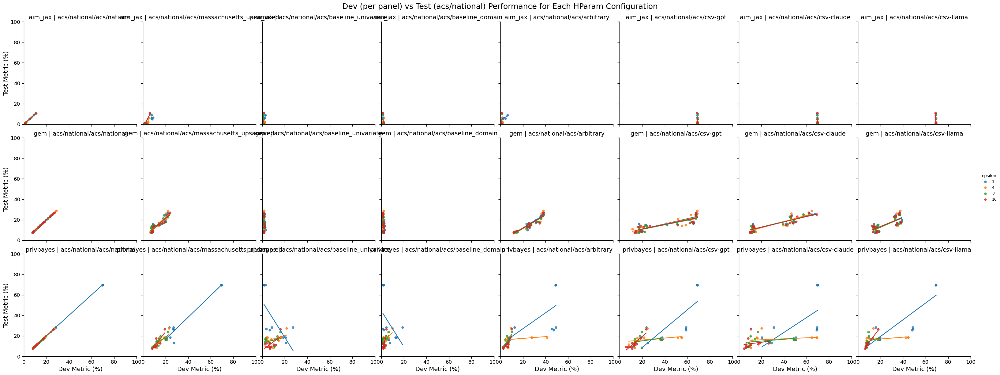

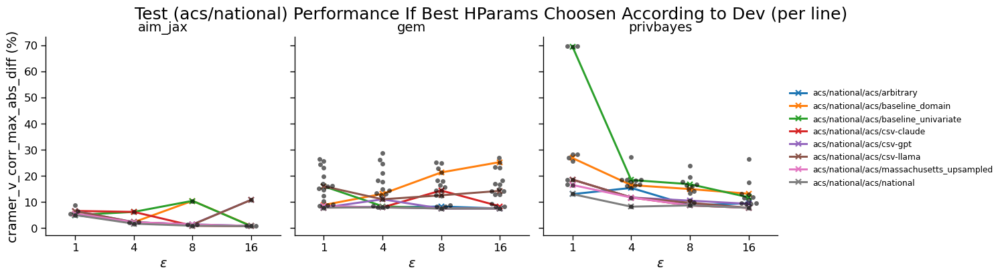

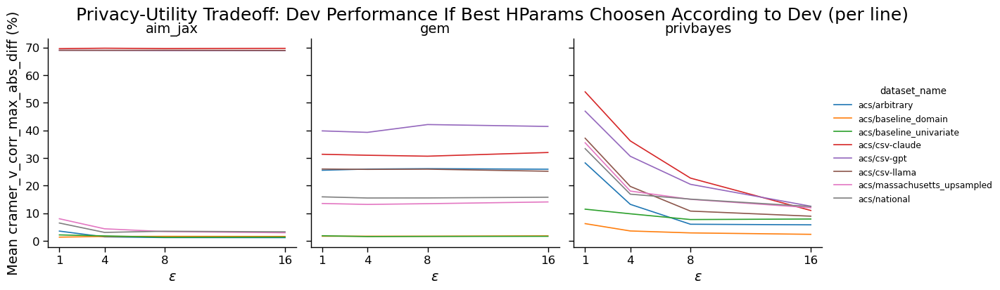

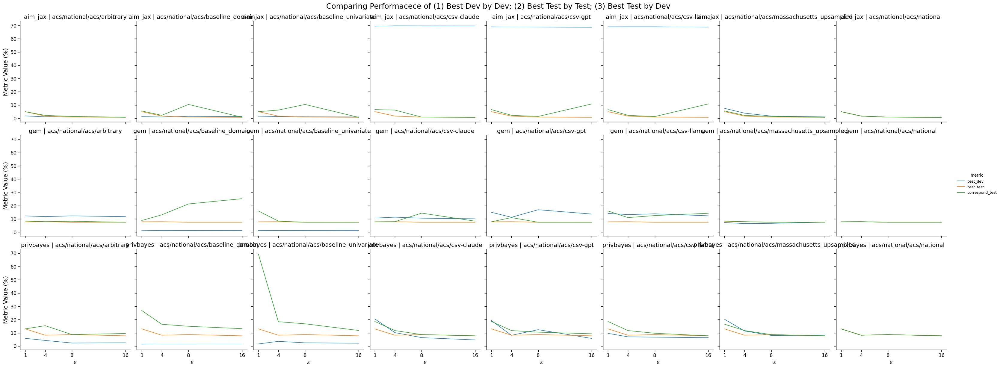

### cramer_v_corr_avg_abs_diff

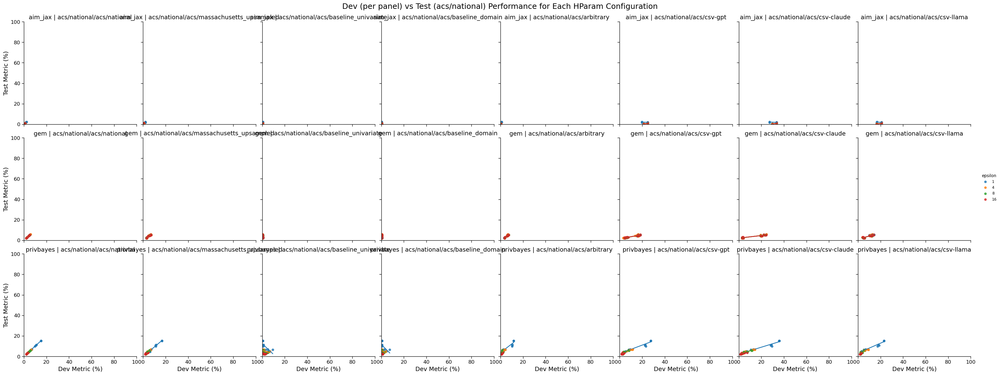

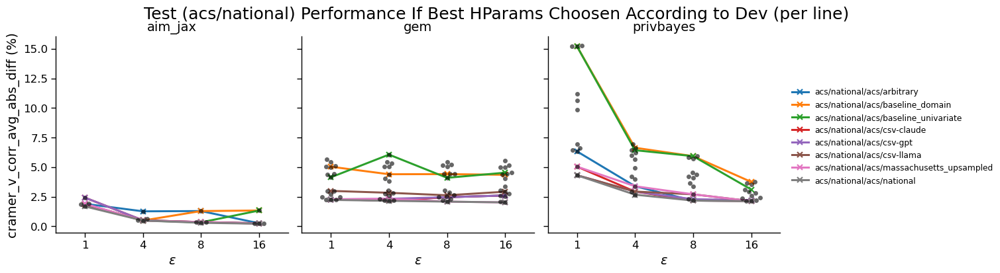

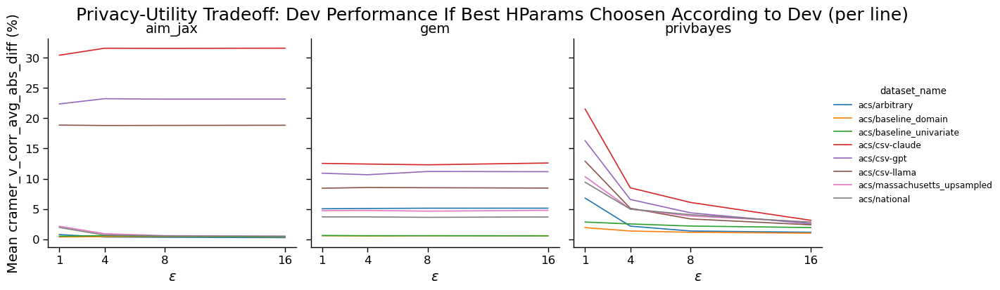

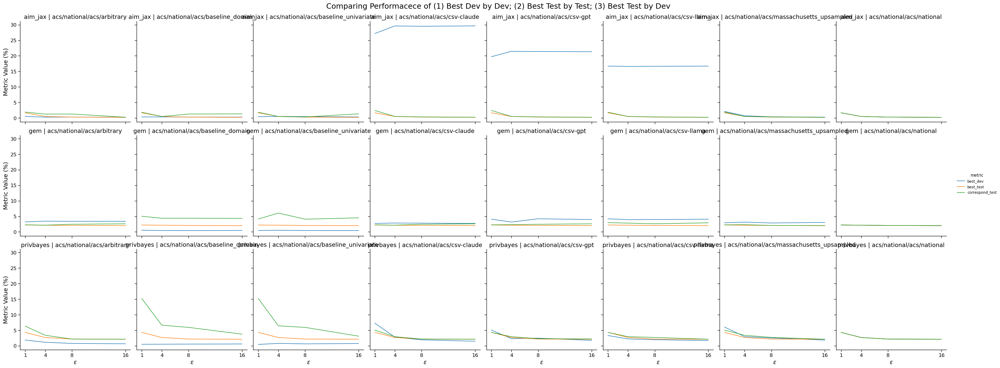

### error_rate_diff

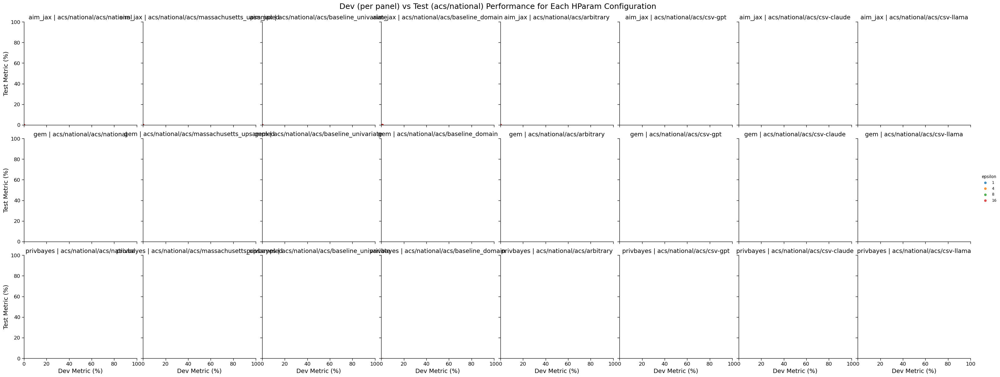

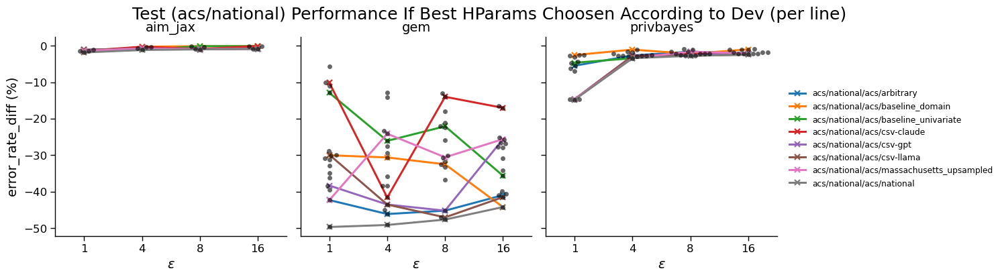

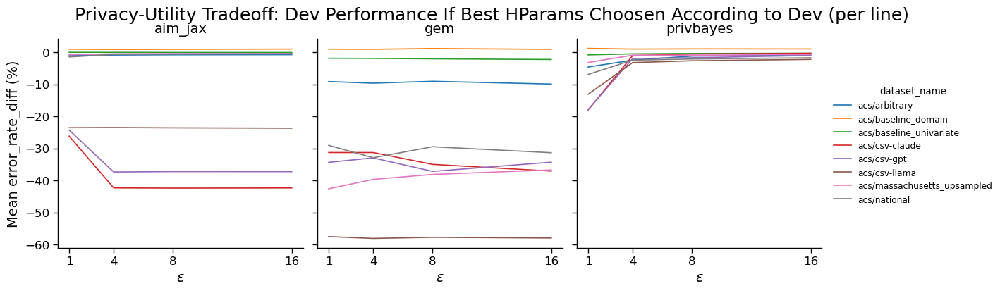

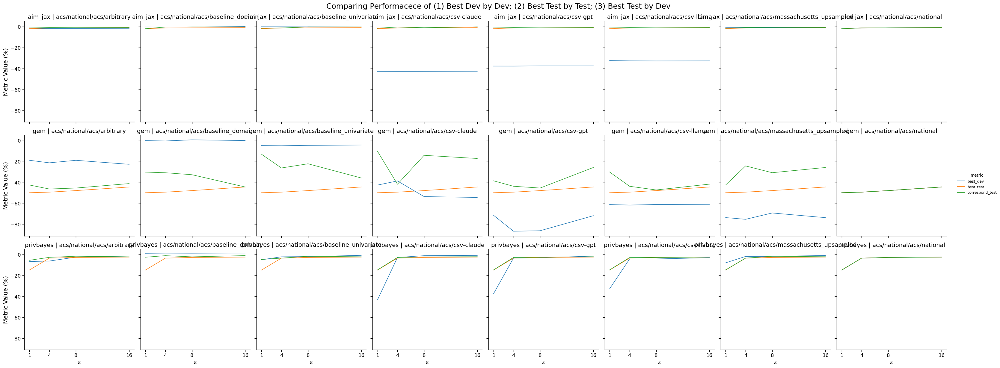

### error_rate_train_dataset

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/catego

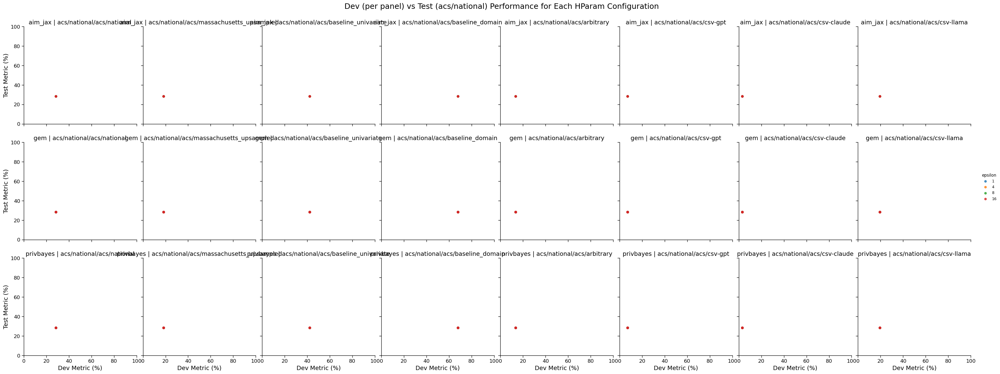

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



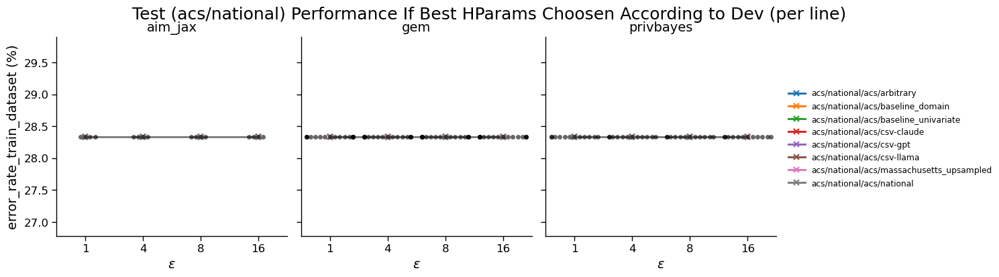

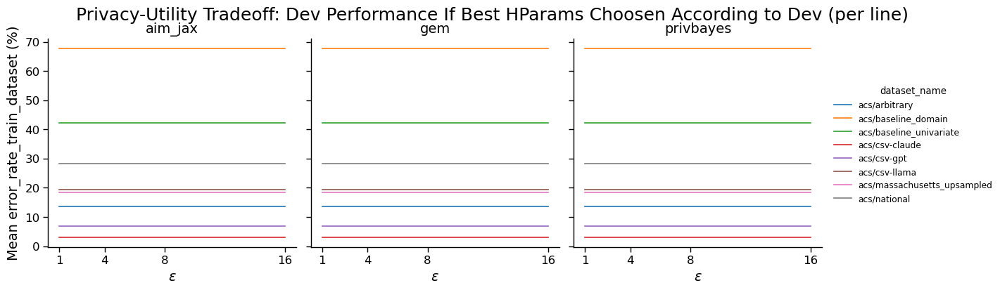

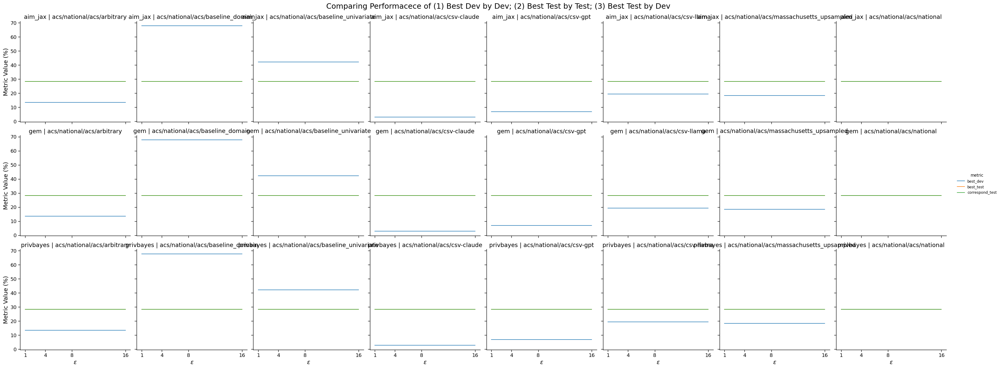

### error_rate_synth_dataset

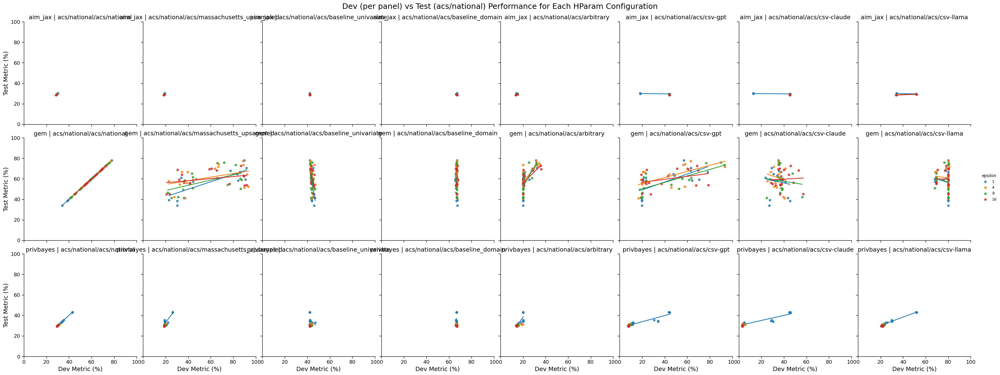

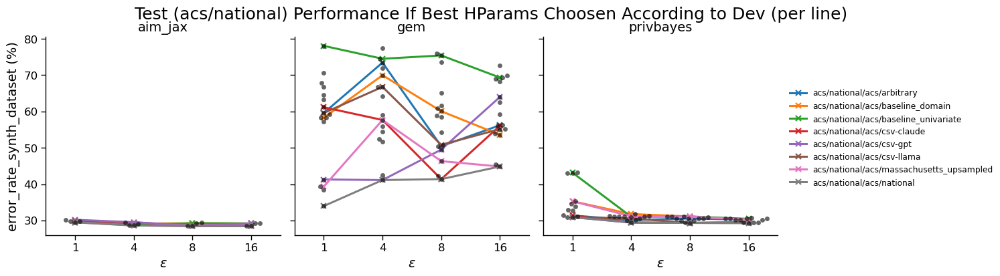

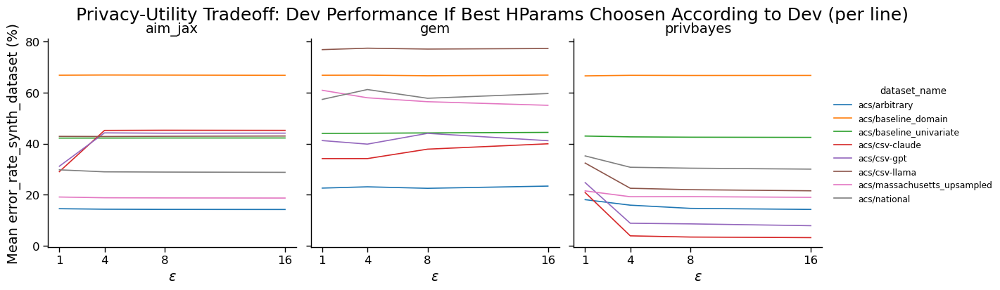

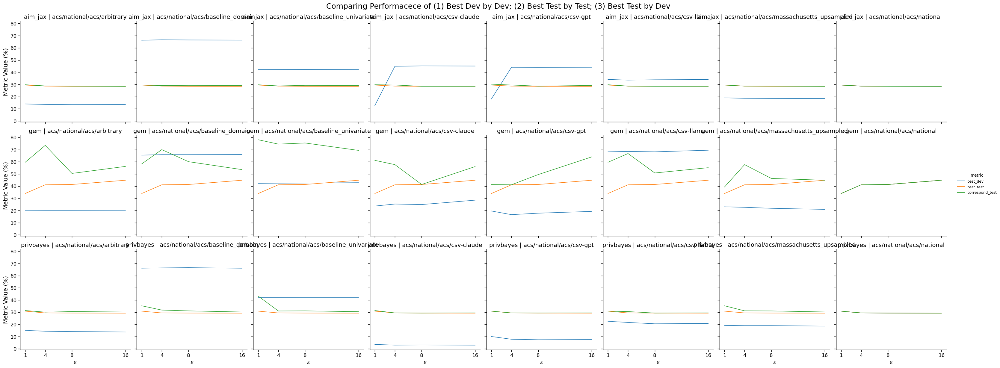

### aoc_diff

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

8.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



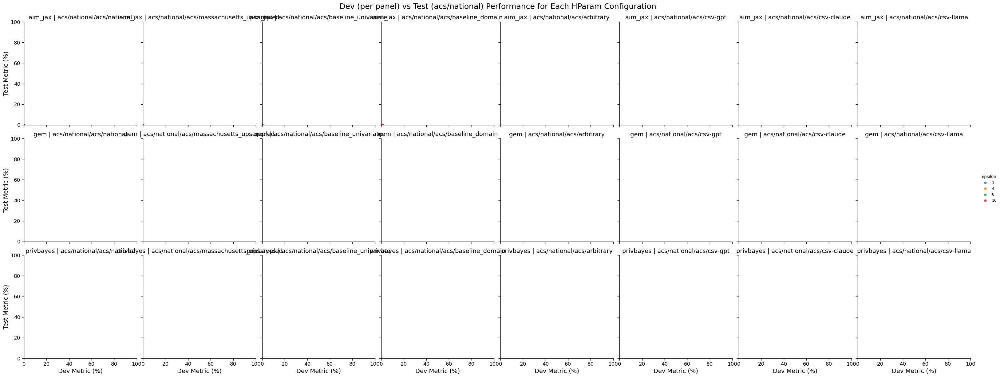

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

8.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



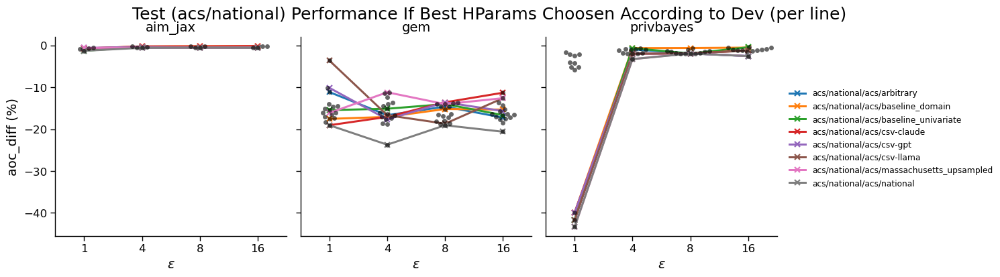

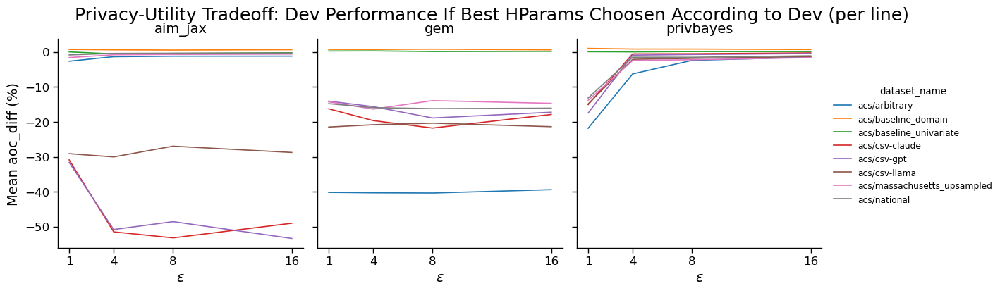

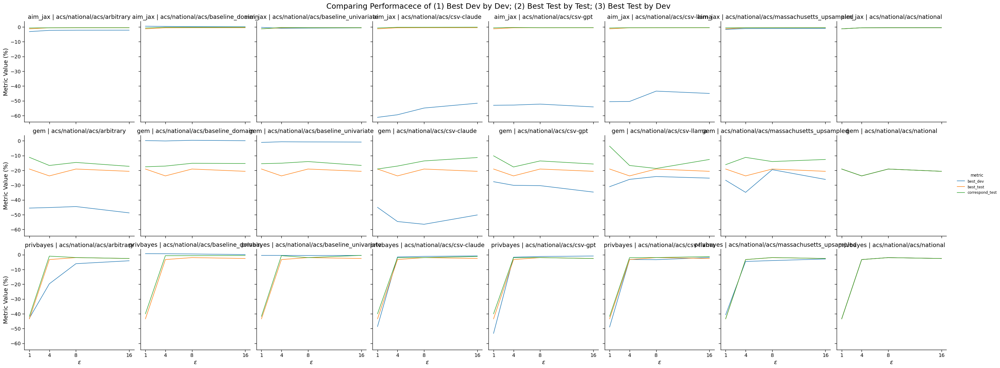

### aoc_train_dataset

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/catego

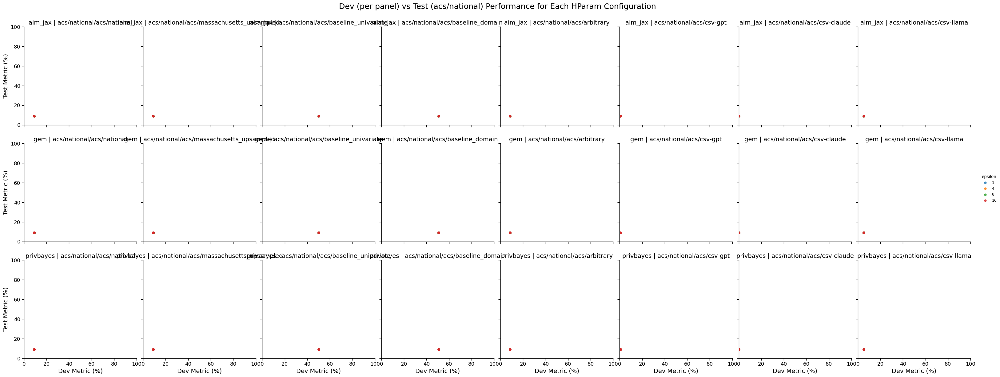

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



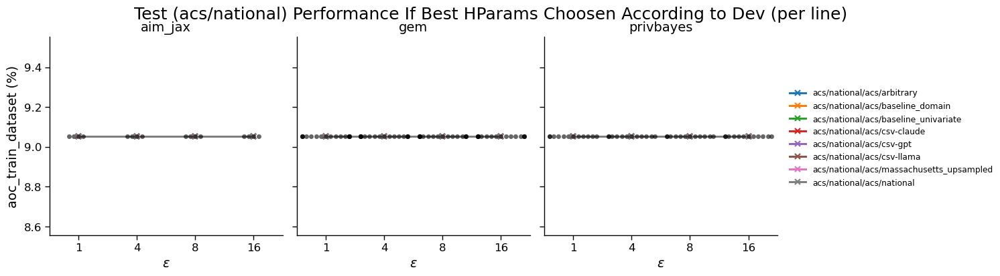

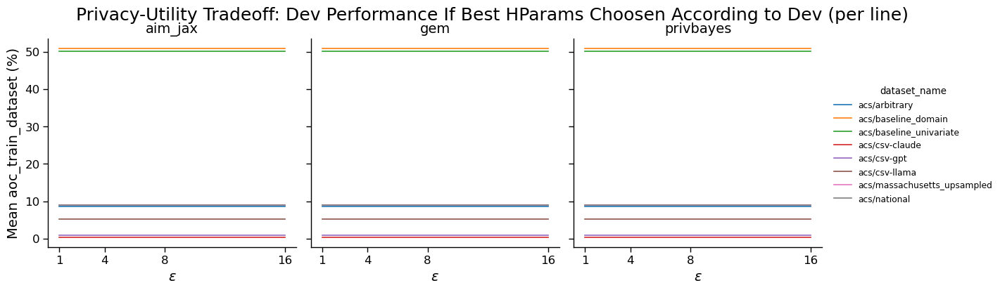

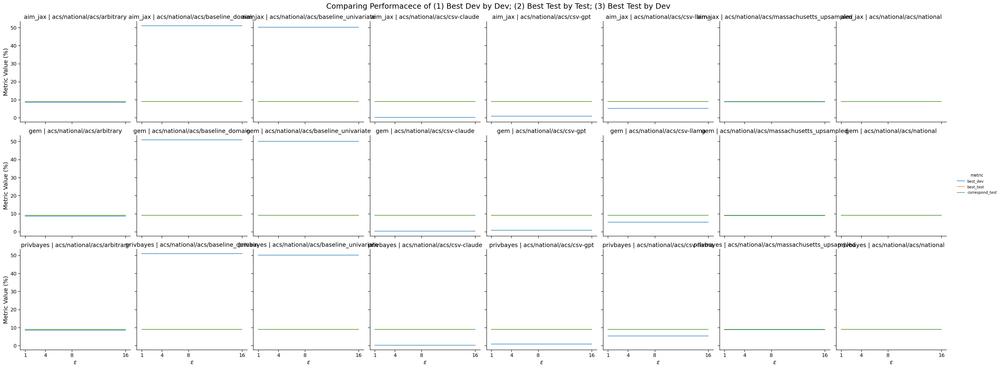

### aoc_synth_dataset

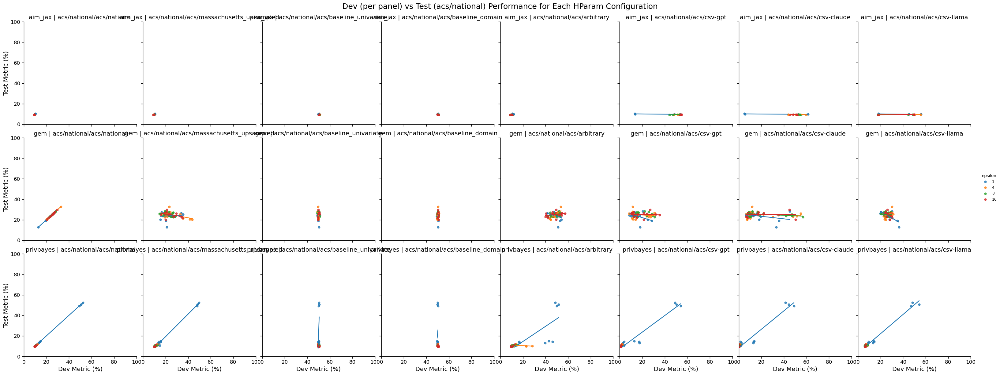

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

8.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



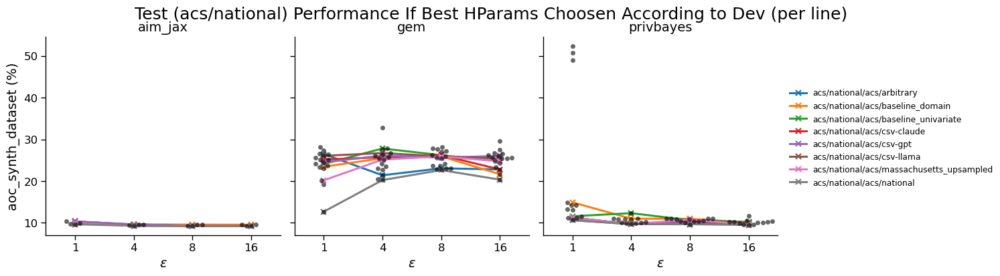

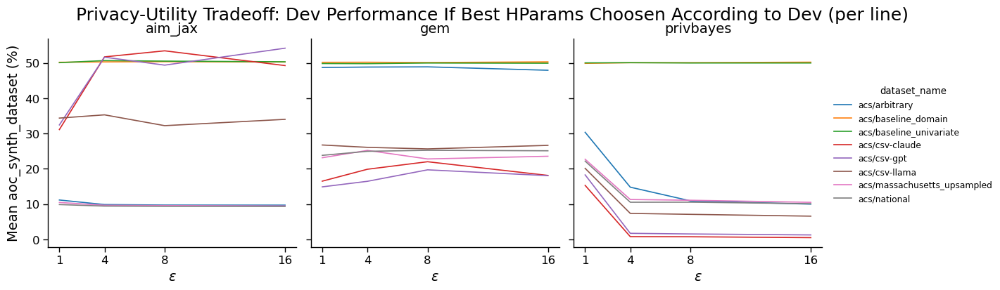

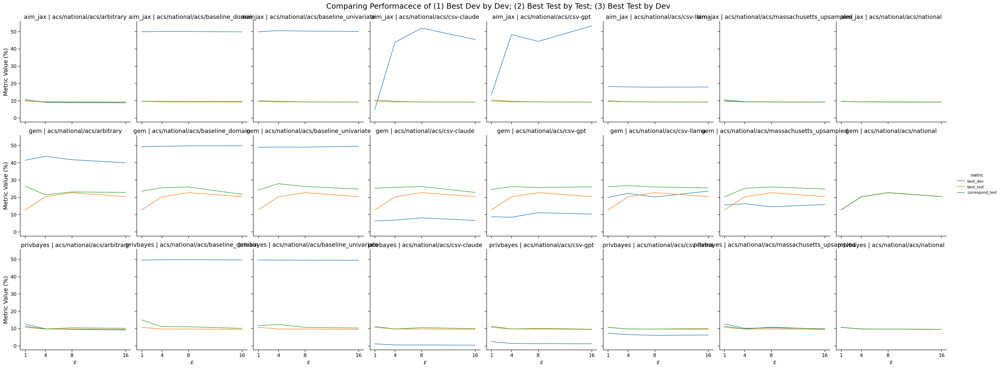

### total_variation_distance

quantile  \
synth_name experiment                               epsilon             
aim_jax    acs/national/acs/arbitrary               1            25.0   
                                                    4            25.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/baseline_domain         1            25.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/baseline_univariate     1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-claude              1            25.0   
                                                    4            25.0   
                                                    8            25.0   
                                                    16            0.0   
           acs/national/acs/csv-gpt                 1            50.0   
                                                    4            25.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-llama               1            50.0   
                                                    4             0.0   
                                                    8            25.0   
                                                    16            0.0   
           acs/national/acs/massachusetts_upsampled 1            25.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/national                1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
gem        acs/national/acs/arbitrary               1            75.0   
                                                    4            31.2   
                                                    8            93.8   
                                                    16           50.0   
           acs/national/acs/baseline_domain         1            31.2   
                                                    4            31.2   
                                                    8            25.0   
                                                    16           25.0   
           acs/national/acs/baseline_univariate     1            31.2   
                                                    4            31.2   
                                                    8            56.2   
                                                    16           50.0   
           acs/national/acs/csv-claude              1            93.8   
                                                    4            87.5   
                                                    8            93.8   
                                                    16           93.8   
           acs/national/acs/csv-gpt                 1             6.2   
                                                    4             0.0   
                                                    8            81.2   
                                                    16           25.0   
           acs/national/acs/csv-llama               1            31.2   
                                              

### marginals_3_max_abs_diff_error

quantile  \
synth_name experiment                               epsilon             
aim_jax    acs/national/acs/arbitrary               1            25.0   
                                                    4            25.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/baseline_domain         1             0.0   
                                                    4            25.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/baseline_univariate     1             0.0   
                                                    4            25.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-claude              1            25.0   
                                                    4            50.0   
                                                    8            25.0   
                                                    16           75.0   
           acs/national/acs/csv-gpt                 1            25.0   
                                                    4            25.0   
                                                    8            25.0   
                                                    16           75.0   
           acs/national/acs/csv-llama               1             0.0   
                                                    4            50.0   
                                                    8            25.0   
                                                    16           75.0   
           acs/national/acs/massachusetts_upsampled 1            50.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/national                1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
gem        acs/national/acs/arbitrary               1            12.5   
                                                    4            56.2   
                                                    8            43.8   
                                                    16           43.8   
           acs/national/acs/baseline_domain         1            37.5   
                                                    4            37.5   
                                                    8            62.5   
                                                    16           87.5   
           acs/national/acs/baseline_univariate     1             0.0   
                                                    4            12.5   
                                                    8            18.8   
                                                    16           37.5   
           acs/national/acs/csv-claude              1            12.5   
                                                    4             6.2   
                                                    8            81.2   
                                                    16           81.2   
           acs/national/acs/csv-gpt                 1            18.8   
                                                    4            18.8   
                                                    8            87.5   
                                                    16           18.8   
           acs/national/acs/csv-llama               1            31.2   
                                              

### marginals_3_avg_abs_diff_error

quantile  \
synth_name experiment                               epsilon             
aim_jax    acs/national/acs/arbitrary               1            25.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/baseline_domain         1             0.0   
                                                    4            25.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/baseline_univariate     1            50.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-claude              1            25.0   
                                                    4            25.0   
                                                    8            25.0   
                                                    16            0.0   
           acs/national/acs/csv-gpt                 1            50.0   
                                                    4            25.0   
                                                    8             0.0   
                                                    16           25.0   
           acs/national/acs/csv-llama               1            25.0   
                                                    4            25.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/massachusetts_upsampled 1            25.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/national                1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
gem        acs/national/acs/arbitrary               1            68.8   
                                                    4            81.2   
                                                    8            62.5   
                                                    16           81.2   
           acs/national/acs/baseline_domain         1            68.8   
                                                    4            37.5   
                                                    8            62.5   
                                                    16           62.5   
           acs/national/acs/baseline_univariate     1            75.0   
                                                    4            81.2   
                                                    8            93.8   
                                                    16           81.2   
           acs/national/acs/csv-claude              1            68.8   
                                                    4            87.5   
                                                    8            75.0   
                                                    16           75.0   
           acs/national/acs/csv-gpt                 1             0.0   
                                                    4            25.0   
                                                    8            37.5   
                                                    16           12.5   
           acs/national/acs/csv-llama               1            18.8   
                                              

### thresholded_marginals_3_max_abs_diff_error

quantile  \
synth_name experiment                               epsilon             
aim_jax    acs/national/acs/arbitrary               1            50.0   
                                                    4            25.0   
                                                    8            25.0   
                                                    16           25.0   
           acs/national/acs/baseline_domain         1            25.0   
                                                    4            25.0   
                                                    8            25.0   
                                                    16            0.0   
           acs/national/acs/baseline_univariate     1             0.0   
                                                    4            25.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-claude              1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16           25.0   
           acs/national/acs/csv-gpt                 1            25.0   
                                                    4            25.0   
                                                    8            25.0   
                                                    16           25.0   
           acs/national/acs/csv-llama               1             0.0   
                                                    4            25.0   
                                                    8            25.0   
                                                    16            0.0   
           acs/national/acs/massachusetts_upsampled 1            75.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/national                1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
gem        acs/national/acs/arbitrary               1            12.5   
                                                    4            31.2   
                                                    8            31.2   
                                                    16           37.5   
           acs/national/acs/baseline_domain         1            50.0   
                                                    4            31.2   
                                                    8            31.2   
                                                    16           75.0   
           acs/national/acs/baseline_univariate     1            93.8   
                                                    4            75.0   
                                                    8            62.5   
                                                    16           62.5   
           acs/national/acs/csv-claude              1            25.0   
                                                    4            81.2   
                                                    8            68.8   
                                                    16           87.5   
           acs/national/acs/csv-gpt                 1            25.0   
                                                    4            81.2   
                                                    8            68.8   
                                                    16           87.5   
           acs/national/acs/csv-llama               1            12.5   
                                              

### thresholded_marginals_3_avg_abs_diff_error

quantile  \
synth_name experiment                               epsilon             
aim_jax    acs/national/acs/arbitrary               1            25.0   
                                                    4            25.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/baseline_domain         1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16           25.0   
           acs/national/acs/baseline_univariate     1            50.0   
                                                    4            75.0   
                                                    8            50.0   
                                                    16           25.0   
           acs/national/acs/csv-claude              1            25.0   
                                                    4             0.0   
                                                    8            25.0   
                                                    16            0.0   
           acs/national/acs/csv-gpt                 1            50.0   
                                                    4             0.0   
                                                    8            25.0   
                                                    16           25.0   
           acs/national/acs/csv-llama               1            25.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16           25.0   
           acs/national/acs/massachusetts_upsampled 1            75.0   
                                                    4            25.0   
                                                    8            25.0   
                                                    16           25.0   
           acs/national/acs/national                1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
gem        acs/national/acs/arbitrary               1            56.2   
                                                    4            37.5   
                                                    8            56.2   
                                                    16           43.8   
           acs/national/acs/baseline_domain         1             0.0   
                                                    4            25.0   
                                                    8            18.8   
                                                    16           37.5   
           acs/national/acs/baseline_univariate     1             0.0   
                                                    4            12.5   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-claude              1             0.0   
                                                    4             0.0   
                                                    8            18.8   
                                                    16            0.0   
           acs/national/acs/csv-gpt                 1            12.5   
                                                    4            31.2   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-llama               1            12.5   
                                              

### pearson_corr_max_abs_diff

quantile  \
synth_name experiment                               epsilon             
aim_jax    acs/national/acs/arbitrary               1            50.0   
                                                    4            75.0   
                                                    8            25.0   
                                                    16           50.0   
           acs/national/acs/baseline_domain         1            50.0   
                                                    4            25.0   
                                                    8            75.0   
                                                    16           75.0   
           acs/national/acs/baseline_univariate     1             0.0   
                                                    4            50.0   
                                                    8            25.0   
                                                    16           25.0   
           acs/national/acs/csv-claude              1            50.0   
                                                    4            75.0   
                                                    8            50.0   
                                                    16           25.0   
           acs/national/acs/csv-gpt                 1            50.0   
                                                    4            25.0   
                                                    8            25.0   
                                                    16           75.0   
           acs/national/acs/csv-llama               1            50.0   
                                                    4            25.0   
                                                    8            50.0   
                                                    16           75.0   
           acs/national/acs/massachusetts_upsampled 1            75.0   
                                                    4            25.0   
                                                    8            25.0   
                                                    16           50.0   
           acs/national/acs/national                1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
gem        acs/national/acs/arbitrary               1             0.0   
                                                    4             6.2   
                                                    8            12.5   
                                                    16           12.5   
           acs/national/acs/baseline_domain         1            18.8   
                                                    4            56.2   
                                                    8            50.0   
                                                    16           75.0   
           acs/national/acs/baseline_univariate     1            25.0   
                                                    4             6.2   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-claude              1             0.0   
                                                    4            25.0   
                                                    8            31.2   
                                                    16           12.5   
           acs/national/acs/csv-gpt                 1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16           12.5   
           acs/national/acs/csv-llama               1             0.0   
                                              

### pearson_corr_avg_abs_diff

quantile  \
synth_name experiment                               epsilon             
aim_jax    acs/national/acs/arbitrary               1            50.0   
                                                    4            75.0   
                                                    8            75.0   
                                                    16           50.0   
           acs/national/acs/baseline_domain         1            25.0   
                                                    4            25.0   
                                                    8            75.0   
                                                    16           75.0   
           acs/national/acs/baseline_univariate     1            25.0   
                                                    4            25.0   
                                                    8            75.0   
                                                    16           75.0   
           acs/national/acs/csv-claude              1            75.0   
                                                    4             0.0   
                                                    8            25.0   
                                                    16           50.0   
           acs/national/acs/csv-gpt                 1            75.0   
                                                    4             0.0   
                                                    8            25.0   
                                                    16           50.0   
           acs/national/acs/csv-llama               1            25.0   
                                                    4             0.0   
                                                    8            25.0   
                                                    16            0.0   
           acs/national/acs/massachusetts_upsampled 1            75.0   
                                                    4            25.0   
                                                    8            25.0   
                                                    16           25.0   
           acs/national/acs/national                1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
gem        acs/national/acs/arbitrary               1            12.5   
                                                    4             0.0   
                                                    8            18.8   
                                                    16           18.8   
           acs/national/acs/baseline_domain         1            81.2   
                                                    4            62.5   
                                                    8            62.5   
                                                    16           56.2   
           acs/national/acs/baseline_univariate     1            50.0   
                                                    4            56.2   
                                                    8            68.8   
                                                    16           68.8   
           acs/national/acs/csv-claude              1            12.5   
                                                    4             0.0   
                                                    8            18.8   
                                                    16           18.8   
           acs/national/acs/csv-gpt                 1            12.5   
                                                    4            18.8   
                                                    8            18.8   
                                                    16           18.8   
           acs/national/acs/csv-llama               1             6.2   
                                              

### cramer_v_corr_max_abs_diff

quantile  \
synth_name experiment                               epsilon             
aim_jax    acs/national/acs/arbitrary               1             0.0   
                                                    4            25.0   
                                                    8            50.0   
                                                    16           25.0   
           acs/national/acs/baseline_domain         1            25.0   
                                                    4            50.0   
                                                    8            75.0   
                                                    16           25.0   
           acs/national/acs/baseline_univariate     1             0.0   
                                                    4            75.0   
                                                    8            75.0   
                                                    16            0.0   
           acs/national/acs/csv-claude              1            50.0   
                                                    4            75.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-gpt                 1            50.0   
                                                    4            50.0   
                                                    8            50.0   
                                                    16           75.0   
           acs/national/acs/csv-llama               1            50.0   
                                                    4            50.0   
                                                    8            25.0   
                                                    16           75.0   
           acs/national/acs/massachusetts_upsampled 1            25.0   
                                                    4            25.0   
                                                    8            50.0   
                                                    16           50.0   
           acs/national/acs/national                1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
gem        acs/national/acs/arbitrary               1             6.2   
                                                    4             6.2   
                                                    8            12.5   
                                                    16            0.0   
           acs/national/acs/baseline_domain         1            12.5   
                                                    4            37.5   
                                                    8            75.0   
                                                    16           87.5   
           acs/national/acs/baseline_univariate     1            50.0   
                                                    4            12.5   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-claude              1             0.0   
                                                    4             0.0   
                                                    8            37.5   
                                                    16           12.5   
           acs/national/acs/csv-gpt                 1             0.0   
                                                    4            25.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-llama               1            50.0   
                                              

### cramer_v_corr_avg_abs_diff

quantile  \
synth_name experiment                               epsilon             
aim_jax    acs/national/acs/arbitrary               1            50.0   
                                                    4            75.0   
                                                    8            75.0   
                                                    16           50.0   
           acs/national/acs/baseline_domain         1            25.0   
                                                    4             0.0   
                                                    8            75.0   
                                                    16           75.0   
           acs/national/acs/baseline_univariate     1            25.0   
                                                    4             0.0   
                                                    8            25.0   
                                                    16           75.0   
           acs/national/acs/csv-claude              1            75.0   
                                                    4            25.0   
                                                    8            50.0   
                                                    16           50.0   
           acs/national/acs/csv-gpt                 1            75.0   
                                                    4            25.0   
                                                    8            50.0   
                                                    16           50.0   
           acs/national/acs/csv-llama               1            25.0   
                                                    4            25.0   
                                                    8            50.0   
                                                    16           25.0   
           acs/national/acs/massachusetts_upsampled 1            50.0   
                                                    4             0.0   
                                                    8            50.0   
                                                    16            0.0   
           acs/national/acs/national                1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
gem        acs/national/acs/arbitrary               1             6.2   
                                                    4             6.2   
                                                    8            18.8   
                                                    16           18.8   
           acs/national/acs/baseline_domain         1            75.0   
                                                    4            62.5   
                                                    8            56.2   
                                                    16           56.2   
           acs/national/acs/baseline_univariate     1            50.0   
                                                    4            93.8   
                                                    8            50.0   
                                                    16           68.8   
           acs/national/acs/csv-claude              1             6.2   
                                                    4             6.2   
                                                    8            18.8   
                                                    16           18.8   
           acs/national/acs/csv-gpt                 1             6.2   
                                                    4            18.8   
                                                    8            18.8   
                                                    16           18.8   
           acs/national/acs/csv-llama               1            43.8   
                                              

### error_rate_diff

quantile  \
synth_name experiment                               epsilon             
aim_jax    acs/national/acs/arbitrary               1            75.0   
                                                    4            25.0   
                                                    8            25.0   
                                                    16            0.0   
           acs/national/acs/baseline_domain         1             0.0   
                                                    4            75.0   
                                                    8            75.0   
                                                    16           50.0   
           acs/national/acs/baseline_univariate     1            25.0   
                                                    4             0.0   
                                                    8            75.0   
                                                    16           50.0   
           acs/national/acs/csv-claude              1            50.0   
                                                    4            75.0   
                                                    8            25.0   
                                                    16           75.0   
           acs/national/acs/csv-gpt                 1            75.0   
                                                    4            25.0   
                                                    8             0.0   
                                                    16           25.0   
           acs/national/acs/csv-llama               1            75.0   
                                                    4            25.0   
                                                    8             0.0   
                                                    16           25.0   
           acs/national/acs/massachusetts_upsampled 1            50.0   
                                                    4            25.0   
                                                    8            25.0   
                                                    16            0.0   
           acs/national/acs/national                1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
gem        acs/national/acs/arbitrary               1             6.2   
                                                    4             6.2   
                                                    8            12.5   
                                                    16           12.5   
           acs/national/acs/baseline_domain         1            56.2   
                                                    4            50.0   
                                                    8            31.2   
                                                    16            0.0   
           acs/national/acs/baseline_univariate     1            75.0   
                                                    4            68.8   
                                                    8            68.8   
                                                    16           31.2   
           acs/national/acs/csv-claude              1            87.5   
                                                    4            25.0   
                                                    8            87.5   
                                                    16           87.5   
           acs/national/acs/csv-gpt                 1            18.8   
                                                    4            18.8   
                                                    8            12.5   
                                                    16           75.0   
           acs/national/acs/csv-llama               1            62.5   
                                              

### error_rate_train_dataset

quantile  \
synth_name experiment                               epsilon             
aim_jax    acs/national/acs/arbitrary               1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/baseline_domain         1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/baseline_univariate     1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-claude              1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-gpt                 1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-llama               1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/massachusetts_upsampled 1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/national                1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
gem        acs/national/acs/arbitrary               1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/baseline_domain         1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/baseline_univariate     1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-claude              1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-gpt                 1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-llama               1             0.0   
                                              

### error_rate_synth_dataset

quantile  \
synth_name experiment                               epsilon             
aim_jax    acs/national/acs/arbitrary               1            50.0   
                                                    4            25.0   
                                                    8            25.0   
                                                    16            0.0   
           acs/national/acs/baseline_domain         1             0.0   
                                                    4            50.0   
                                                    8            50.0   
                                                    16           75.0   
           acs/national/acs/baseline_univariate     1            25.0   
                                                    4            25.0   
                                                    8            50.0   
                                                    16           50.0   
           acs/national/acs/csv-claude              1            50.0   
                                                    4            75.0   
                                                    8             0.0   
                                                    16           25.0   
           acs/national/acs/csv-gpt                 1            75.0   
                                                    4            75.0   
                                                    8            25.0   
                                                    16           75.0   
           acs/national/acs/csv-llama               1            50.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16           25.0   
           acs/national/acs/massachusetts_upsampled 1             0.0   
                                                    4             0.0   
                                                    8            25.0   
                                                    16            0.0   
           acs/national/acs/national                1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
gem        acs/national/acs/arbitrary               1            50.0   
                                                    4            81.2   
                                                    8            25.0   
                                                    16           43.8   
           acs/national/acs/baseline_domain         1            31.2   
                                                    4            68.8   
                                                    8            56.2   
                                                    16           12.5   
           acs/national/acs/baseline_univariate     1            93.8   
                                                    4            87.5   
                                                    8            87.5   
                                                    16           81.2   
           acs/national/acs/csv-claude              1            56.2   
                                                    4            37.5   
                                                    8             0.0   
                                                    16           37.5   
           acs/national/acs/csv-gpt                 1            18.8   
                                                    4             0.0   
                                                    8            18.8   
                                                    16           62.5   
           acs/national/acs/csv-llama               1            50.0   
                                              

### aoc_diff

quantile  \
synth_name experiment                               epsilon             
aim_jax    acs/national/acs/arbitrary               1            50.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/baseline_domain         1            50.0   
                                                    4            75.0   
                                                    8            75.0   
                                                    16           50.0   
           acs/national/acs/baseline_univariate     1             0.0   
                                                    4            50.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-claude              1            50.0   
                                                    4            75.0   
                                                    8            50.0   
                                                    16           50.0   
           acs/national/acs/csv-gpt                 1            75.0   
                                                    4            50.0   
                                                    8            25.0   
                                                    16           25.0   
           acs/national/acs/csv-llama               1            50.0   
                                                    4            25.0   
                                                    8             0.0   
                                                    16           25.0   
           acs/national/acs/massachusetts_upsampled 1            75.0   
                                                    4            25.0   
                                                    8            25.0   
                                                    16           25.0   
           acs/national/acs/national                1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
gem        acs/national/acs/arbitrary               1            81.2   
                                                    4            37.5   
                                                    8            68.8   
                                                    16           25.0   
           acs/national/acs/baseline_domain         1            12.5   
                                                    4            31.2   
                                                    8            56.2   
                                                    16           68.8   
           acs/national/acs/baseline_univariate     1            50.0   
                                                    4            56.2   
                                                    8            75.0   
                                                    16           37.5   
           acs/national/acs/csv-claude              1             0.0   
                                                    4            31.2   
                                                    8            93.8   
                                                    16           93.8   
           acs/national/acs/csv-gpt                 1            87.5   
                                                    4            18.8   
                                                    8            93.8   
                                                    16           62.5   
           acs/national/acs/csv-llama               1            93.8   
                                              

### aoc_train_dataset

quantile  \
synth_name experiment                               epsilon             
aim_jax    acs/national/acs/arbitrary               1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/baseline_domain         1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/baseline_univariate     1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-claude              1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-gpt                 1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-llama               1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/massachusetts_upsampled 1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/national                1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
gem        acs/national/acs/arbitrary               1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/baseline_domain         1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/baseline_univariate     1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-claude              1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-gpt                 1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-llama               1             0.0   
                                              

### aoc_synth_dataset

quantile  \
synth_name experiment                               epsilon             
aim_jax    acs/national/acs/arbitrary               1            75.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/baseline_domain         1             0.0   
                                                    4            75.0   
                                                    8            50.0   
                                                    16           50.0   
           acs/national/acs/baseline_univariate     1            50.0   
                                                    4            75.0   
                                                    8            25.0   
                                                    16           25.0   
           acs/national/acs/csv-claude              1            75.0   
                                                    4            50.0   
                                                    8             0.0   
                                                    16            0.0   
           acs/national/acs/csv-gpt                 1            75.0   
                                                    4            75.0   
                                                    8            25.0   
                                                    16           25.0   
           acs/national/acs/csv-llama               1            50.0   
                                                    4            25.0   
                                                    8             0.0   
                                                    16           25.0   
           acs/national/acs/massachusetts_upsampled 1            50.0   
                                                    4             0.0   
                                                    8            25.0   
                                                    16           25.0   
           acs/national/acs/national                1             0.0   
                                                    4             0.0   
                                                    8             0.0   
                                                    16            0.0   
gem        acs/national/acs/arbitrary               1            75.0   
                                                    4            12.5   
                                                    8            18.8   
                                                    16           12.5   
           acs/national/acs/baseline_domain         1            25.0   
                                                    4            50.0   
                                                    8            56.2   
                                                    16            6.2   
           acs/national/acs/baseline_univariate     1            37.5   
                                                    4            87.5   
                                                    8            62.5   
                                                    16           31.2   
           acs/national/acs/csv-claude              1            56.2   
                                                    4            56.2   
                                                    8            62.5   
                                                    16           12.5   
           acs/national/acs/csv-gpt                 1            43.8   
                                                    4            62.5   
                                                    8            50.0   
                                                    16           62.5   
           acs/national/acs/csv-llama               1            68.8   
                                              

## EDAD

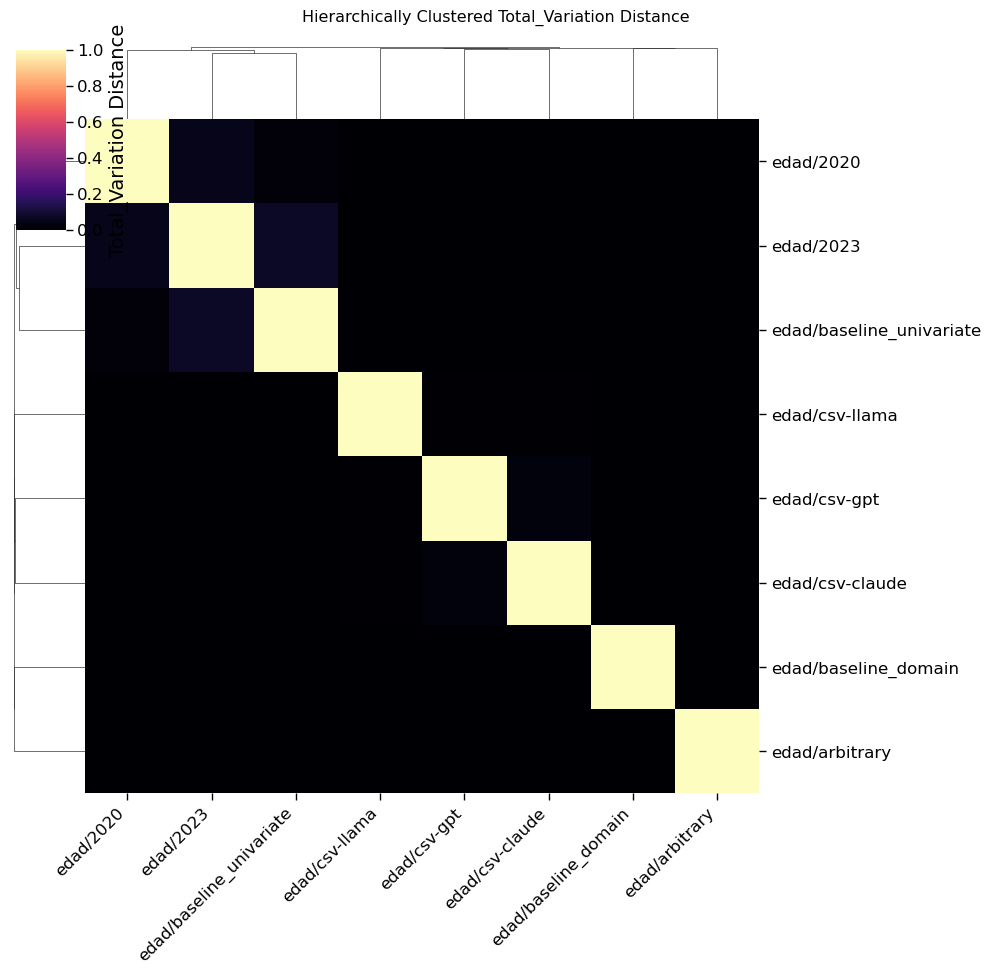


Processing measure: correspond_test

Processing measure: best_dev


/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:555: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:555: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:555: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:569: UserWarning:

Tight layout not applied. tight_layout cannot make Axes height small enough to accommodate all Axes decorations.



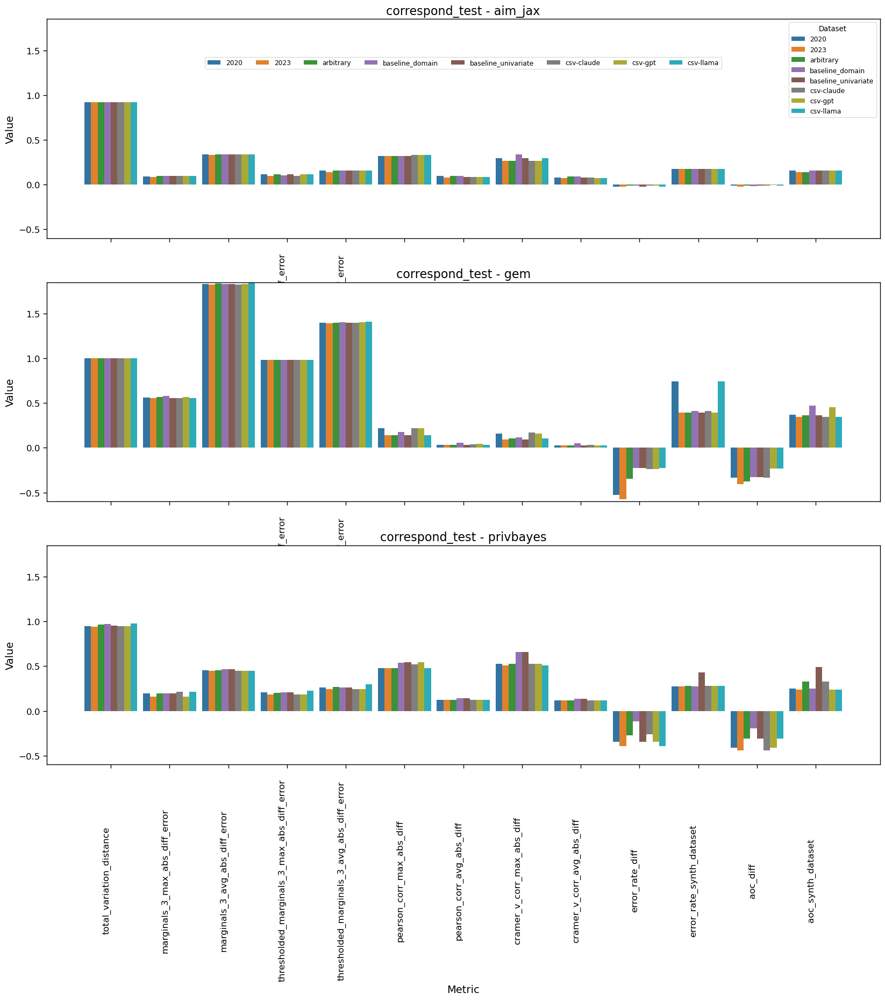

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:555: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:555: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:555: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:569: UserWarning:

Tight layout not applied. tight_layout cannot make Axes height small enough to accommodate all Axes decorations.



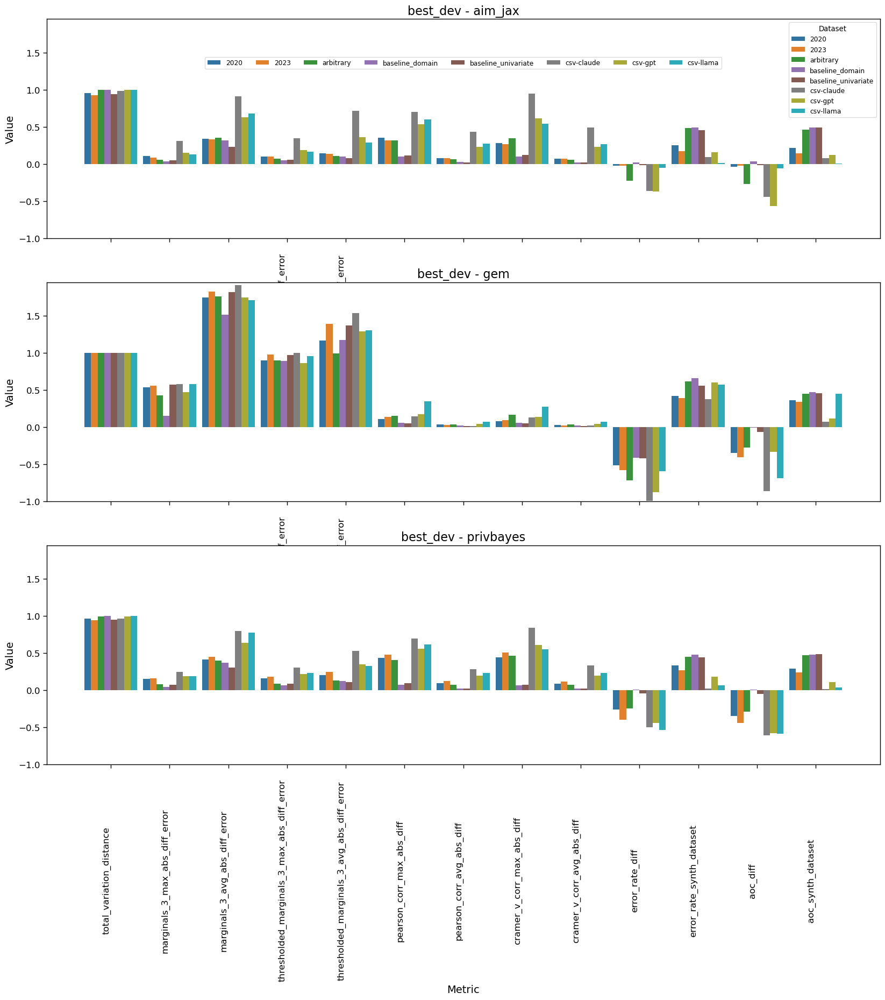

### total_variation_distance

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



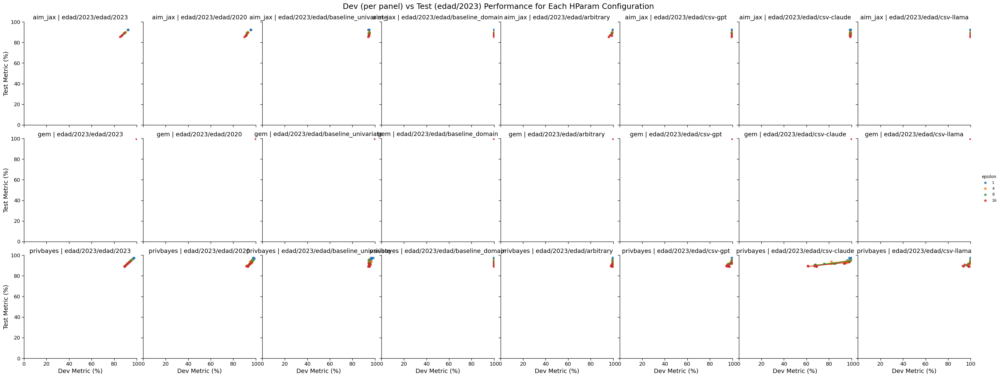

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



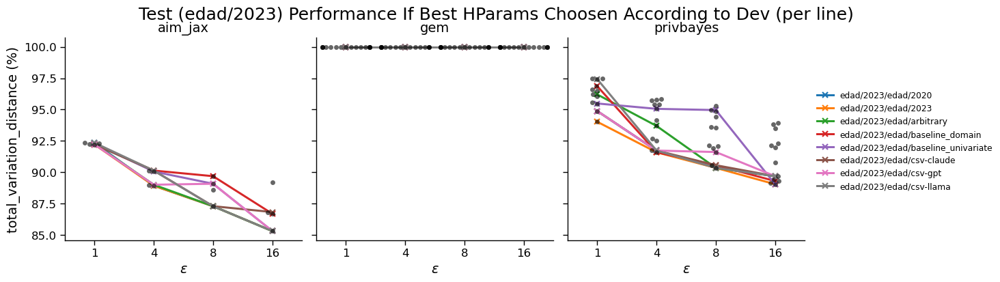

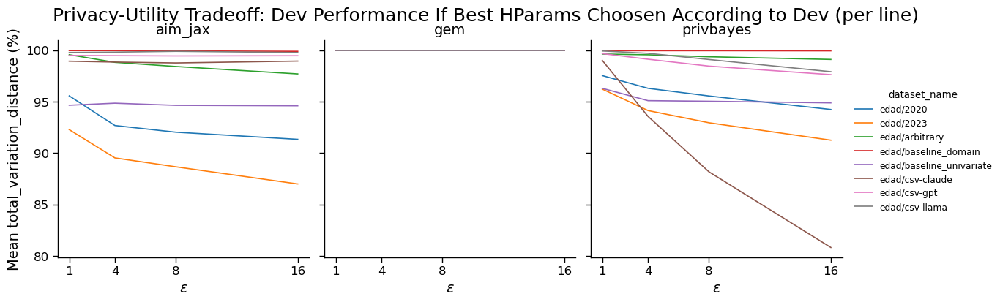

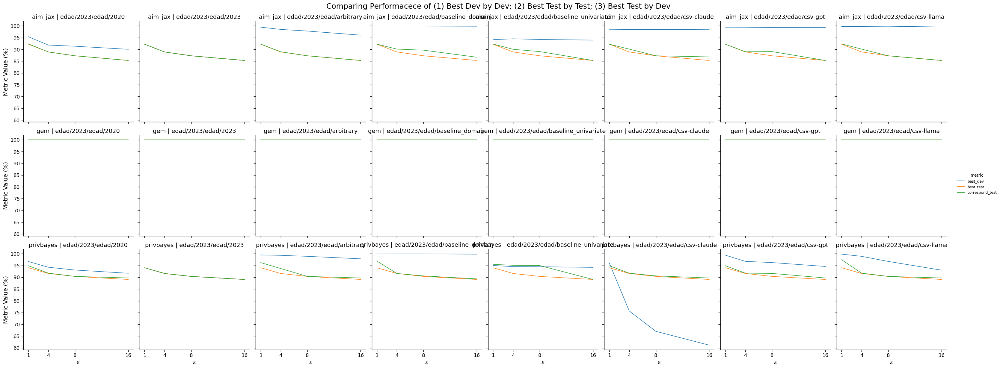

### marginals_3_max_abs_diff_error

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

18.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

6.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

6.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categori

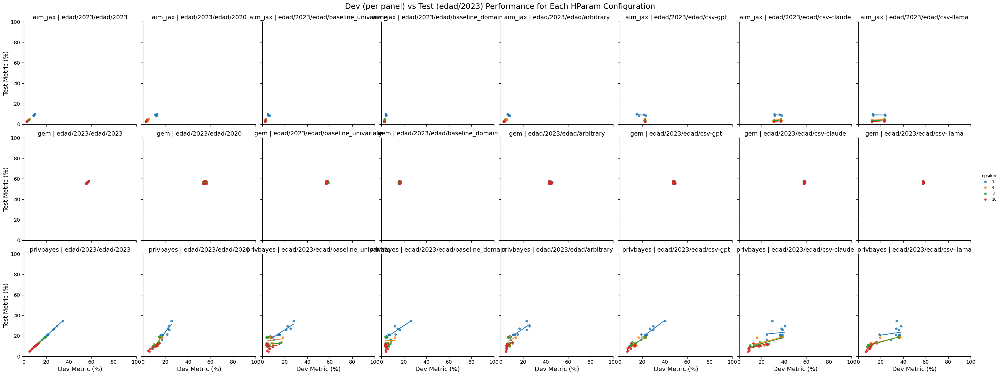

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

12.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



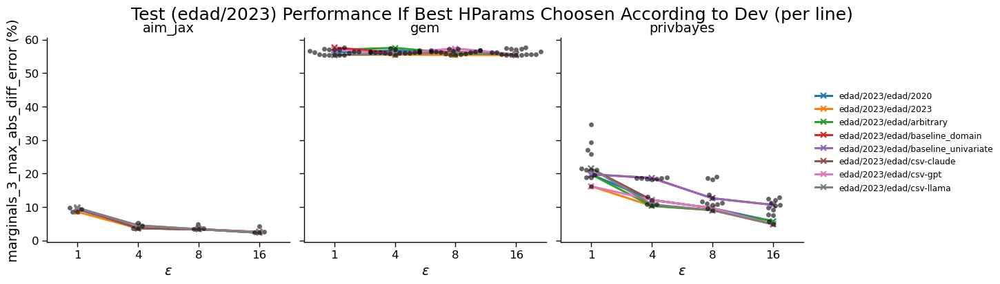

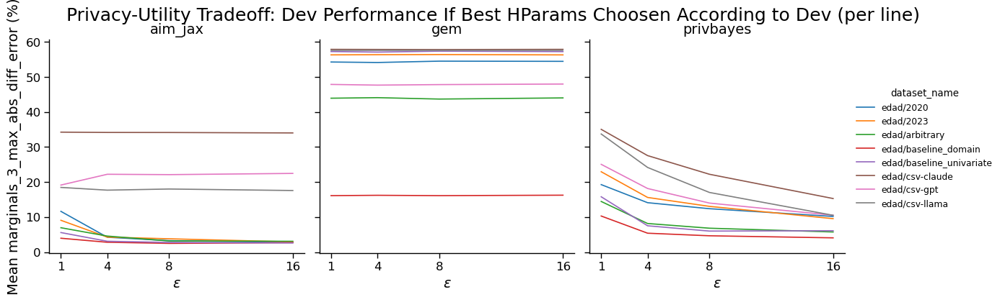

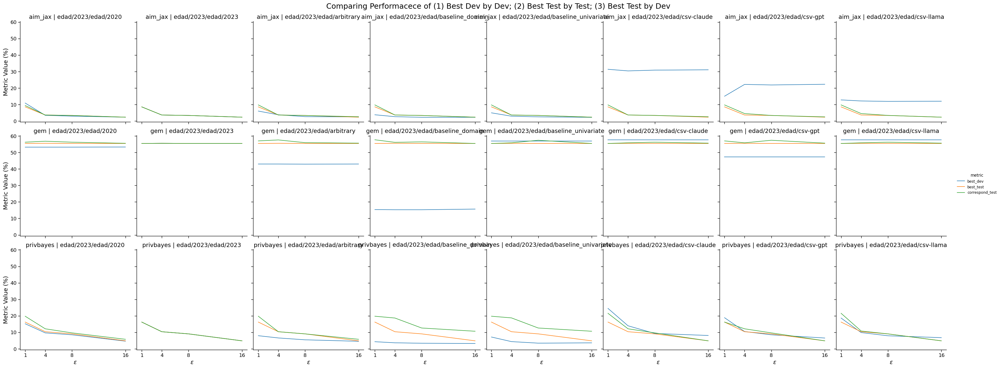

### marginals_3_avg_abs_diff_error

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



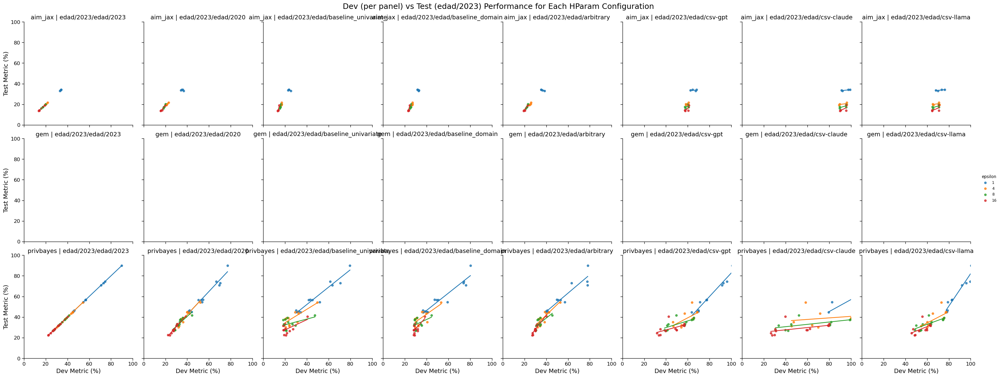

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



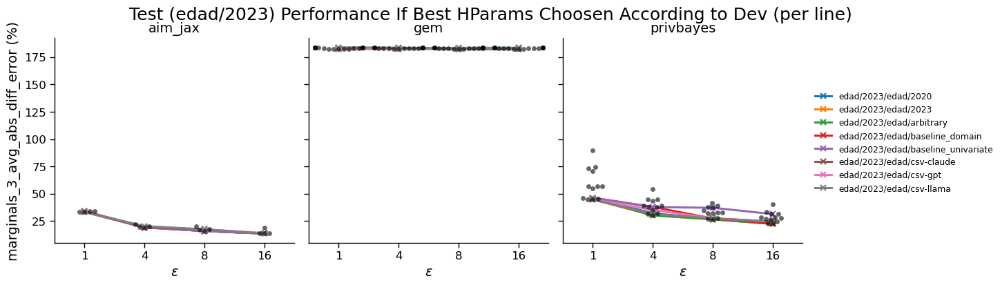

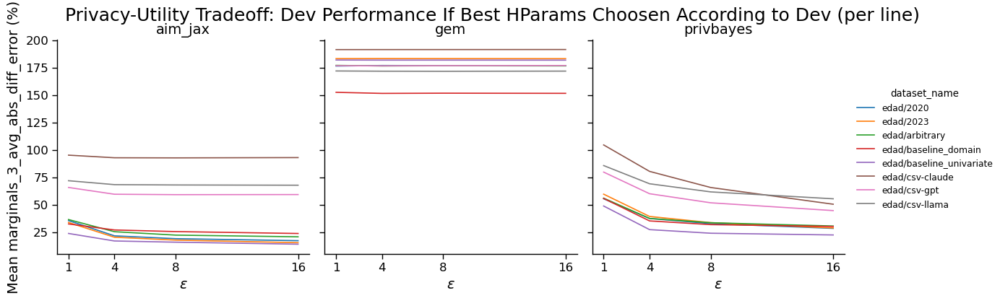

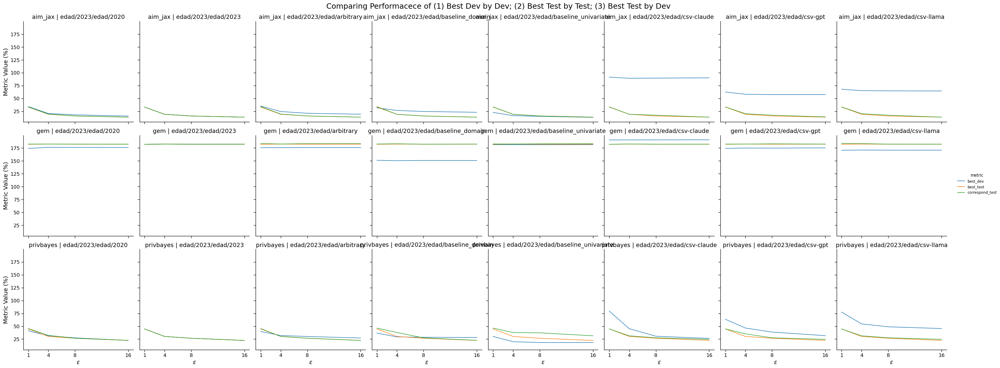

### thresholded_marginals_3_max_abs_diff_error

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



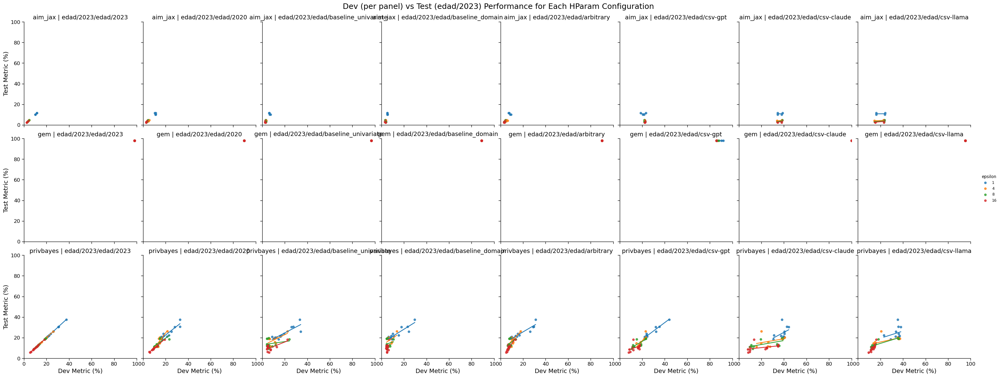

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



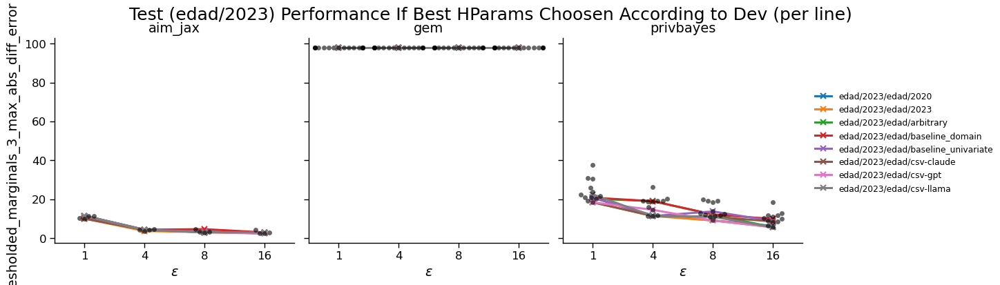

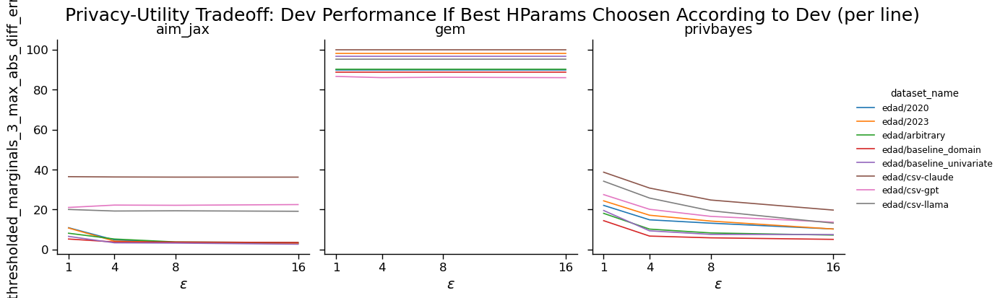

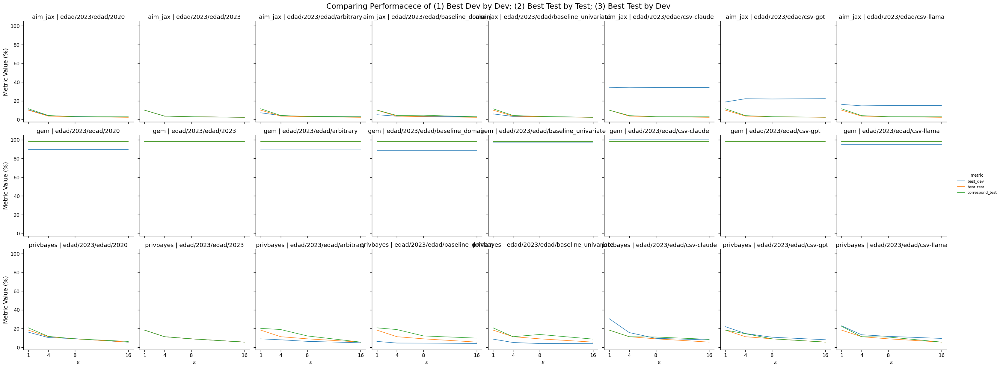

### thresholded_marginals_3_avg_abs_diff_error

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



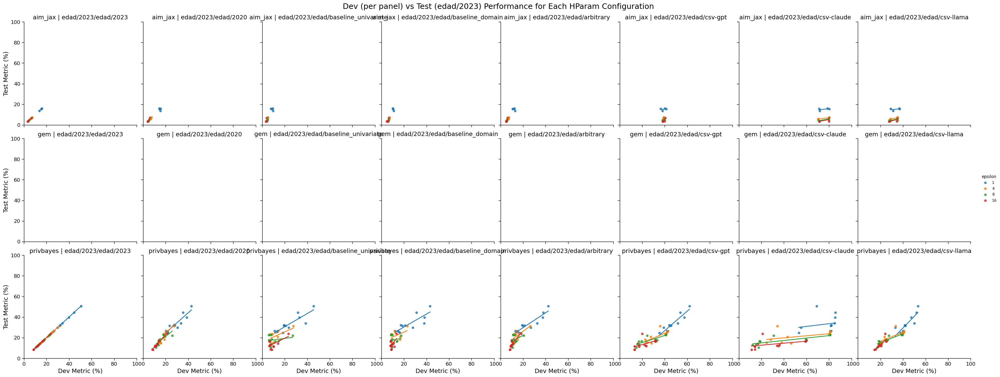

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



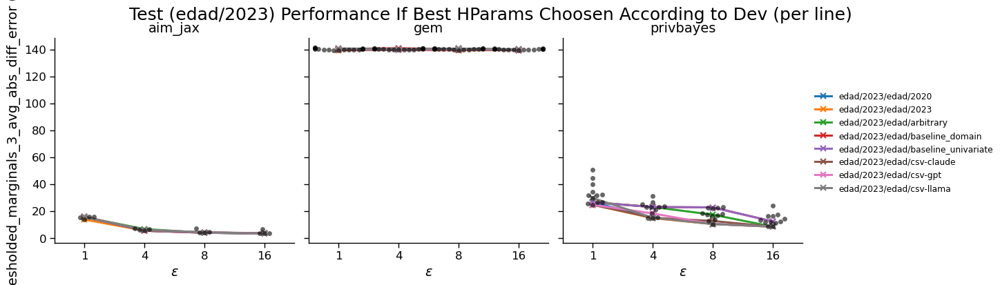

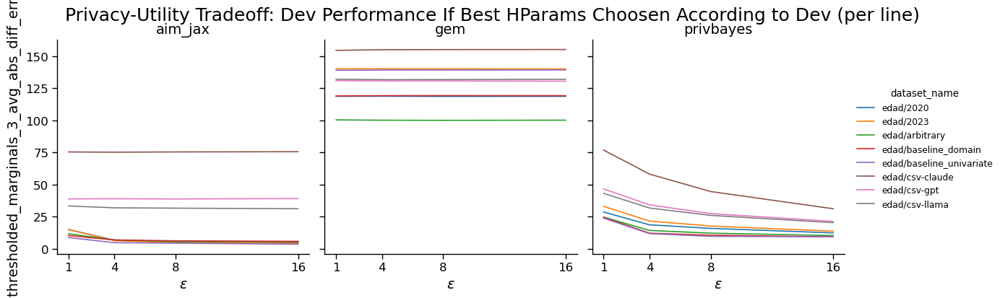

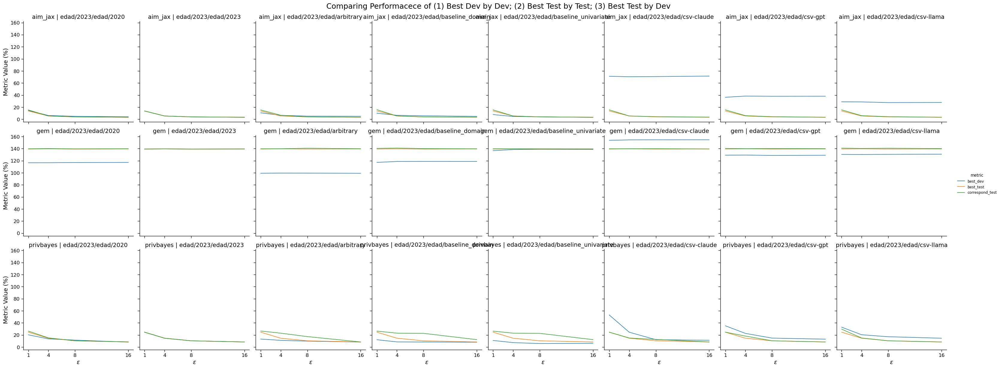

### pearson_corr_max_abs_diff

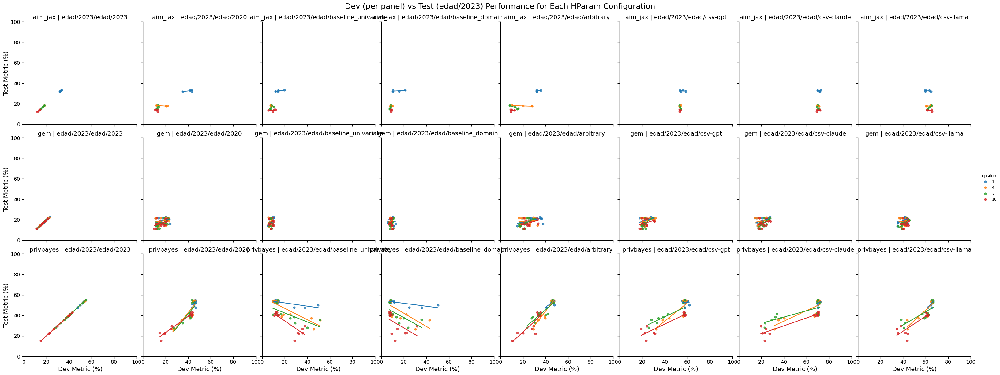

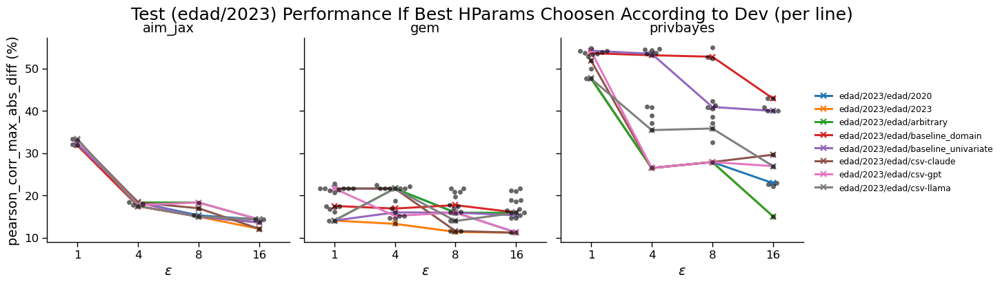

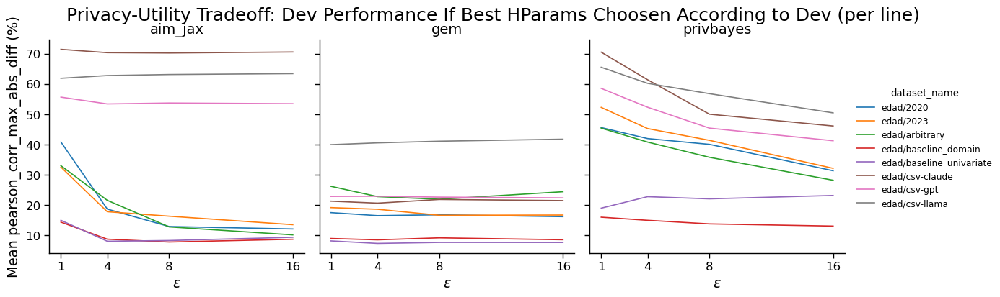

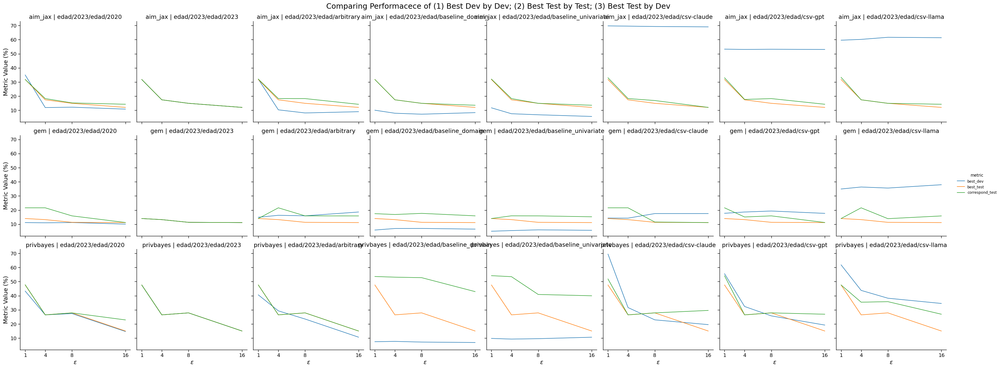

### pearson_corr_avg_abs_diff

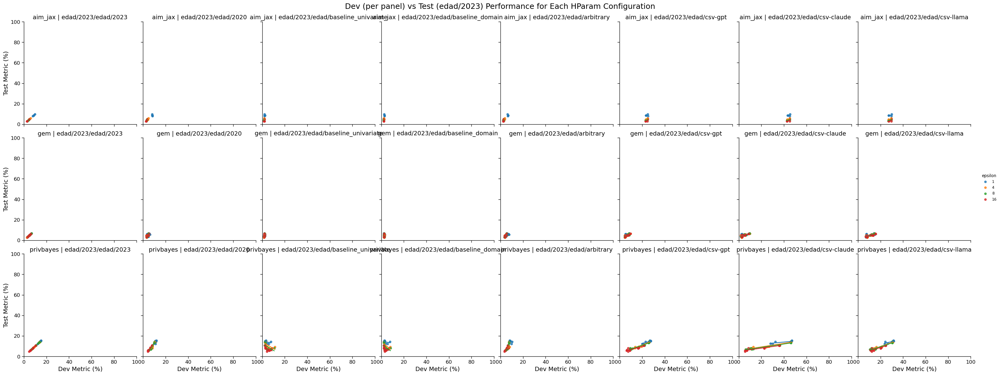

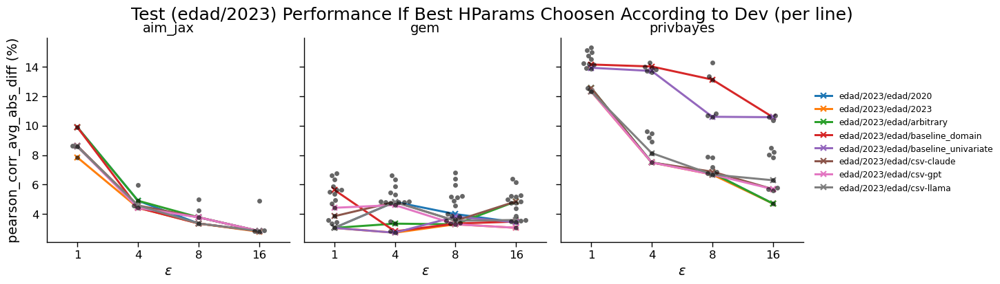

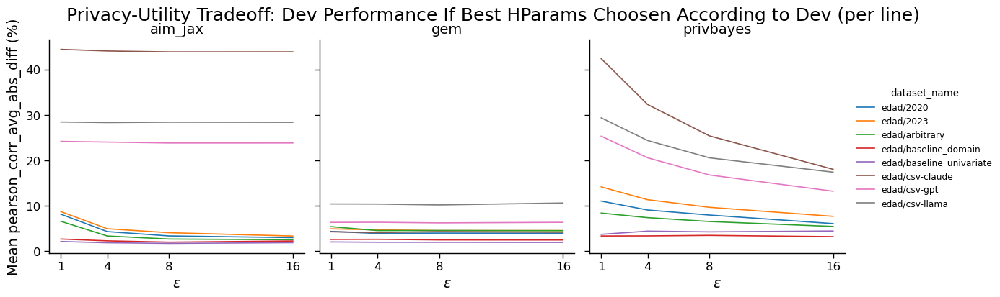

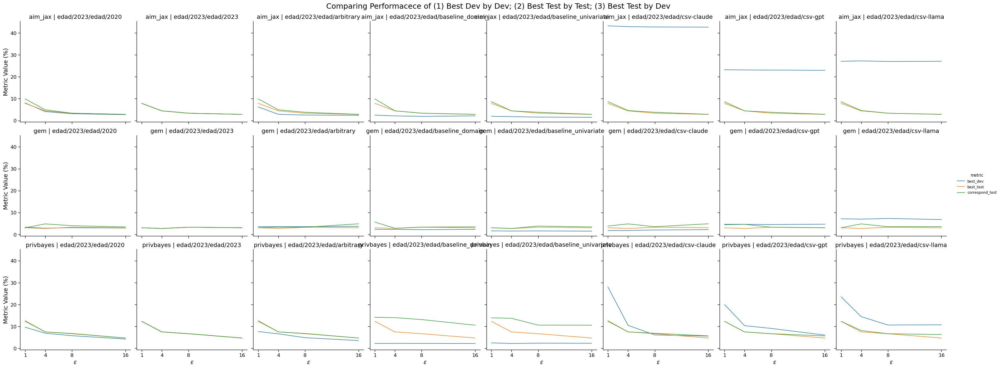

### cramer_v_corr_max_abs_diff

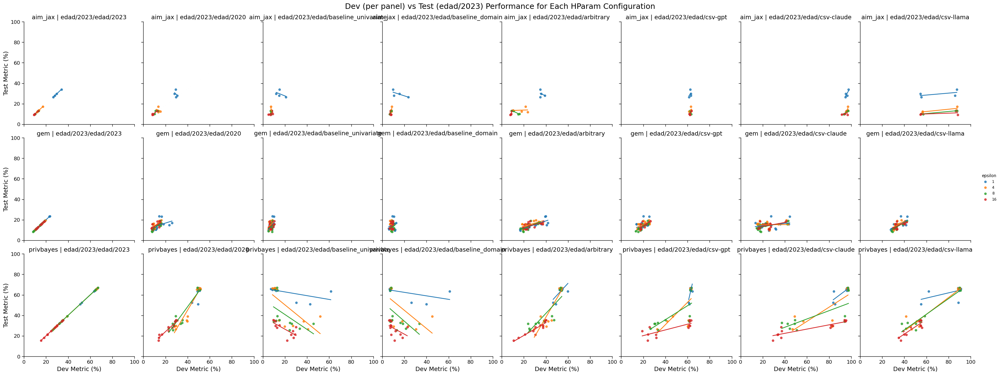

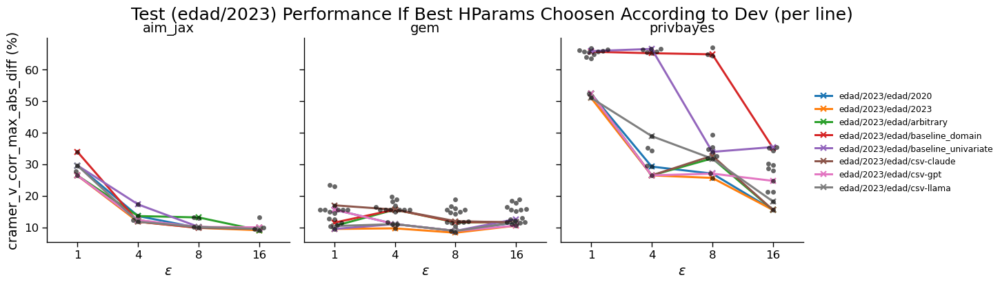

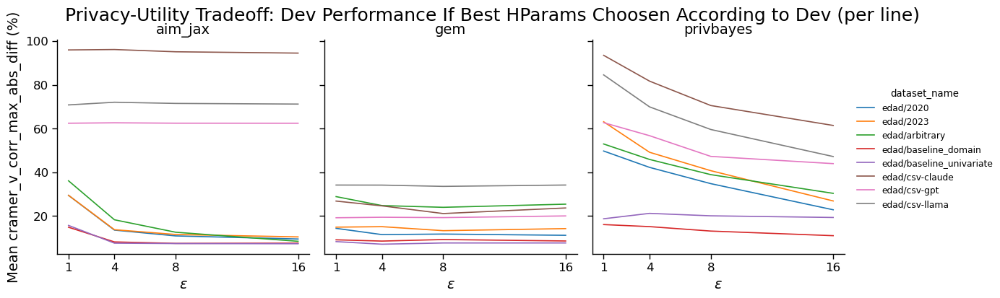

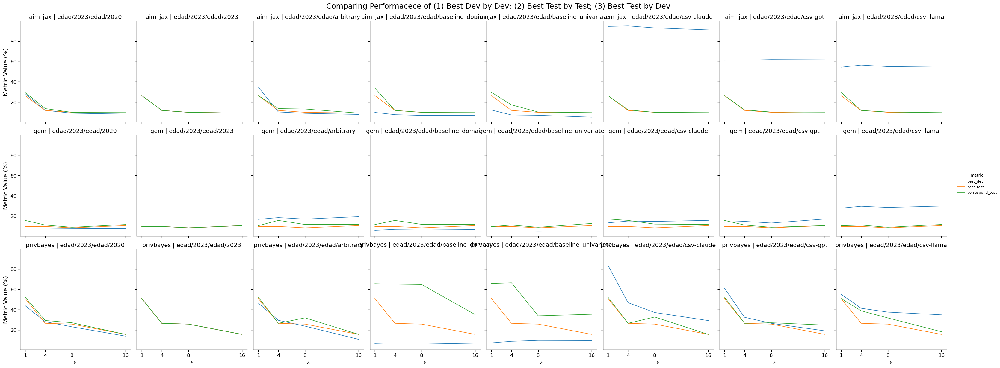

### cramer_v_corr_avg_abs_diff

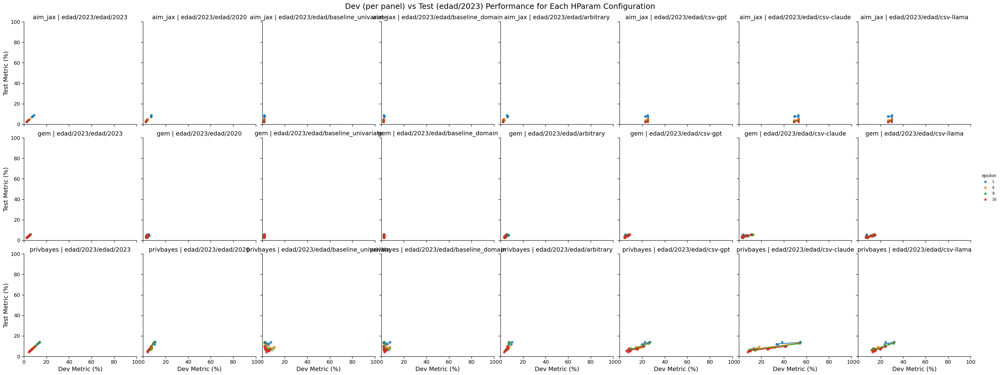

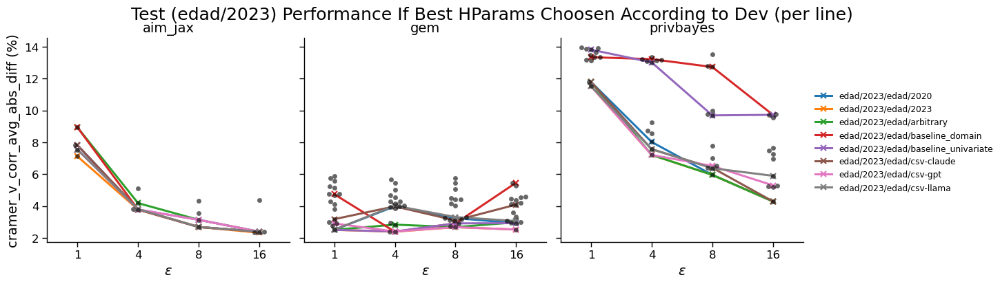

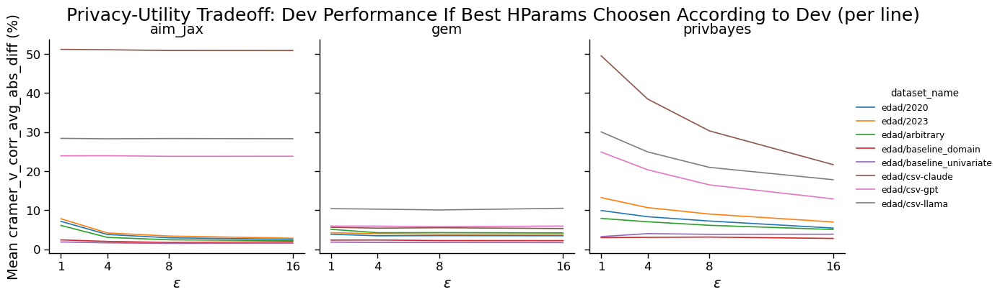

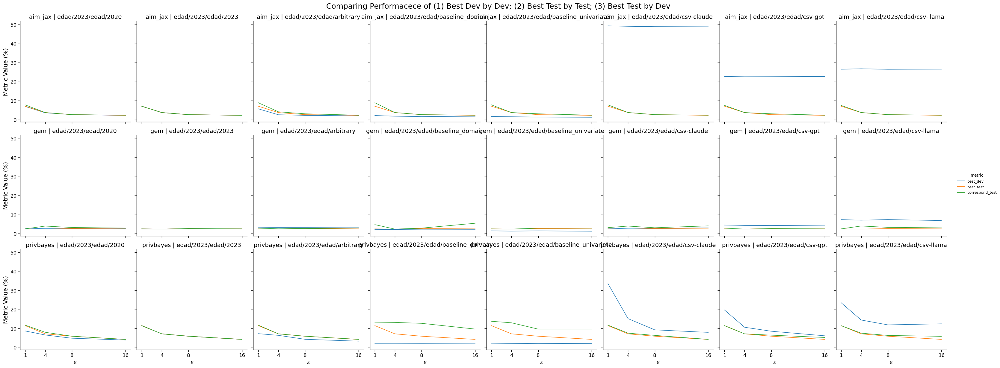

### error_rate_diff

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

6.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

6.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

18.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categori

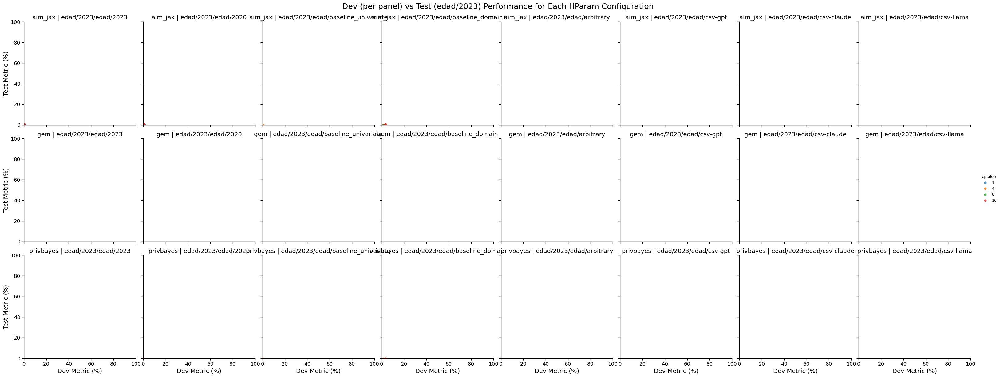

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

12.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

6.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

18.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



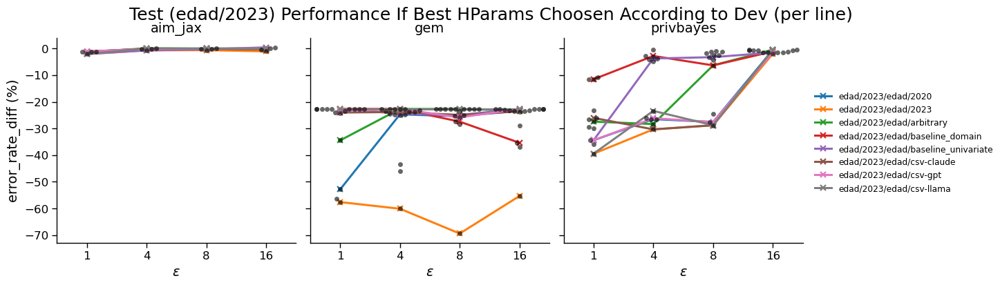

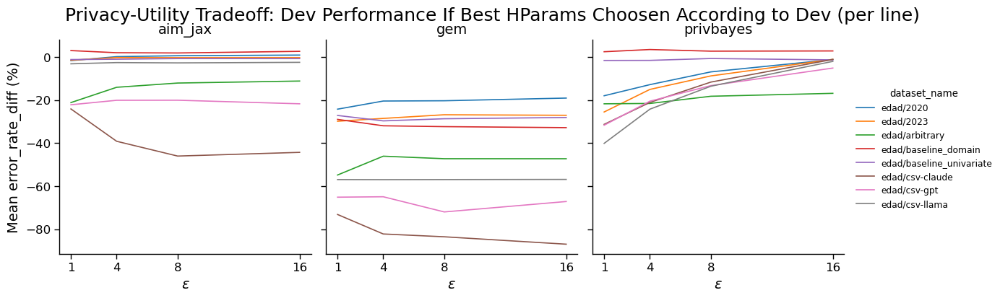

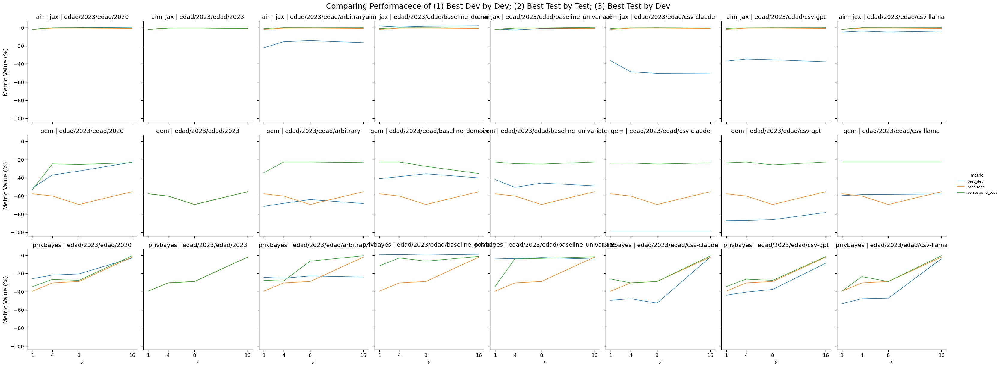

### error_rate_train_dataset

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



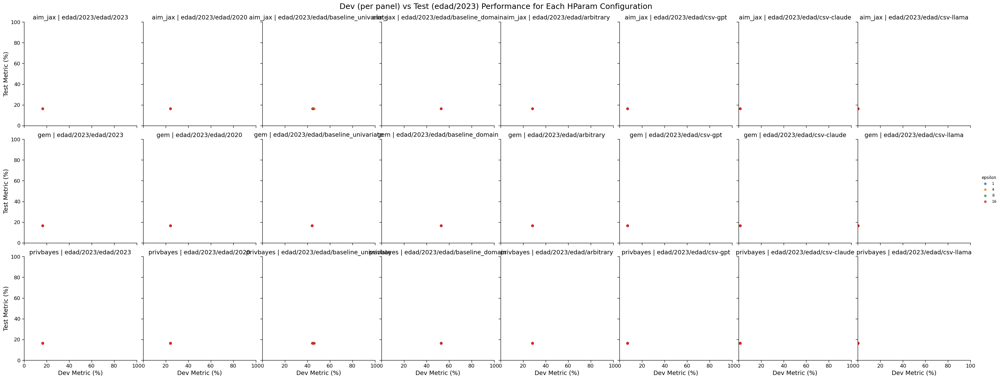

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



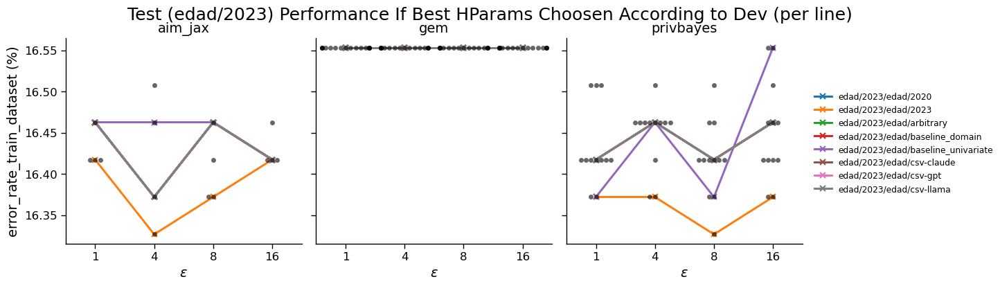

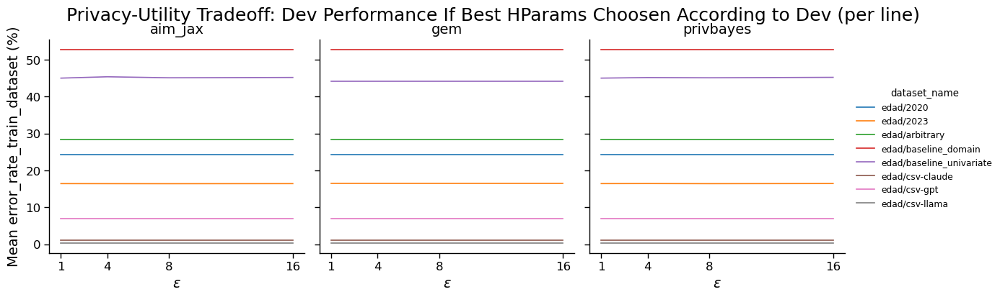

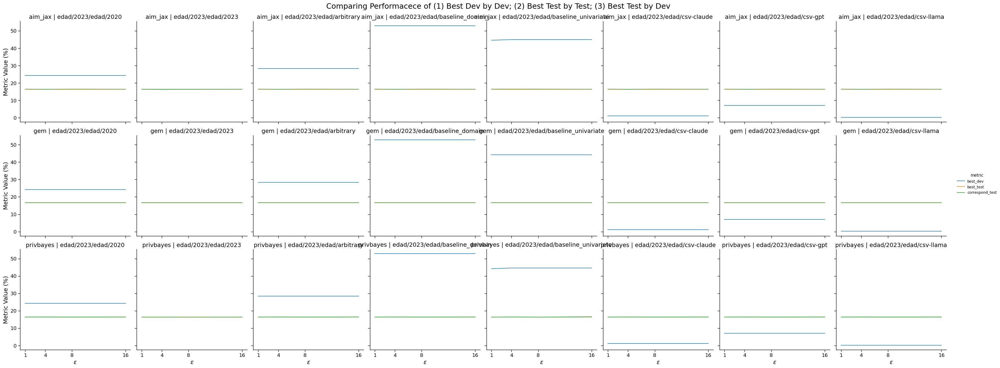

### error_rate_synth_dataset

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

6.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

6.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

18.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categori

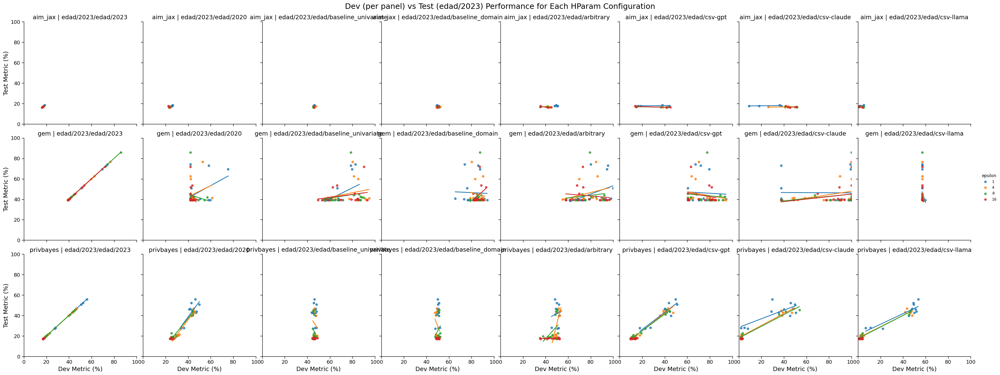

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

6.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

18.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



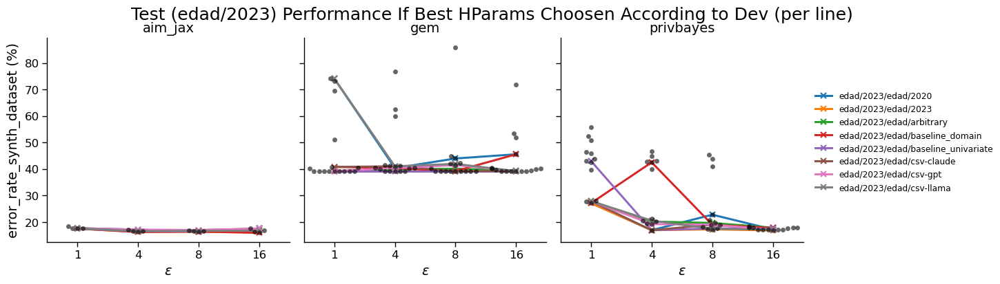

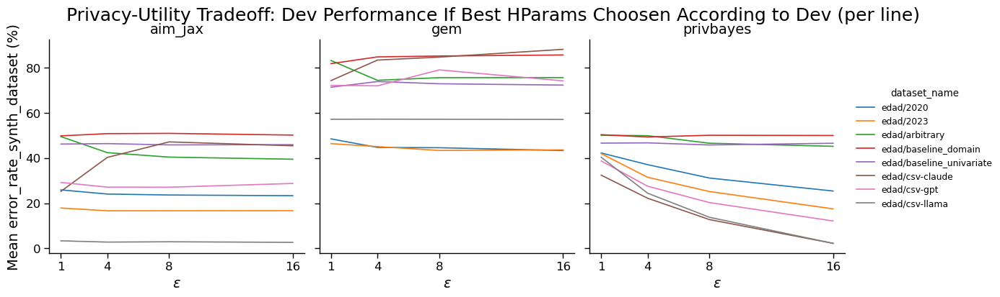

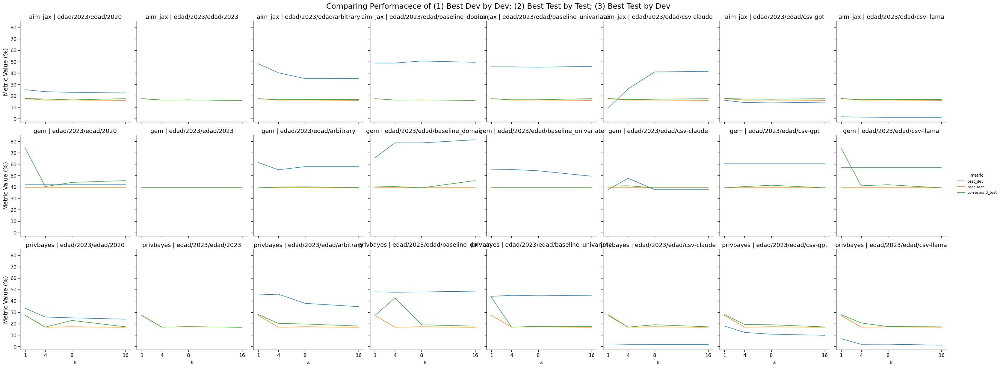

### aoc_diff

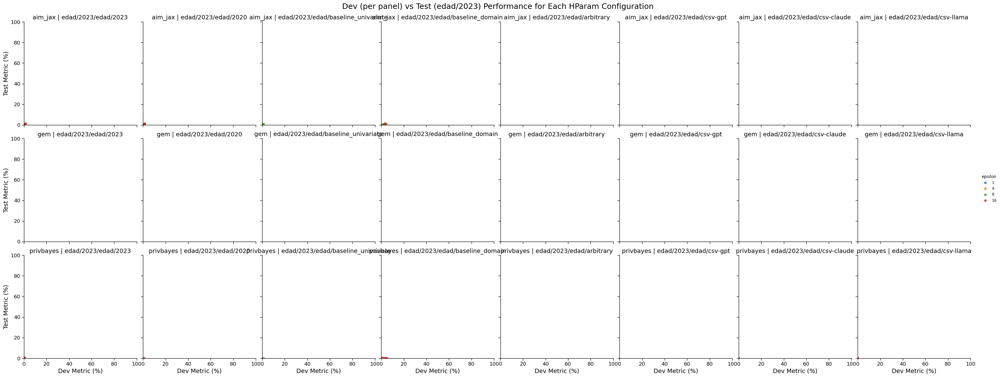

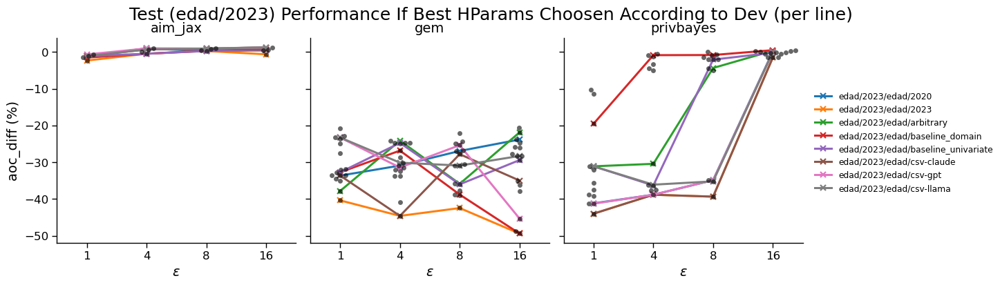

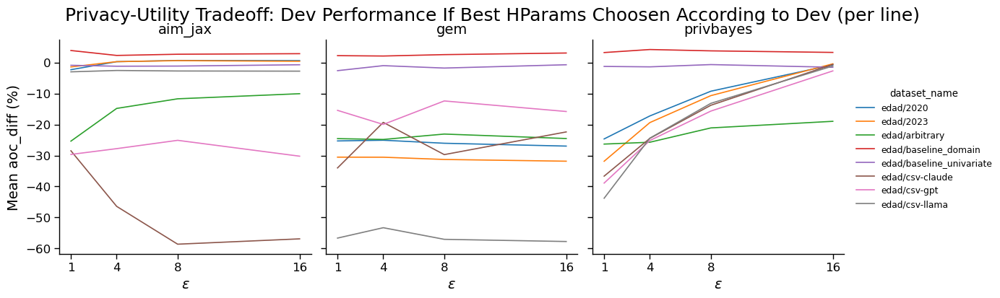

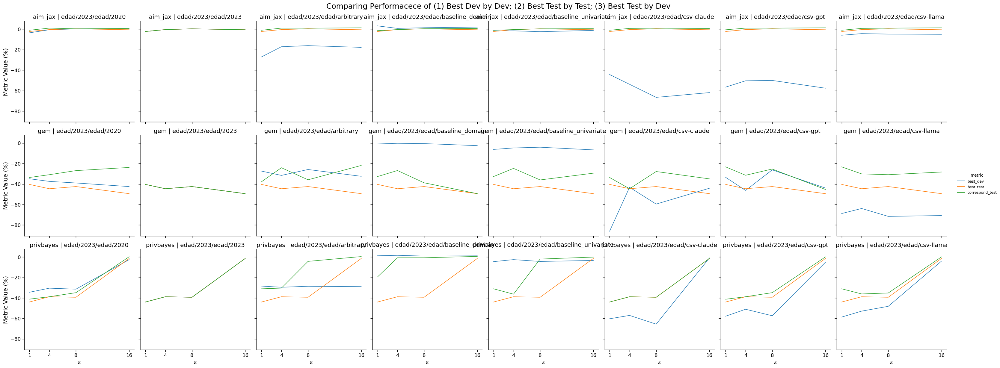

### aoc_train_dataset

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



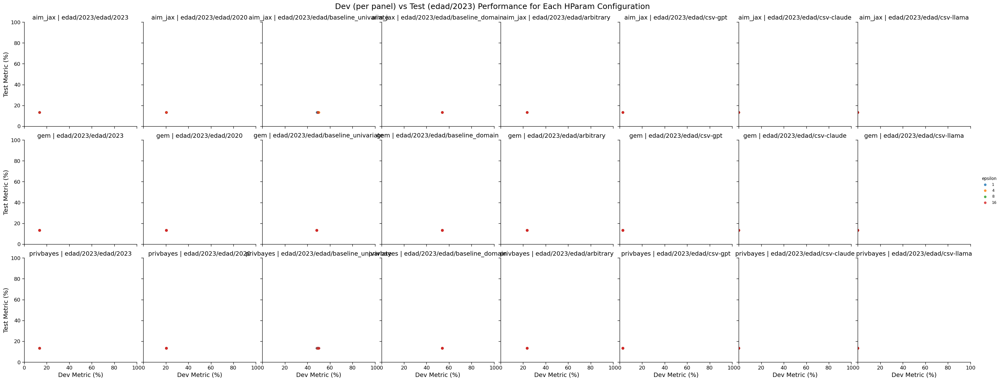

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



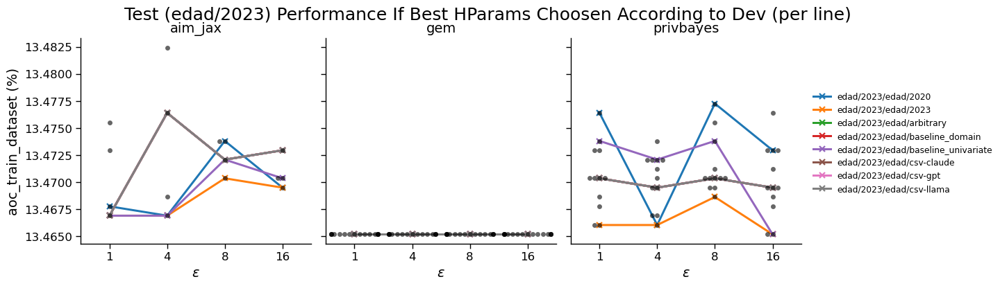

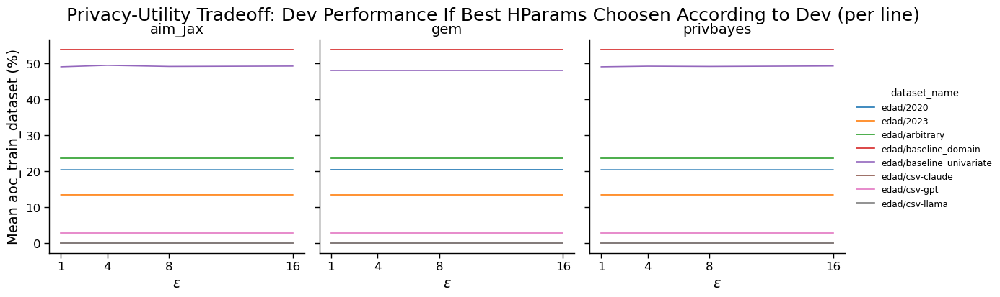

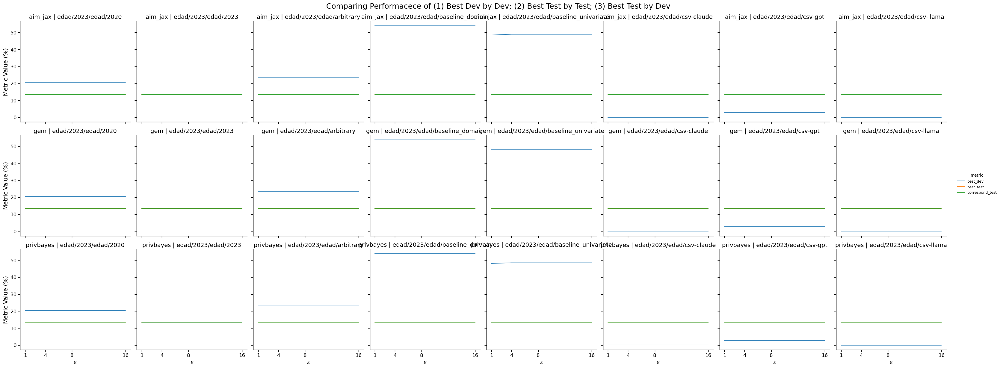

### aoc_synth_dataset

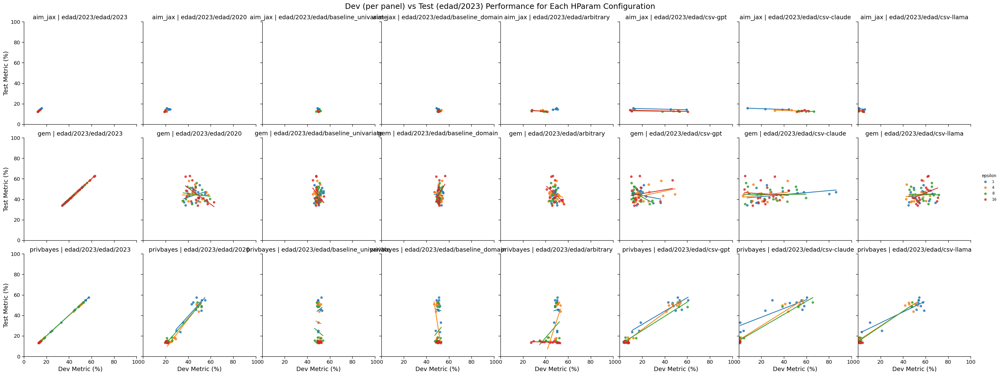

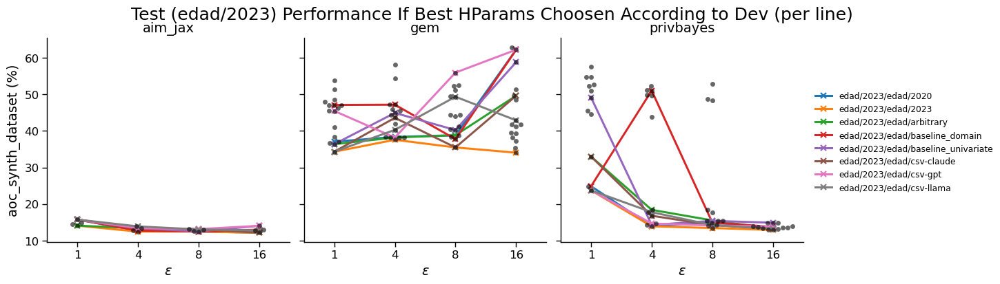

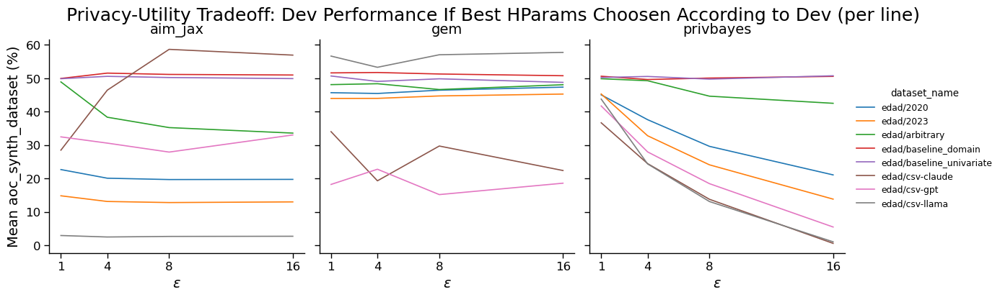

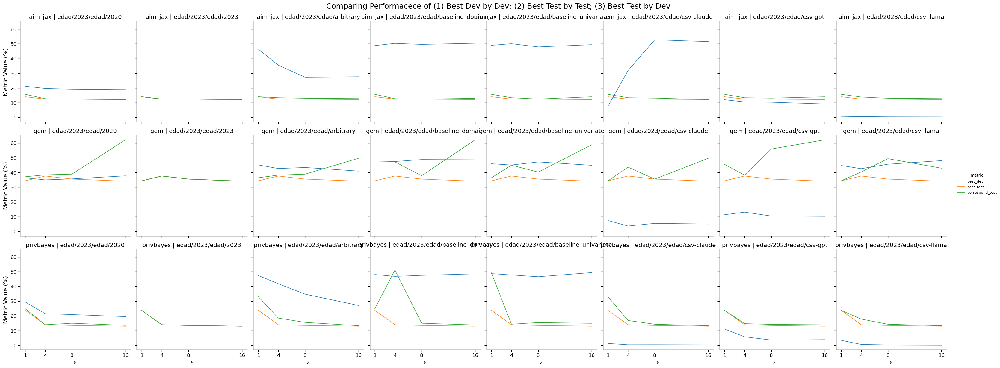

### total_variation_distance

quantile  best_dev  \
synth_name experiment                         epsilon                       
aim_jax    edad/2023/edad/2020                1            75.0      95.4   
                                              4             0.0      91.8   
                                              8             0.0      91.4   
                                              16            0.0      90.1   
           edad/2023/edad/2023                1             0.0      92.2   
                                              4             0.0      88.9   
                                              8             0.0      87.3   
                                              16            0.0      85.3   
           edad/2023/edad/arbitrary           1            25.0      99.5   
                                              4            25.0      98.5   
                                              8             0.0      97.8   
                                              16            0.0      96.1   
           edad/2023/edad/baseline_domain     1            25.0      99.9   
                                              4            75.0      99.9   
                                              8            75.0      99.9   
                                              16           25.0      99.8   
           edad/2023/edad/baseline_univariate 1            50.0      94.1   
                                              4            50.0      94.5   
                                              8            50.0      94.2   
                                              16            0.0      94.0   
           edad/2023/edad/csv-claude          1             0.0      98.4   
                                              4            75.0      98.4   
                                              8             0.0      98.4   
                                              16           50.0      98.5   
           edad/2023/edad/csv-gpt             1             0.0      99.4   
                                              4            25.0      99.4   
                                              8            50.0      99.3   
                                              16            0.0      99.3   
           edad/2023/edad/csv-llama           1            75.0      99.7   
                                              4            75.0      99.8   
                                              8             0.0      99.8   
                                              16            0.0      99.5   
gem        edad/2023/edad/2020                1             0.0     100.0   
                                              4             0.0     100.0   
                                              8             0.0     100.0   
                                              16            0.0     100.0   
           edad/2023/edad/2023                1             0.0     100.0   
                                              4             0.0     100.0   
                                              8             0.0     100.0   
                                              16            0.0     100.0   
           edad/2023/edad/arbitrary           1             0.0     100.0   
                                              4             0.0     100.0   
                                              8             0.0     100.0   
                                              16            0.0     100.0   
           edad/2023/edad/baseline_domain     1             0.0     100.0   
                                              4             0.0     100.0   
                                              8             0.0     100.0   
                                              16            0.0     100.0   
           edad/2023/edad/baseline_univariate 1             0.0     100.0   
                                              4             0.0     100.0   
                                              8    

### marginals_3_max_abs_diff_error

quantile  best_dev  \
synth_name experiment                         epsilon                       
aim_jax    edad/2023/edad/2020                1            50.0      10.9   
                                              4             0.0       3.5   
                                              8             0.0       3.0   
                                              16            0.0       2.3   
           edad/2023/edad/2023                1             0.0       8.6   
                                              4             0.0       3.6   
                                              8             0.0       3.4   
                                              16            0.0       2.3   
           edad/2023/edad/arbitrary           1            75.0       6.0   
                                              4             0.0       3.8   
                                              8             0.0       2.7   
                                              16           50.0       2.5   
           edad/2023/edad/baseline_domain     1            75.0       3.8   
                                              4            25.0       2.6   
                                              8             0.0       2.3   
                                              16            0.0       2.3   
           edad/2023/edad/baseline_univariate 1            75.0       5.0   
                                              4             0.0       2.9   
                                              8            25.0       2.5   
                                              16            0.0       2.2   
           edad/2023/edad/csv-claude          1            75.0      31.4   
                                              4            25.0      30.4   
                                              8            25.0      30.9   
                                              16           50.0      31.1   
           edad/2023/edad/csv-gpt             1            75.0      15.0   
                                              4            50.0      22.2   
                                              8             0.0      21.9   
                                              16           25.0      22.3   
           edad/2023/edad/csv-llama           1            75.0      12.8   
                                              4            50.0      12.2   
                                              8            25.0      11.9   
                                              16            0.0      12.0   
gem        edad/2023/edad/2020                1            43.8      53.2   
                                              4            81.2      53.2   
                                              8            31.2      53.2   
                                              16           18.8      53.3   
           edad/2023/edad/2023                1             0.0      55.4   
                                              4             0.0      55.5   
                                              8             0.0      55.4   
                                              16            0.0      55.4   
           edad/2023/edad/arbitrary           1            68.8      43.0   
                                              4            93.8      43.0   
                                              8            25.0      42.9   
                                              16           25.0      43.0   
           edad/2023/edad/baseline_domain     1            93.8      15.4   
                                              4            18.8      15.3   
                                              8            43.8      15.3   
                                              16            0.0      15.7   
           edad/2023/edad/baseline_univariate 1             0.0      57.0   
                                              4             6.2      57.0   
                                              8    

### marginals_3_avg_abs_diff_error

quantile  best_dev  \
synth_name experiment                         epsilon                       
aim_jax    edad/2023/edad/2020                1            25.0      34.1   
                                              4            25.0      20.7   
                                              8             0.0      18.1   
                                              16            0.0      15.7   
           edad/2023/edad/2023                1             0.0      33.1   
                                              4             0.0      19.2   
                                              8             0.0      15.9   
                                              16            0.0      13.6   
           edad/2023/edad/arbitrary           1            75.0      35.2   
                                              4            25.0      24.5   
                                              8             0.0      21.2   
                                              16            0.0      19.4   
           edad/2023/edad/baseline_domain     1            50.0      31.7   
                                              4             0.0      26.6   
                                              8             0.0      24.7   
                                              16            0.0      23.1   
           edad/2023/edad/baseline_univariate 1            25.0      22.8   
                                              4             0.0      16.6   
                                              8             0.0      15.2   
                                              16            0.0      13.3   
           edad/2023/edad/csv-claude          1            25.0      91.4   
                                              4             0.0      89.2   
                                              8            50.0      89.6   
                                              16            0.0      90.0   
           edad/2023/edad/csv-gpt             1            25.0      62.5   
                                              4            50.0      58.1   
                                              8            50.0      57.4   
                                              16           50.0      57.5   
           edad/2023/edad/csv-llama           1            25.0      67.9   
                                              4            50.0      65.2   
                                              8            50.0      64.7   
                                              16            0.0      64.5   
gem        edad/2023/edad/2020                1            25.0     174.3   
                                              4             6.2     176.4   
                                              8             6.2     176.2   
                                              16            0.0     176.1   
           edad/2023/edad/2023                1             0.0     182.3   
                                              4             0.0     182.7   
                                              8             0.0     182.5   
                                              16            0.0     182.5   
           edad/2023/edad/arbitrary           1            75.0     175.6   
                                              4            25.0     175.7   
                                              8            62.5     176.0   
                                              16           81.2     175.9   
           edad/2023/edad/baseline_domain     1            31.2     151.2   
                                              4            43.8     150.4   
                                              8             0.0     150.9   
                                              16           12.5     150.8   
           edad/2023/edad/baseline_univariate 1            37.5     181.5   
                                              4            12.5     181.5   
                                              8    

### thresholded_marginals_3_max_abs_diff_error

quantile  best_dev  \
synth_name experiment                         epsilon                       
aim_jax    edad/2023/edad/2020                1            75.0      10.4   
                                              4            50.0       4.0   
                                              8             0.0       3.2   
                                              16           50.0       2.6   
           edad/2023/edad/2023                1             0.0      10.0   
                                              4             0.0       3.6   
                                              8             0.0       3.0   
                                              16            0.0       2.3   
           edad/2023/edad/arbitrary           1            75.0       7.2   
                                              4            50.0       4.2   
                                              8            50.0       3.2   
                                              16           50.0       3.0   
           edad/2023/edad/baseline_domain     1            25.0       5.1   
                                              4            50.0       3.5   
                                              8            75.0       3.4   
                                              16           50.0       3.0   
           edad/2023/edad/baseline_univariate 1            50.0       6.0   
                                              4            50.0       3.3   
                                              8            50.0       3.1   
                                              16            0.0       2.4   
           edad/2023/edad/csv-claude          1             0.0      34.4   
                                              4            25.0      33.9   
                                              8             0.0      34.2   
                                              16           50.0      34.2   
           edad/2023/edad/csv-gpt             1            50.0      18.7   
                                              4            25.0      22.2   
                                              8             0.0      21.9   
                                              16           25.0      22.3   
           edad/2023/edad/csv-llama           1            50.0      16.2   
                                              4            25.0      14.6   
                                              8             0.0      15.0   
                                              16           50.0      15.0   
gem        edad/2023/edad/2020                1             0.0      89.8   
                                              4             0.0      89.8   
                                              8             0.0      89.8   
                                              16            0.0      89.8   
           edad/2023/edad/2023                1             0.0      98.1   
                                              4             0.0      98.1   
                                              8             0.0      98.1   
                                              16            0.0      98.1   
           edad/2023/edad/arbitrary           1             0.0      90.1   
                                              4             0.0      90.1   
                                              8             0.0      90.1   
                                              16            0.0      90.1   
           edad/2023/edad/baseline_domain     1             0.0      88.8   
                                              4             0.0      88.8   
                                              8             0.0      88.8   
                                              16            0.0      88.8   
           edad/2023/edad/baseline_univariate 1             0.0      96.8   
                                              4             0.0      96.8   
                                              8    

### thresholded_marginals_3_avg_abs_diff_error

quantile  best_dev  \
synth_name experiment                         epsilon                       
aim_jax    edad/2023/edad/2020                1            25.0      14.4   
                                              4             0.0       6.3   
                                              8             0.0       4.9   
                                              16            0.0       4.1   
           edad/2023/edad/2023                1             0.0      13.7   
                                              4             0.0       5.5   
                                              8             0.0       3.9   
                                              16            0.0       3.3   
           edad/2023/edad/arbitrary           1            25.0      10.7   
                                              4            50.0       6.5   
                                              8             0.0       5.2   
                                              16            0.0       4.9   
           edad/2023/edad/baseline_domain     1            75.0      10.0   
                                              4             0.0       6.6   
                                              8             0.0       5.8   
                                              16           25.0       4.8   
           edad/2023/edad/baseline_univariate 1            50.0       7.8   
                                              4             0.0       4.6   
                                              8             0.0       4.1   
                                              16            0.0       3.2   
           edad/2023/edad/csv-claude          1            50.0      71.2   
                                              4             0.0      70.4   
                                              8            25.0      70.7   
                                              16           25.0      71.5   
           edad/2023/edad/csv-gpt             1            50.0      36.4   
                                              4            25.0      38.5   
                                              8            25.0      38.1   
                                              16            0.0      38.2   
           edad/2023/edad/csv-llama           1            50.0      28.9   
                                              4            25.0      28.7   
                                              8            25.0      27.6   
                                              16            0.0      27.8   
gem        edad/2023/edad/2020                1            25.0     116.6   
                                              4            43.8     116.6   
                                              8             6.2     116.9   
                                              16           25.0     117.1   
           edad/2023/edad/2023                1             0.0     139.3   
                                              4             0.0     139.5   
                                              8             0.0     139.3   
                                              16            0.0     139.4   
           edad/2023/edad/arbitrary           1            25.0      99.2   
                                              4            18.8      99.5   
                                              8            87.5      99.4   
                                              16           25.0      99.2   
           edad/2023/edad/baseline_domain     1            62.5     117.2   
                                              4            93.8     118.7   
                                              8            25.0     118.8   
                                              16           18.8     118.8   
           edad/2023/edad/baseline_univariate 1            31.2     136.6   
                                              4             6.2     138.4   
                                              8    

### pearson_corr_max_abs_diff

quantile  best_dev  \
synth_name experiment                         epsilon                       
aim_jax    edad/2023/edad/2020                1             0.0      35.0   
                                              4            75.0      12.0   
                                              8            25.0      12.2   
                                              16           75.0      10.9   
           edad/2023/edad/2023                1             0.0      31.8   
                                              4             0.0      17.4   
                                              8             0.0      15.0   
                                              16            0.0      12.1   
           edad/2023/edad/arbitrary           1            25.0      32.0   
                                              4            75.0      10.3   
                                              8            75.0       8.1   
                                              16           50.0       9.0   
           edad/2023/edad/baseline_domain     1             0.0      10.1   
                                              4             0.0       7.9   
                                              8             0.0       7.3   
                                              16           25.0       8.4   
           edad/2023/edad/baseline_univariate 1            25.0      11.8   
                                              4            75.0       7.6   
                                              8             0.0       6.9   
                                              16           25.0       5.7   
           edad/2023/edad/csv-claude          1            50.0      69.8   
                                              4            75.0      69.6   
                                              8            50.0      69.3   
                                              16            0.0      69.1   
           edad/2023/edad/csv-gpt             1            50.0      53.3   
                                              4            25.0      53.1   
                                              8            75.0      53.2   
                                              16           75.0      53.1   
           edad/2023/edad/csv-llama           1            75.0      59.6   
                                              4             0.0      60.2   
                                              8             0.0      61.7   
                                              16           75.0      61.4   
gem        edad/2023/edad/2020                1            62.5      11.2   
                                              4            50.0      11.0   
                                              8            37.5      11.2   
                                              16            6.2      10.1   
           edad/2023/edad/2023                1             0.0      14.0   
                                              4             0.0      13.3   
                                              8             0.0      11.3   
                                              16            0.0      11.2   
           edad/2023/edad/arbitrary           1             0.0      14.9   
                                              4            50.0      16.3   
                                              8            37.5      16.0   
                                              16           31.2      18.6   
           edad/2023/edad/baseline_domain     1            31.2       5.9   
                                              4            37.5       7.0   
                                              8            62.5       7.0   
                                              16           37.5       6.5   
           edad/2023/edad/baseline_univariate 1             0.0       5.0   
                                              4            31.2       5.5   
                                              8    

### pearson_corr_avg_abs_diff

quantile  best_dev  \
synth_name experiment                         epsilon                       
aim_jax    edad/2023/edad/2020                1            75.0       8.0   
                                              4            50.0       4.1   
                                              8             0.0       3.1   
                                              16           25.0       2.7   
           edad/2023/edad/2023                1             0.0       7.8   
                                              4             0.0       4.4   
                                              8             0.0       3.4   
                                              16            0.0       2.8   
           edad/2023/edad/arbitrary           1            75.0       6.2   
                                              4            50.0       2.8   
                                              8            25.0       2.5   
                                              16           25.0       2.4   
           edad/2023/edad/baseline_domain     1            75.0       2.5   
                                              4             0.0       2.1   
                                              8             0.0       1.9   
                                              16           25.0       2.1   
           edad/2023/edad/baseline_univariate 1            50.0       1.9   
                                              4             0.0       1.8   
                                              8            25.0       1.6   
                                              16           25.0       1.5   
           edad/2023/edad/csv-claude          1            50.0      43.2   
                                              4            25.0      42.9   
                                              8            25.0      42.7   
                                              16           25.0      42.7   
           edad/2023/edad/csv-gpt             1            25.0      23.2   
                                              4             0.0      23.1   
                                              8            25.0      23.0   
                                              16           25.0      22.9   
           edad/2023/edad/csv-llama           1            25.0      27.0   
                                              4            25.0      27.2   
                                              8             0.0      27.0   
                                              16           25.0      27.1   
gem        edad/2023/edad/2020                1             0.0       3.3   
                                              4            50.0       2.9   
                                              8            43.8       3.1   
                                              16            6.2       2.9   
           edad/2023/edad/2023                1             0.0       3.1   
                                              4             0.0       2.7   
                                              8             0.0       3.3   
                                              16            0.0       3.1   
           edad/2023/edad/arbitrary           1             0.0       3.6   
                                              4            12.5       3.5   
                                              8             0.0       3.6   
                                              16           56.2       3.7   
           edad/2023/edad/baseline_domain     1            62.5       2.3   
                                              4             6.2       2.3   
                                              8             6.2       2.2   
                                              16           12.5       2.3   
           edad/2023/edad/baseline_univariate 1             0.0       1.6   
                                              4             0.0       1.5   
                                              8    

### cramer_v_corr_max_abs_diff

quantile  best_dev  \
synth_name experiment                         epsilon                       
aim_jax    edad/2023/edad/2020                1            50.0      28.3   
                                              4            50.0      11.9   
                                              8             0.0       9.0   
                                              16           50.0       8.1   
           edad/2023/edad/2023                1             0.0      26.4   
                                              4             0.0      11.8   
                                              8             0.0       9.9   
                                              16            0.0       9.1   
           edad/2023/edad/arbitrary           1             0.0      34.8   
                                              4            50.0      10.3   
                                              8            75.0       8.9   
                                              16            0.0       7.8   
           edad/2023/edad/baseline_domain     1            75.0       9.8   
                                              4             0.0       7.6   
                                              8             0.0       6.8   
                                              16           50.0       7.0   
           edad/2023/edad/baseline_univariate 1            50.0      12.2   
                                              4            75.0       7.3   
                                              8            25.0       7.0   
                                              16           25.0       5.1   
           edad/2023/edad/csv-claude          1             0.0      94.7   
                                              4            25.0      95.2   
                                              8             0.0      93.3   
                                              16           25.0      91.3   
           edad/2023/edad/csv-gpt             1             0.0      61.3   
                                              4            25.0      61.4   
                                              8            25.0      61.9   
                                              16           50.0      61.7   
           edad/2023/edad/csv-llama           1            50.0      54.4   
                                              4             0.0      56.5   
                                              8            25.0      55.1   
                                              16           25.0      54.5   
gem        edad/2023/edad/2020                1            50.0       8.3   
                                              4            12.5       8.0   
                                              8             6.2       7.7   
                                              16           12.5       7.5   
           edad/2023/edad/2023                1             0.0       9.5   
                                              4             0.0       9.7   
                                              8             0.0       8.3   
                                              16            0.0      10.6   
           edad/2023/edad/arbitrary           1             6.2      16.7   
                                              4            31.2      18.4   
                                              8            31.2      16.9   
                                              16           18.8      19.3   
           edad/2023/edad/baseline_domain     1            18.8       5.9   
                                              4            31.2       6.9   
                                              8            37.5       7.2   
                                              16           18.8       6.7   
           edad/2023/edad/baseline_univariate 1             0.0       5.1   
                                              4             6.2       5.2   
                                              8    

### cramer_v_corr_avg_abs_diff

quantile  best_dev  \
synth_name experiment                         epsilon                       
aim_jax    edad/2023/edad/2020                1            50.0       7.0   
                                              4             0.0       3.7   
                                              8             0.0       2.7   
                                              16           50.0       2.3   
           edad/2023/edad/2023                1             0.0       7.1   
                                              4             0.0       3.8   
                                              8             0.0       2.7   
                                              16            0.0       2.3   
           edad/2023/edad/arbitrary           1            75.0       5.7   
                                              4            50.0       2.6   
                                              8            25.0       2.3   
                                              16           50.0       2.1   
           edad/2023/edad/baseline_domain     1            75.0       2.2   
                                              4             0.0       1.9   
                                              8             0.0       1.7   
                                              16           50.0       1.9   
           edad/2023/edad/baseline_univariate 1            50.0       1.7   
                                              4             0.0       1.6   
                                              8            25.0       1.4   
                                              16           50.0       1.3   
           edad/2023/edad/csv-claude          1            50.0      49.4   
                                              4            25.0      49.1   
                                              8             0.0      48.9   
                                              16           50.0      48.9   
           edad/2023/edad/csv-gpt             1            25.0      22.7   
                                              4             0.0      22.9   
                                              8            25.0      22.8   
                                              16           50.0      22.8   
           edad/2023/edad/csv-llama           1            25.0      26.6   
                                              4            25.0      26.8   
                                              8             0.0      26.5   
                                              16           50.0      26.6   
gem        edad/2023/edad/2020                1             0.0       2.9   
                                              4            37.5       2.6   
                                              8            37.5       2.8   
                                              16           12.5       2.7   
           edad/2023/edad/2023                1             0.0       2.5   
                                              4             0.0       2.4   
                                              8             0.0       2.7   
                                              16            0.0       2.5   
           edad/2023/edad/arbitrary           1             0.0       3.4   
                                              4            12.5       3.3   
                                              8             0.0       3.3   
                                              16           18.8       3.4   
           edad/2023/edad/baseline_domain     1            56.2       2.1   
                                              4             0.0       2.2   
                                              8            12.5       2.0   
                                              16           93.8       2.1   
           edad/2023/edad/baseline_univariate 1             0.0       1.5   
                                              4             6.2       1.3   
                                              8    

### error_rate_diff

quantile  best_dev  \
synth_name experiment                         epsilon                       
aim_jax    edad/2023/edad/2020                1             0.0      -2.1   
                                              4            25.0      -0.2   
                                              8            50.0       0.0   
                                              16           25.0       0.5   
           edad/2023/edad/2023                1             0.0      -2.1   
                                              4             0.0      -0.7   
                                              8             0.0      -0.6   
                                              16            0.0      -1.1   
           edad/2023/edad/arbitrary           1            25.0     -22.3   
                                              4            75.0     -15.5   
                                              8            75.0     -14.3   
                                              16           50.0     -16.6   
           edad/2023/edad/baseline_domain     1            50.0       1.7   
                                              4            50.0       0.6   
                                              8            50.0       1.5   
                                              16           25.0       1.9   
           edad/2023/edad/baseline_univariate 1             0.0      -1.6   
                                              4             0.0      -2.7   
                                              8            25.0      -1.2   
                                              16           75.0      -1.0   
           edad/2023/edad/csv-claude          1            75.0     -36.6   
                                              4            25.0     -48.7   
                                              8            75.0     -50.5   
                                              16           25.0     -50.2   
           edad/2023/edad/csv-gpt             1            75.0     -37.1   
                                              4            25.0     -34.7   
                                              8            75.0     -35.5   
                                              16           50.0     -37.8   
           edad/2023/edad/csv-llama           1             0.0      -5.0   
                                              4            75.0      -3.9   
                                              8            75.0      -4.9   
                                              16           50.0      -3.9   
gem        edad/2023/edad/2020                1            12.5     -51.2   
                                              4            25.0     -37.0   
                                              8            25.0     -32.7   
                                              16           43.8     -22.9   
           edad/2023/edad/2023                1             0.0     -57.6   
                                              4             0.0     -60.1   
                                              8             0.0     -69.4   
                                              16            0.0     -55.3   
           edad/2023/edad/arbitrary           1            18.8     -71.4   
                                              4            68.8     -68.0   
                                              8            43.8     -63.9   
                                              16           43.8     -68.3   
           edad/2023/edad/baseline_domain     1            43.8     -41.0   
                                              4            68.8     -38.8   
                                              8            12.5     -35.6   
                                              16           12.5     -40.1   
           edad/2023/edad/baseline_univariate 1            43.8     -42.0   
                                              4            37.5     -50.6   
                                              8    

### error_rate_train_dataset

quantile  best_dev  \
synth_name experiment                         epsilon                       
aim_jax    edad/2023/edad/2020                1            75.0      24.3   
                                              4            25.0      24.3   
                                              8            75.0      24.3   
                                              16            0.0      24.3   
           edad/2023/edad/2023                1             0.0      16.4   
                                              4             0.0      16.3   
                                              8             0.0      16.4   
                                              16            0.0      16.4   
           edad/2023/edad/arbitrary           1            75.0      28.3   
                                              4            25.0      28.3   
                                              8            75.0      28.3   
                                              16            0.0      28.3   
           edad/2023/edad/baseline_domain     1            75.0      52.8   
                                              4            25.0      52.8   
                                              8            75.0      52.8   
                                              16            0.0      52.8   
           edad/2023/edad/baseline_univariate 1            75.0      44.6   
                                              4            50.0      44.9   
                                              8            75.0      44.9   
                                              16            0.0      44.9   
           edad/2023/edad/csv-claude          1            75.0       1.1   
                                              4            25.0       1.1   
                                              8            75.0       1.1   
                                              16            0.0       1.1   
           edad/2023/edad/csv-gpt             1            75.0       7.0   
                                              4            25.0       7.0   
                                              8            75.0       7.0   
                                              16            0.0       7.0   
           edad/2023/edad/csv-llama           1            75.0       0.2   
                                              4            25.0       0.2   
                                              8            75.0       0.2   
                                              16            0.0       0.2   
gem        edad/2023/edad/2020                1             0.0      24.3   
                                              4             0.0      24.3   
                                              8             0.0      24.3   
                                              16            0.0      24.3   
           edad/2023/edad/2023                1             0.0      16.6   
                                              4             0.0      16.6   
                                              8             0.0      16.6   
                                              16            0.0      16.6   
           edad/2023/edad/arbitrary           1             0.0      28.3   
                                              4             0.0      28.3   
                                              8             0.0      28.3   
                                              16            0.0      28.3   
           edad/2023/edad/baseline_domain     1             0.0      52.8   
                                              4             0.0      52.8   
                                              8             0.0      52.8   
                                              16            0.0      52.8   
           edad/2023/edad/baseline_univariate 1             0.0      44.2   
                                              4             0.0      44.2   
                                              8    

### error_rate_synth_dataset

quantile  best_dev  \
synth_name experiment                         epsilon                       
aim_jax    edad/2023/edad/2020                1            50.0      25.4   
                                              4            75.0      23.7   
                                              8             0.0      23.1   
                                              16           75.0      22.5   
           edad/2023/edad/2023                1             0.0      17.6   
                                              4             0.0      16.3   
                                              8             0.0      16.4   
                                              16            0.0      16.0   
           edad/2023/edad/arbitrary           1             0.0      48.1   
                                              4            50.0      40.2   
                                              8            50.0      35.1   
                                              16           50.0      35.2   
           edad/2023/edad/baseline_domain     1             0.0      48.8   
                                              4             0.0      48.8   
                                              8             0.0      50.6   
                                              16            0.0      49.4   
           edad/2023/edad/baseline_univariate 1             0.0      45.4   
                                              4            25.0      45.4   
                                              8            25.0      45.1   
                                              16           75.0      45.9   
           edad/2023/edad/csv-claude          1            50.0       9.1   
                                              4            50.0      26.2   
                                              8            75.0      41.0   
                                              16           75.0      41.5   
           edad/2023/edad/csv-gpt             1            50.0      16.1   
                                              4            75.0      14.1   
                                              8            75.0      14.5   
                                              16           75.0      13.8   
           edad/2023/edad/csv-llama           1            25.0       1.6   
                                              4            50.0       1.3   
                                              8            50.0       1.1   
                                              16           50.0       1.1   
gem        edad/2023/edad/2020                1            93.8      42.0   
                                              4            43.8      42.0   
                                              8            81.2      42.0   
                                              16           75.0      42.0   
           edad/2023/edad/2023                1             0.0      39.2   
                                              4             0.0      39.2   
                                              8             0.0      39.2   
                                              16            0.0      39.2   
           edad/2023/edad/arbitrary           1             0.0      61.5   
                                              4            31.2      55.1   
                                              8            56.2      57.8   
                                              16           37.5      57.8   
           edad/2023/edad/baseline_domain     1            68.8      65.5   
                                              4            43.8      78.7   
                                              8             0.0      78.7   
                                              16           75.0      81.4   
           edad/2023/edad/baseline_univariate 1             0.0      55.6   
                                              4             0.0      55.3   
                                              8    

### aoc_diff

quantile  best_dev  \
synth_name experiment                         epsilon                       
aim_jax    edad/2023/edad/2020                1            50.0      -3.6   
                                              4            75.0      -0.6   
                                              8             0.0       0.2   
                                              16           50.0       0.2   
           edad/2023/edad/2023                1             0.0      -2.3   
                                              4             0.0      -0.5   
                                              8             0.0       0.3   
                                              16            0.0      -0.6   
           edad/2023/edad/arbitrary           1            50.0     -27.1   
                                              4            75.0     -17.2   
                                              8            50.0     -16.1   
                                              16           75.0     -17.8   
           edad/2023/edad/baseline_domain     1            25.0       3.2   
                                              4             0.0       0.7   
                                              8            25.0       1.4   
                                              16           50.0       2.0   
           edad/2023/edad/baseline_univariate 1            50.0      -1.7   
                                              4             0.0      -1.7   
                                              8             0.0      -2.5   
                                              16           25.0      -1.3   
           edad/2023/edad/csv-claude          1            50.0     -44.3   
                                              4            50.0     -53.9   
                                              8            50.0     -66.6   
                                              16           50.0     -62.0   
           edad/2023/edad/csv-gpt             1            75.0     -56.6   
                                              4            75.0     -50.4   
                                              8            75.0     -50.1   
                                              16           75.0     -57.6   
           edad/2023/edad/csv-llama           1            50.0      -6.0   
                                              4            50.0      -4.4   
                                              8            75.0      -4.8   
                                              16           75.0      -5.1   
gem        edad/2023/edad/2020                1            25.0     -34.9   
                                              4            43.8     -37.4   
                                              8            62.5     -39.0   
                                              16           81.2     -42.5   
           edad/2023/edad/2023                1             0.0     -40.4   
                                              4             0.0     -44.6   
                                              8             0.0     -42.5   
                                              16            0.0     -49.4   
           edad/2023/edad/arbitrary           1             6.2     -27.4   
                                              4            93.8     -31.6   
                                              8            31.2     -25.8   
                                              16           87.5     -32.5   
           edad/2023/edad/baseline_domain     1            43.8      -0.9   
                                              4            62.5      -0.3   
                                              8            12.5      -0.5   
                                              16            0.0      -2.5   
           edad/2023/edad/baseline_univariate 1            43.8      -6.2   
                                              4            75.0      -4.8   
                                              8    

### aoc_train_dataset

quantile  best_dev  \
synth_name experiment                         epsilon                       
aim_jax    edad/2023/edad/2020                1            25.0      20.4   
                                              4             0.0      20.4   
                                              8            50.0      20.4   
                                              16            0.0      20.4   
           edad/2023/edad/2023                1             0.0      13.5   
                                              4             0.0      13.5   
                                              8             0.0      13.5   
                                              16            0.0      13.5   
           edad/2023/edad/arbitrary           1             0.0      23.6   
                                              4            50.0      23.6   
                                              8            25.0      23.6   
                                              16           75.0      23.6   
           edad/2023/edad/baseline_domain     1             0.0      53.9   
                                              4            50.0      53.9   
                                              8            25.0      53.9   
                                              16           75.0      53.9   
           edad/2023/edad/baseline_univariate 1             0.0      48.5   
                                              4             0.0      48.9   
                                              8            25.0      48.9   
                                              16           25.0      48.9   
           edad/2023/edad/csv-claude          1             0.0       0.0   
                                              4            50.0       0.0   
                                              8            25.0       0.0   
                                              16           75.0       0.0   
           edad/2023/edad/csv-gpt             1             0.0       2.8   
                                              4            50.0       2.8   
                                              8            25.0       2.8   
                                              16           75.0       2.8   
           edad/2023/edad/csv-llama           1             0.0       0.0   
                                              4            50.0       0.0   
                                              8            25.0       0.0   
                                              16           75.0       0.0   
gem        edad/2023/edad/2020                1             0.0      20.4   
                                              4             0.0      20.4   
                                              8             0.0      20.4   
                                              16            0.0      20.4   
           edad/2023/edad/2023                1             0.0      13.5   
                                              4             0.0      13.5   
                                              8             0.0      13.5   
                                              16            0.0      13.5   
           edad/2023/edad/arbitrary           1             0.0      23.6   
                                              4             0.0      23.6   
                                              8             0.0      23.6   
                                              16            0.0      23.6   
           edad/2023/edad/baseline_domain     1             0.0      53.9   
                                              4             0.0      53.9   
                                              8             0.0      53.9   
                                              16            0.0      53.9   
           edad/2023/edad/baseline_univariate 1             0.0      48.1   
                                              4             0.0      48.1   
                                              8    

### aoc_synth_dataset

quantile  best_dev  \
synth_name experiment                         epsilon                       
aim_jax    edad/2023/edad/2020                1            75.0      21.2   
                                              4            25.0      19.7   
                                              8             0.0      19.2   
                                              16            0.0      18.9   
           edad/2023/edad/2023                1             0.0      14.1   
                                              4             0.0      12.5   
                                              8             0.0      12.5   
                                              16            0.0      12.2   
           edad/2023/edad/arbitrary           1             0.0      46.4   
                                              4            50.0      35.5   
                                              8            50.0      27.3   
                                              16           25.0      27.6   
           edad/2023/edad/baseline_domain     1            75.0      48.8   
                                              4            25.0      50.3   
                                              8             0.0      49.6   
                                              16           50.0      50.4   
           edad/2023/edad/baseline_univariate 1            75.0      49.0   
                                              4            50.0      50.1   
                                              8            25.0      47.9   
                                              16           75.0      49.4   
           edad/2023/edad/csv-claude          1            75.0       7.7   
                                              4            50.0      31.9   
                                              8            75.0      52.7   
                                              16            0.0      51.5   
           edad/2023/edad/csv-gpt             1            75.0      12.1   
                                              4            50.0      10.6   
                                              8            75.0      10.4   
                                              16           75.0       9.2   
           edad/2023/edad/csv-llama           1            75.0       0.8   
                                              4            75.0       0.6   
                                              8            50.0       0.8   
                                              16           25.0       0.8   
gem        edad/2023/edad/2020                1            18.8      36.3   
                                              4            25.0      35.0   
                                              8            18.8      35.6   
                                              16           87.5      37.7   
           edad/2023/edad/2023                1             0.0      34.3   
                                              4             0.0      37.6   
                                              8             0.0      35.5   
                                              16            0.0      34.1   
           edad/2023/edad/arbitrary           1             6.2      45.1   
                                              4            18.8      42.6   
                                              8            18.8      43.4   
                                              16           68.8      40.9   
           edad/2023/edad/baseline_domain     1            62.5      47.1   
                                              4            75.0      47.4   
                                              8             6.2      48.7   
                                              16           87.5      48.6   
           edad/2023/edad/baseline_univariate 1             6.2      45.9   
                                              4            56.2      45.0   
                                              8    

## WE

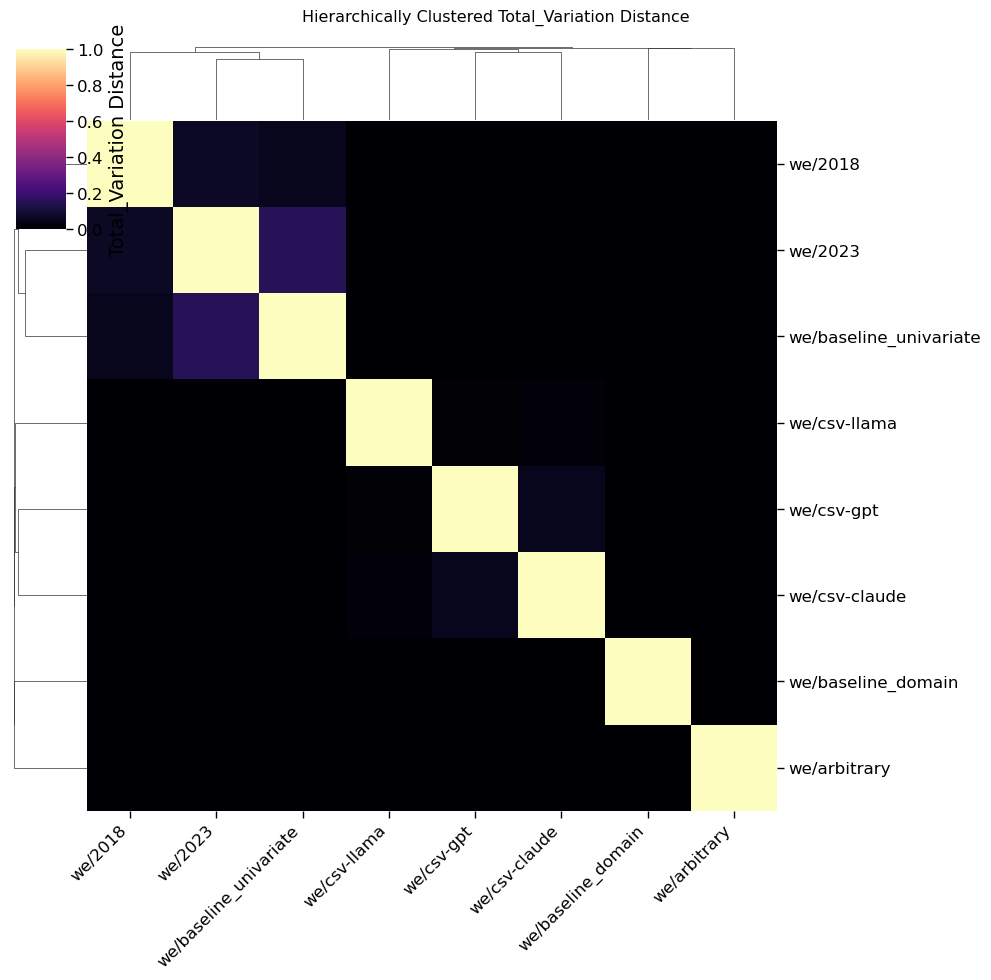


Processing measure: correspond_test

Processing measure: best_dev


/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:555: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:555: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:555: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:569: UserWarning:

Tight layout not applied. tight_layout cannot make Axes height small enough to accommodate all Axes decorations.



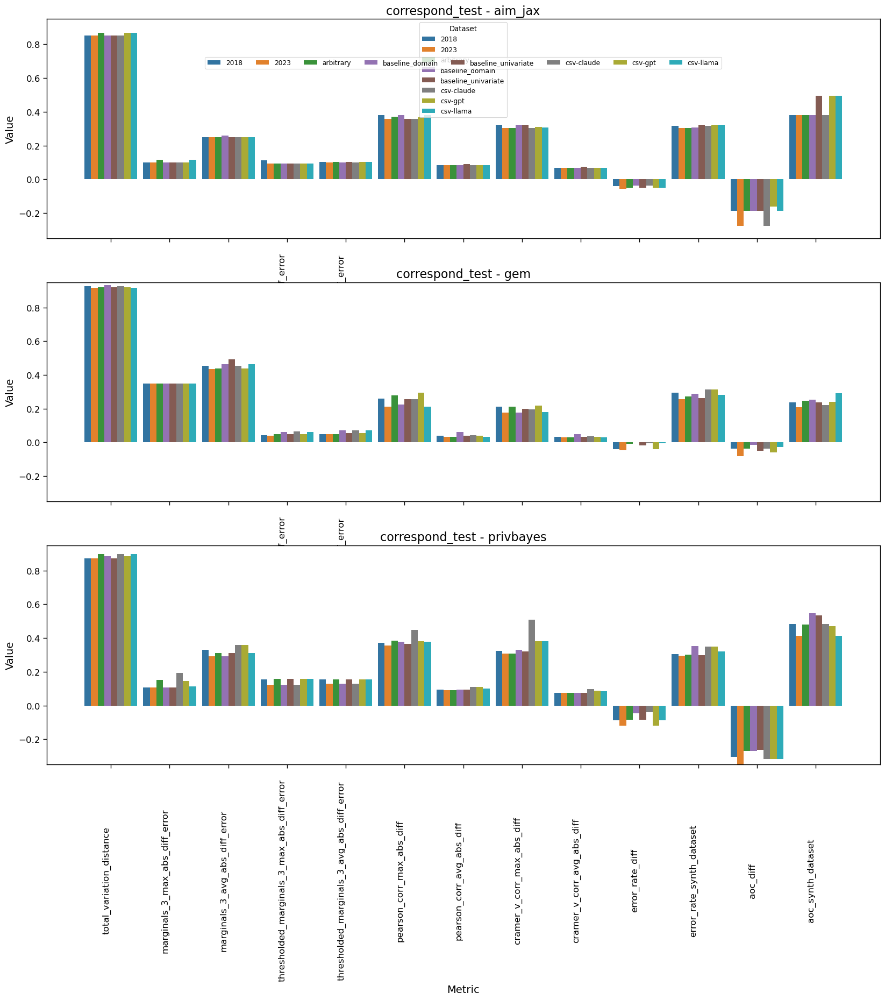

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:555: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:555: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:555: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

/Users/shlomi/projects/YDNPD/ydnpd/harness/tasks/utility.py:569: UserWarning:

Tight layout not applied. tight_layout cannot make Axes height small enough to accommodate all Axes decorations.



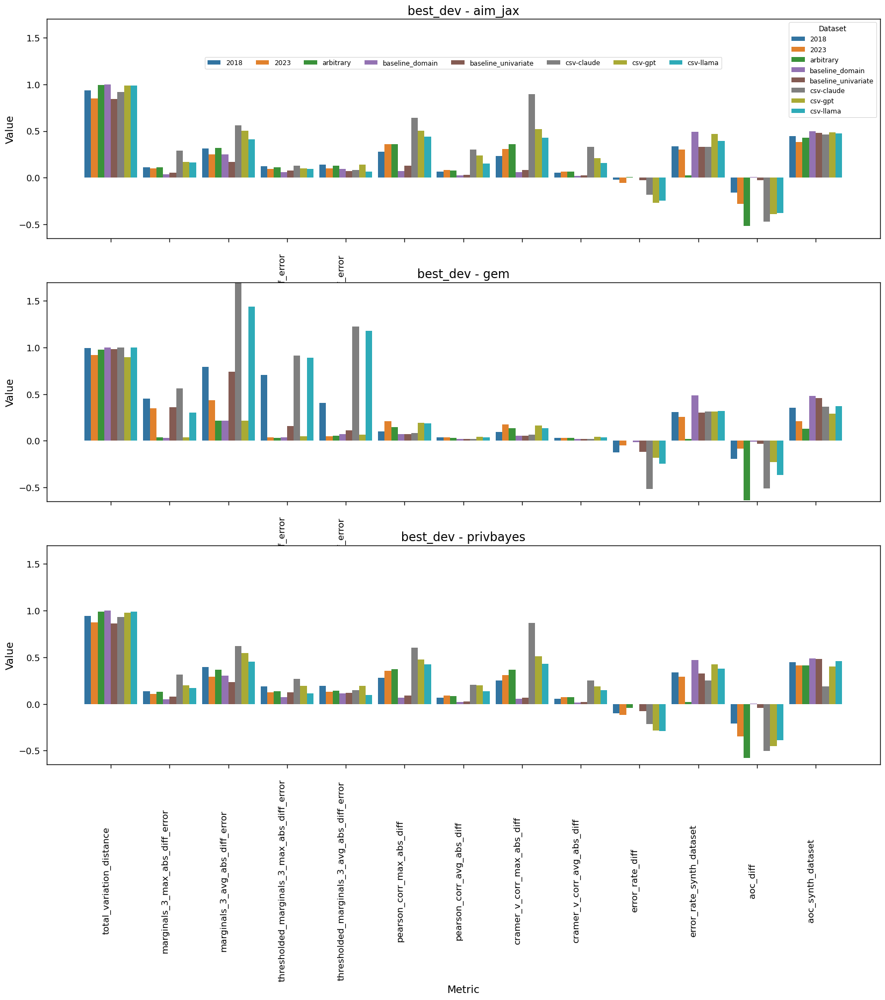

### total_variation_distance

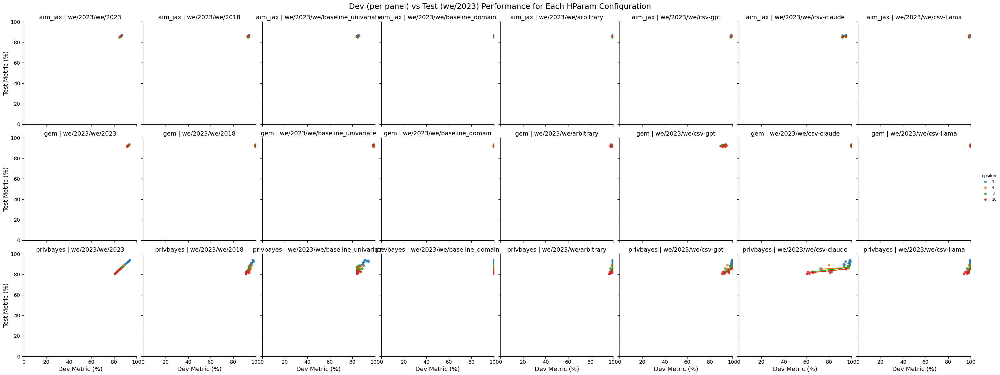

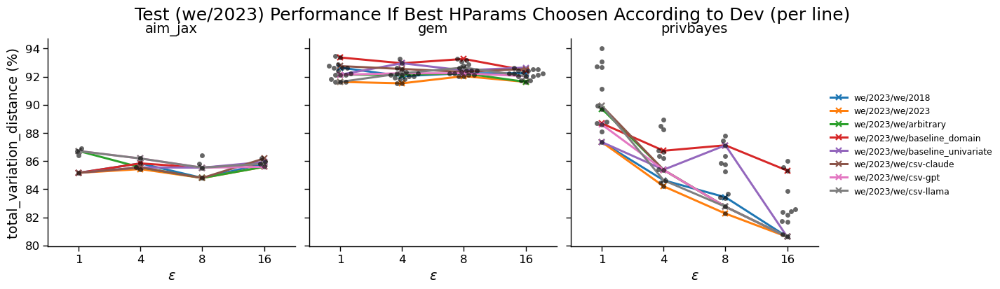

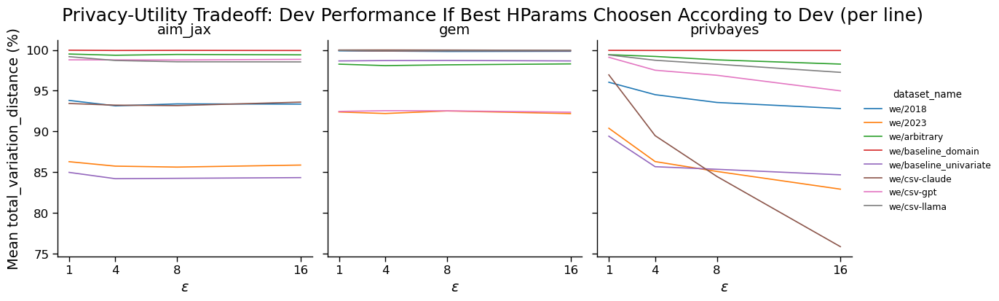

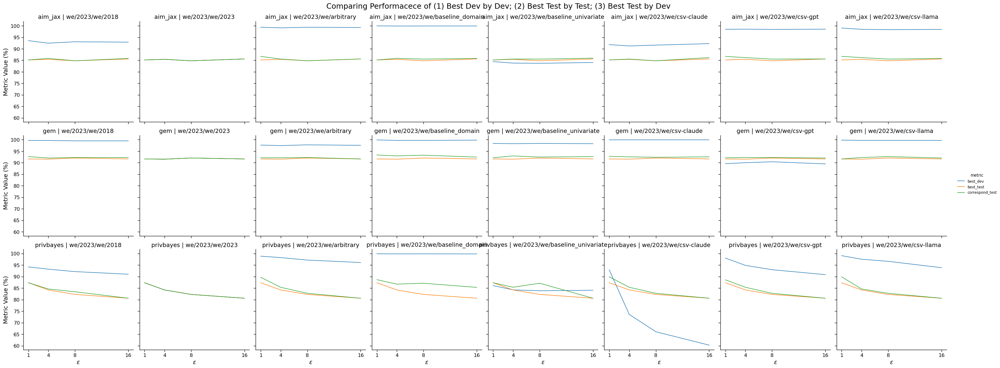

### marginals_3_max_abs_diff_error

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



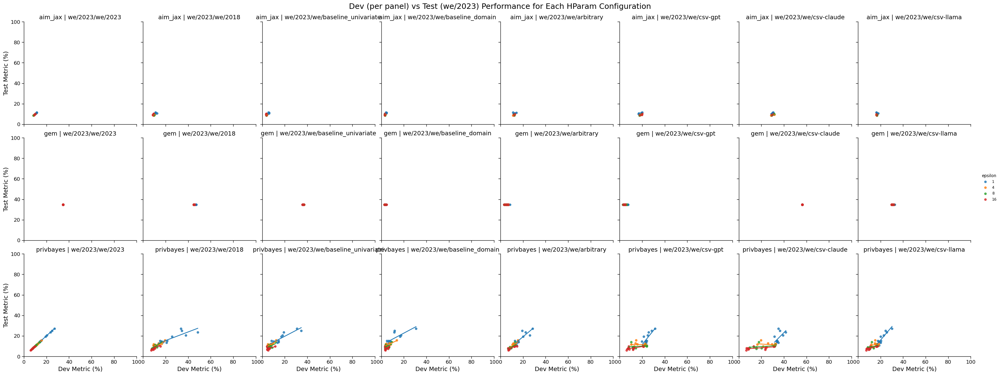

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



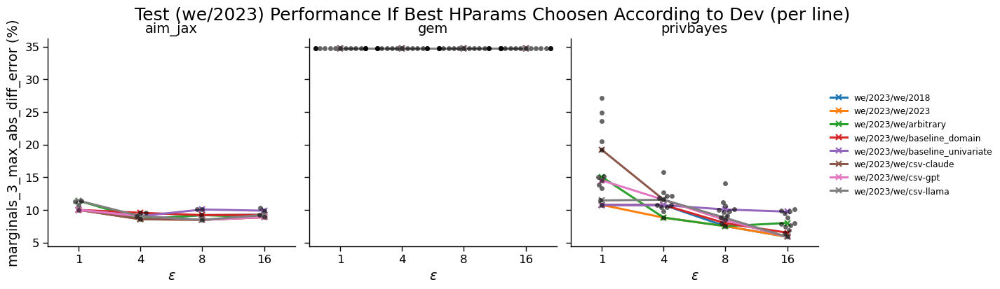

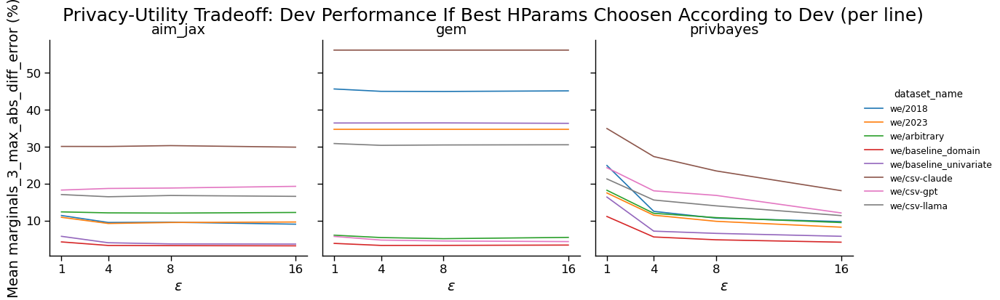

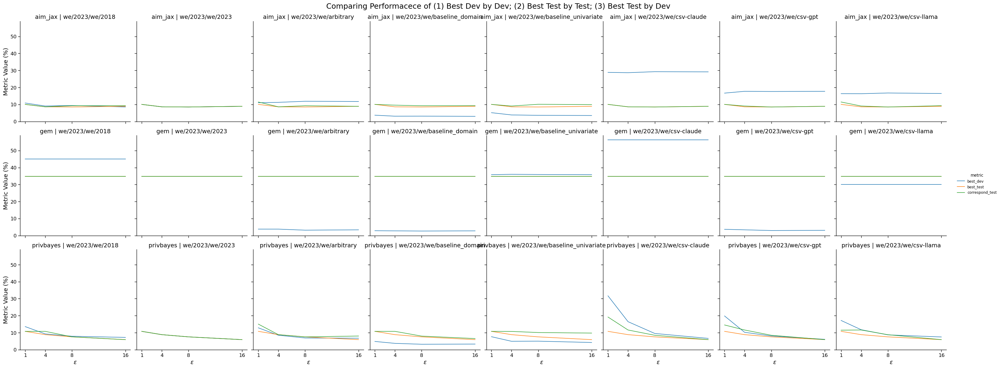

### marginals_3_avg_abs_diff_error

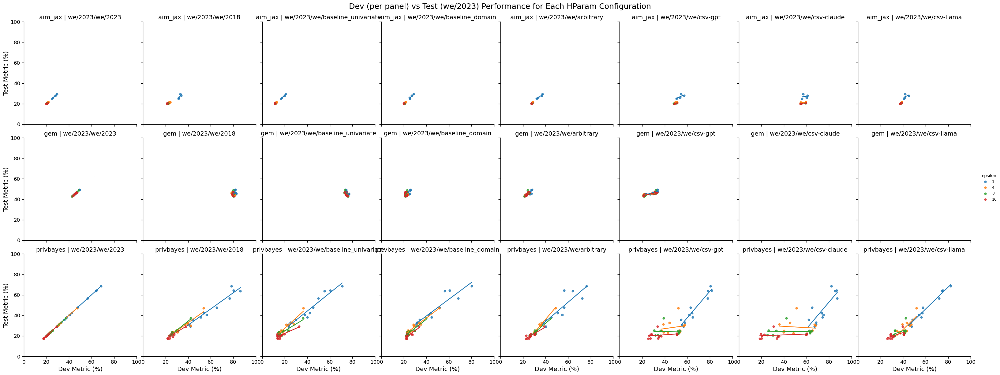

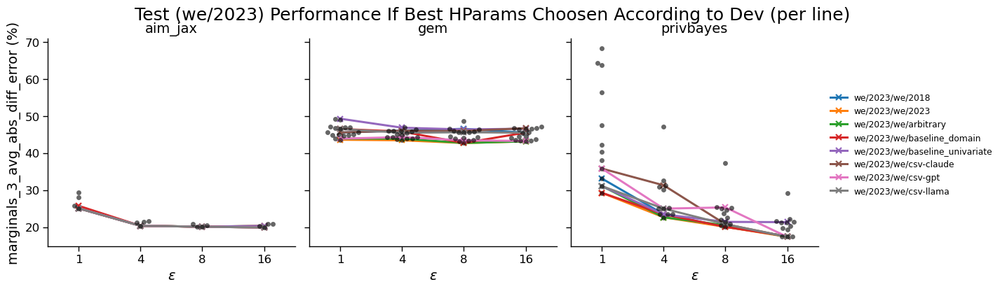

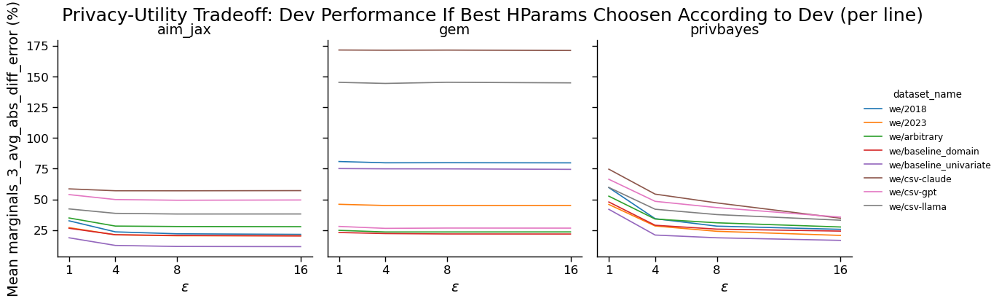

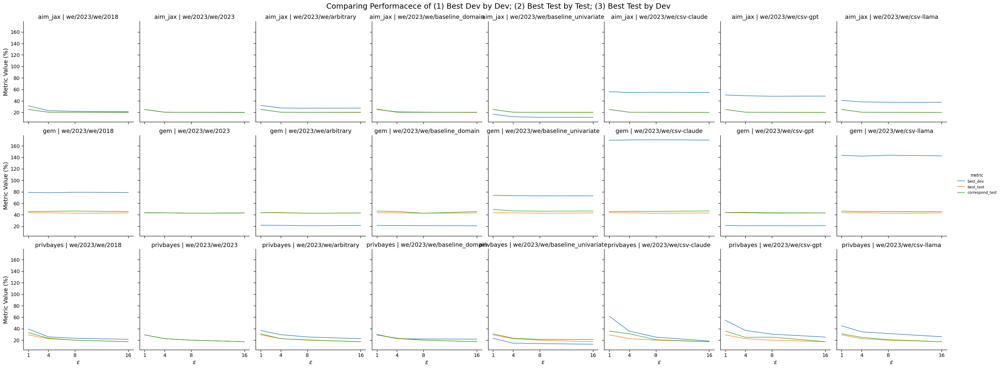

### thresholded_marginals_3_max_abs_diff_error

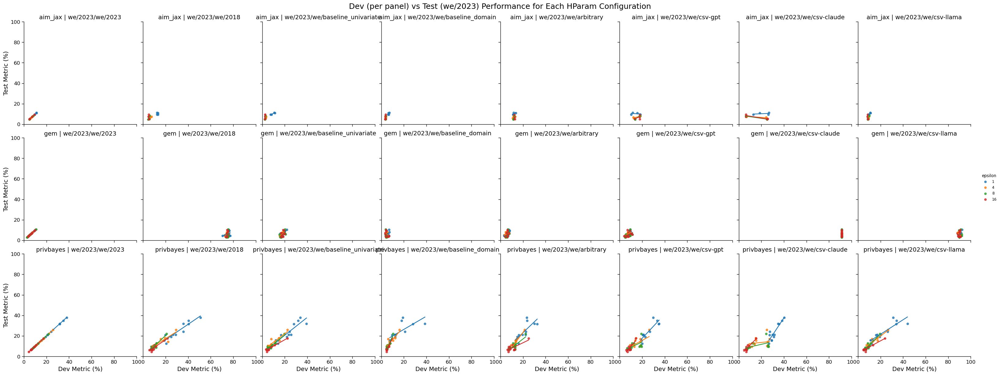

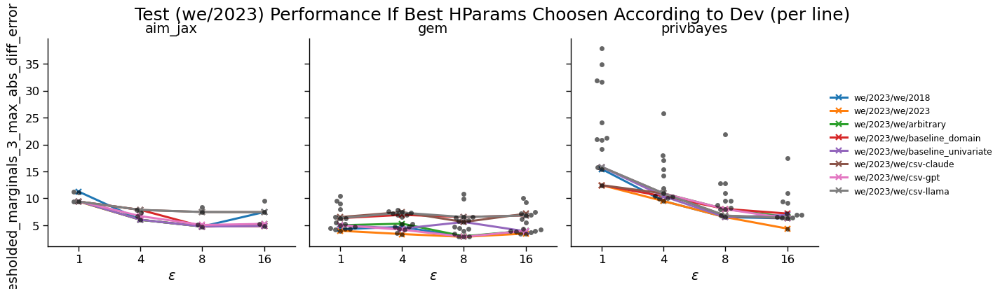

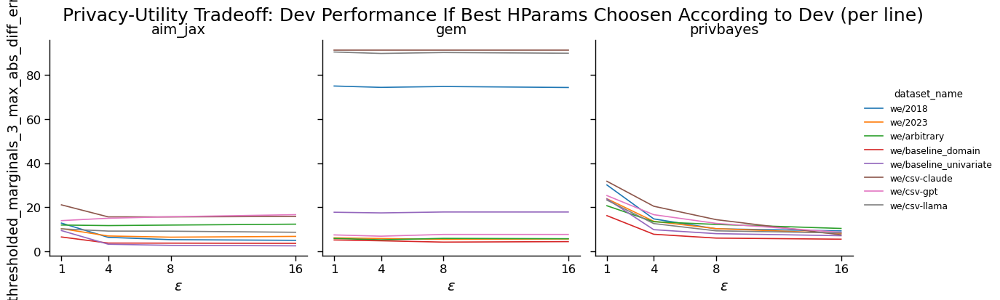

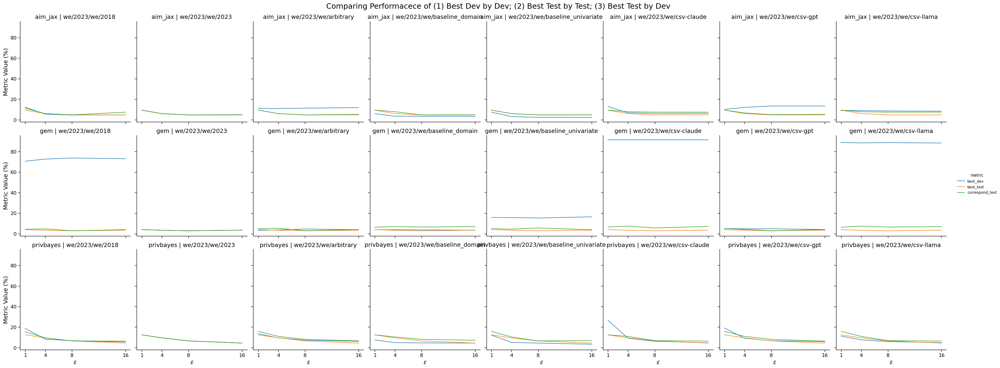

### thresholded_marginals_3_avg_abs_diff_error

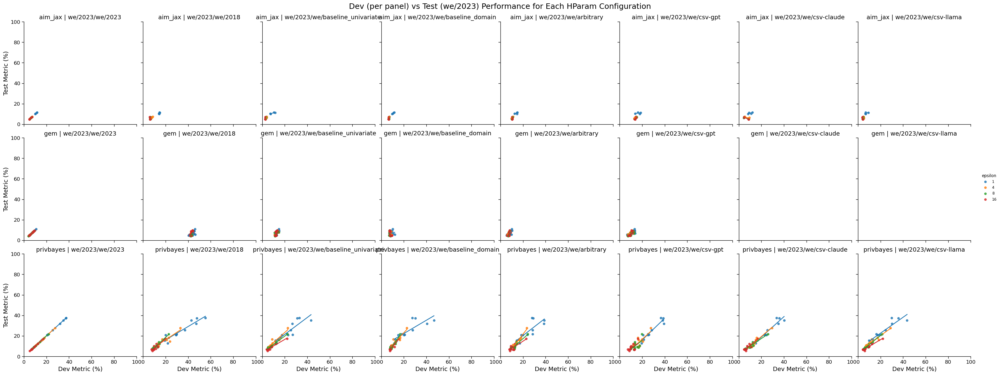

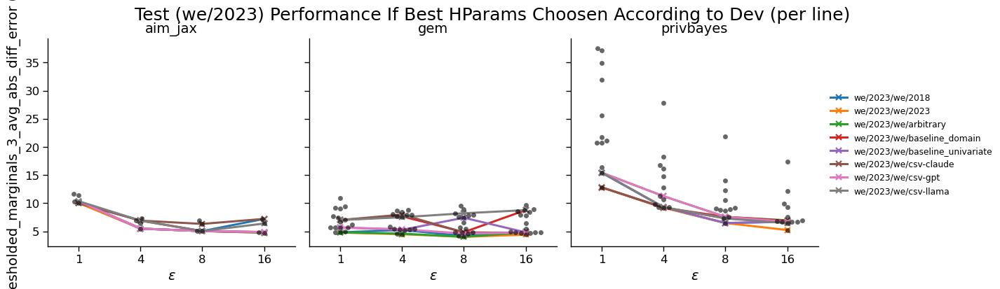

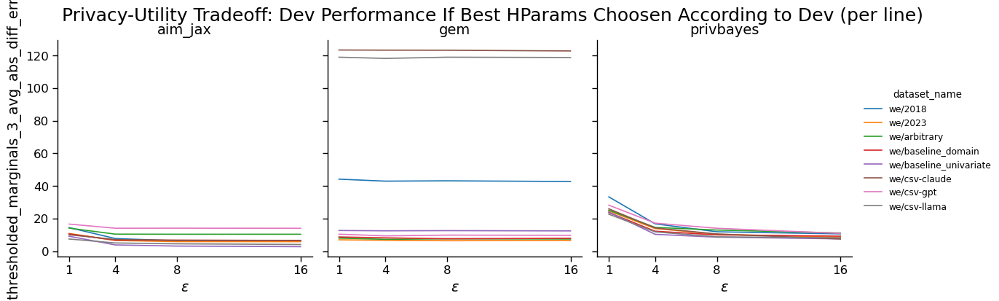

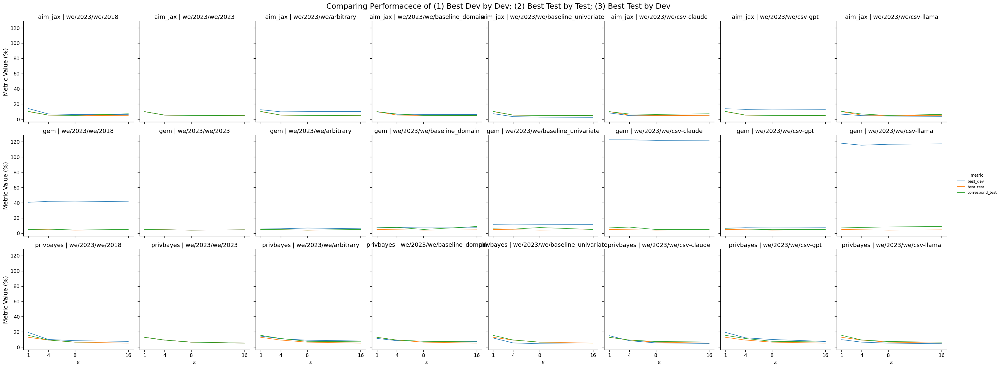

### pearson_corr_max_abs_diff

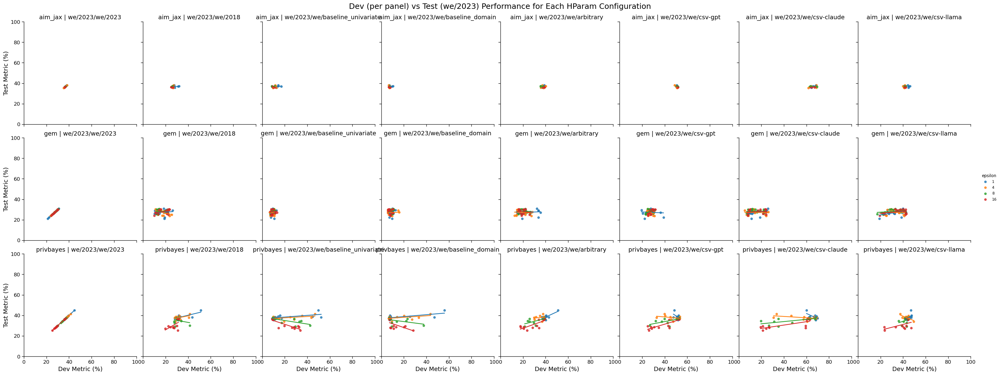

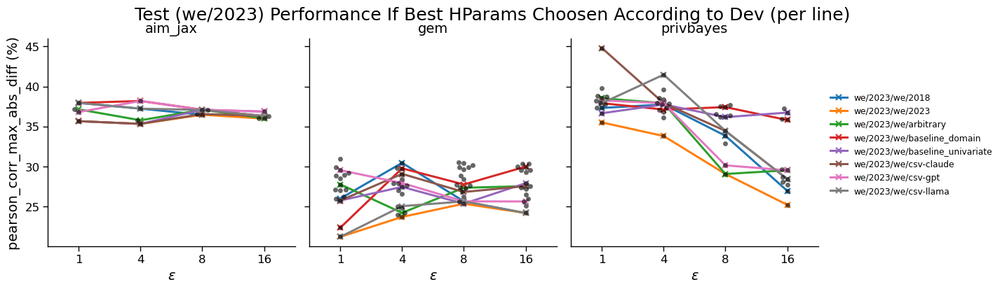

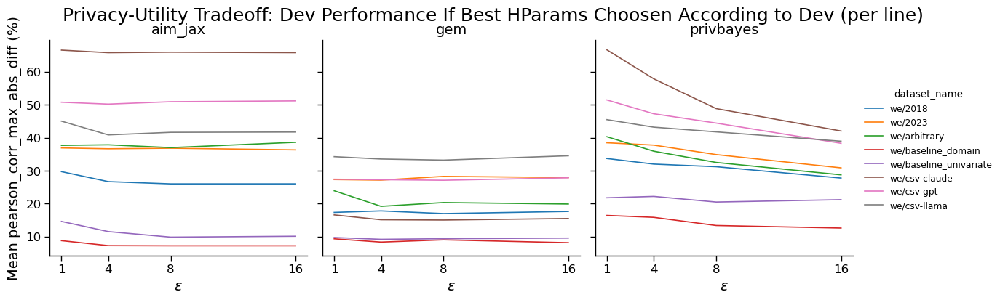

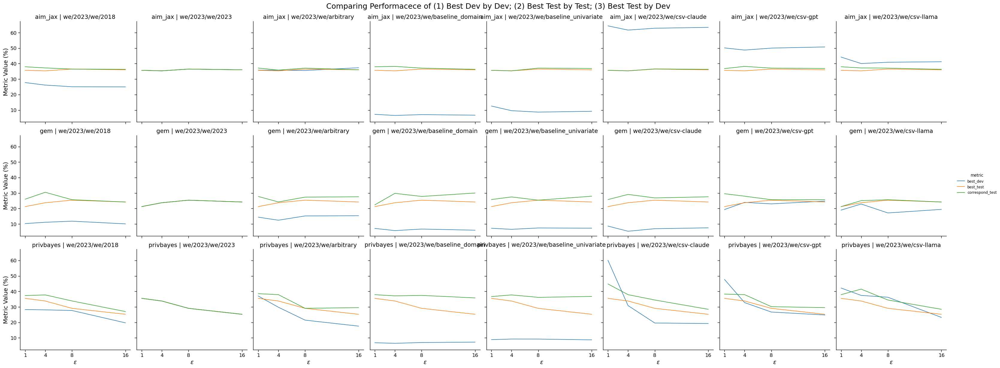

### pearson_corr_avg_abs_diff

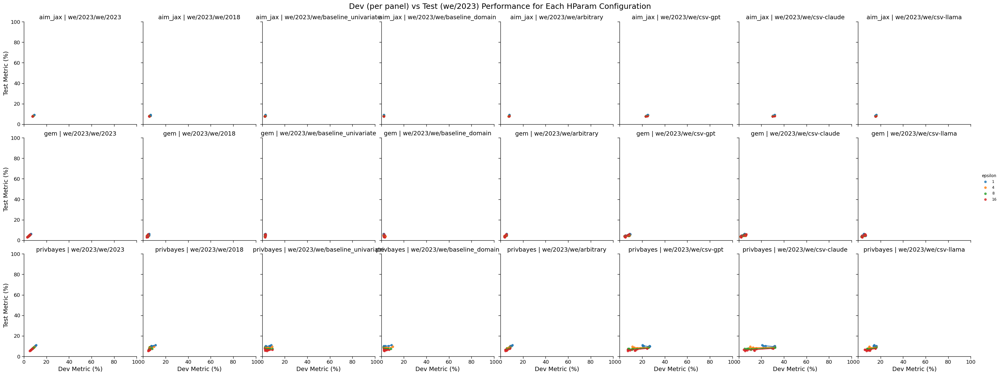

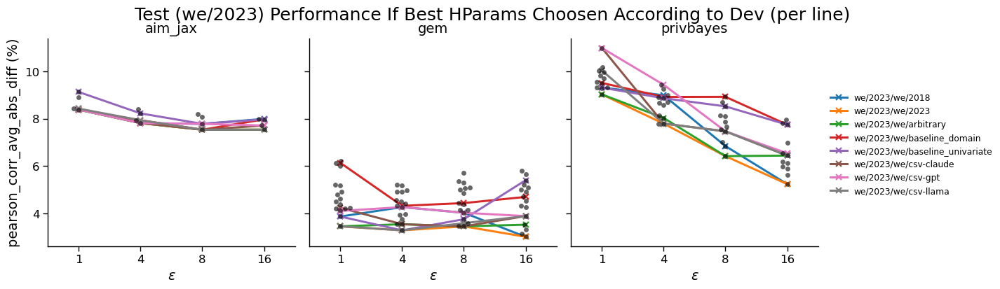

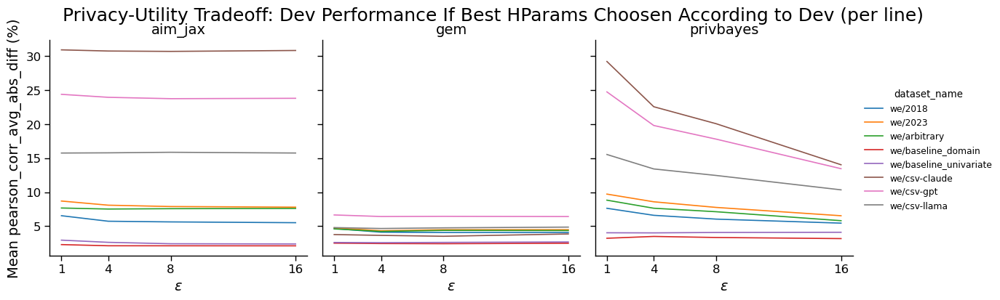

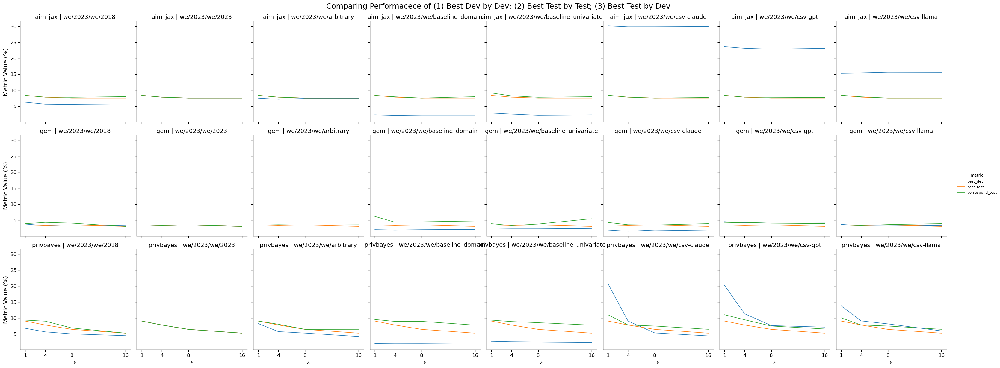

### cramer_v_corr_max_abs_diff

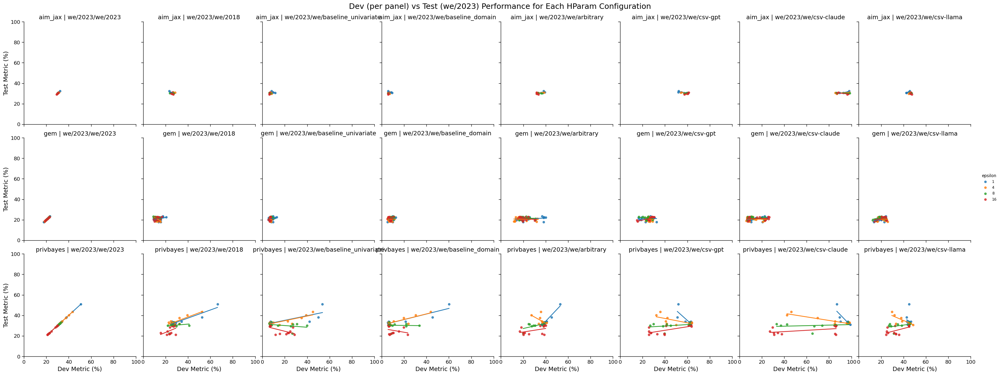

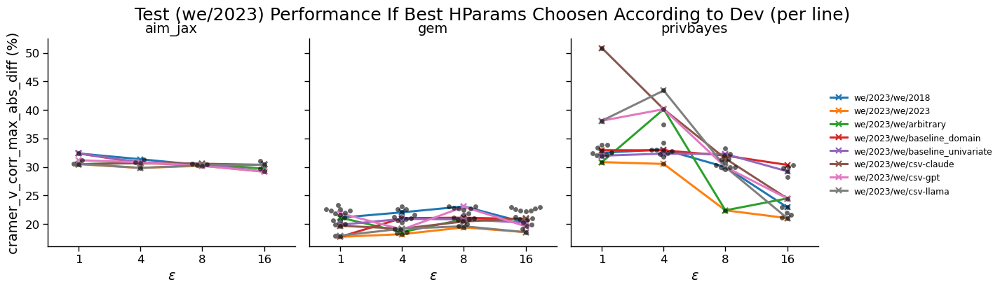

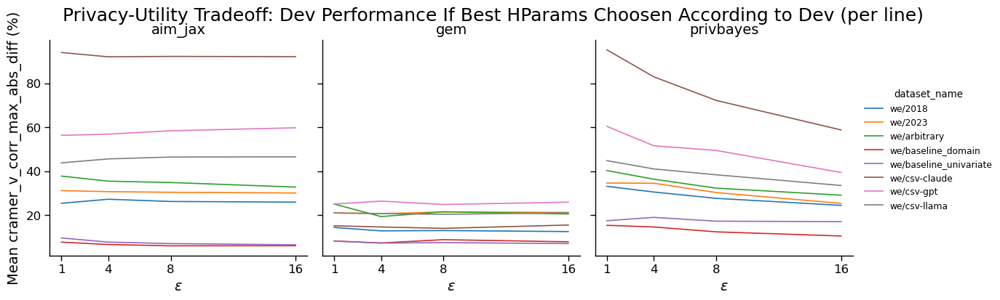

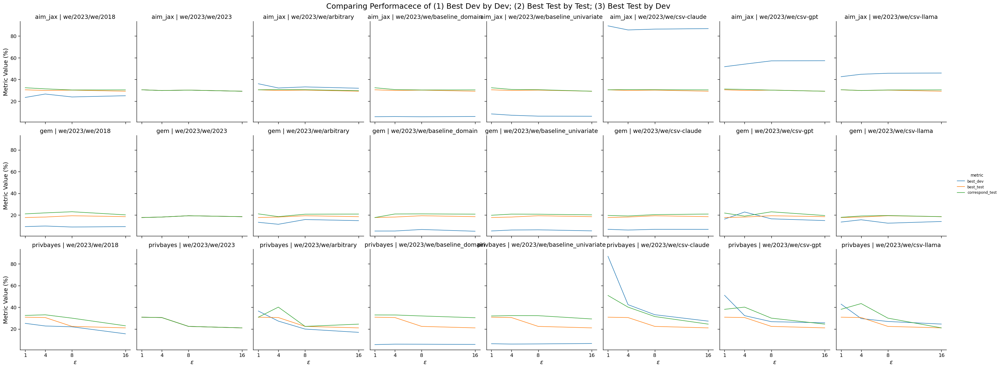

### cramer_v_corr_avg_abs_diff

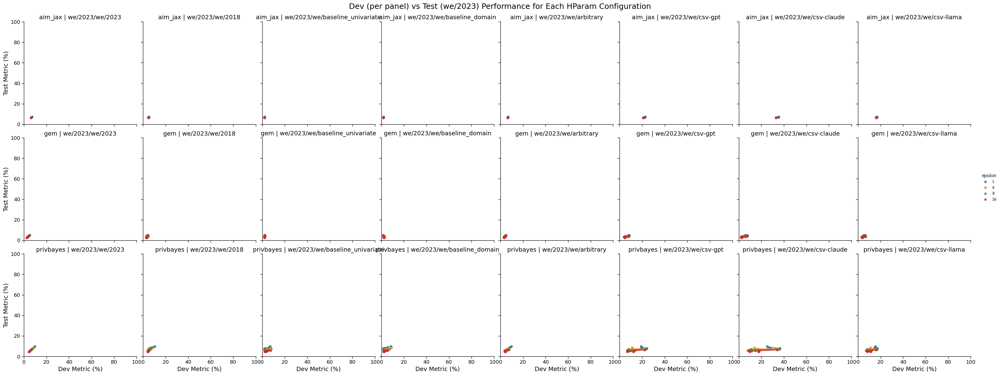

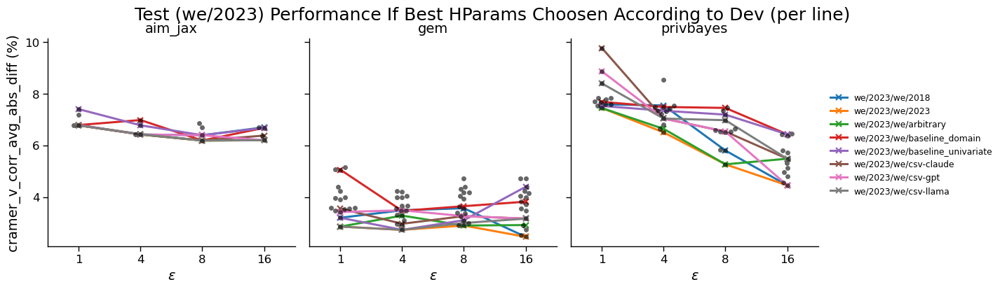

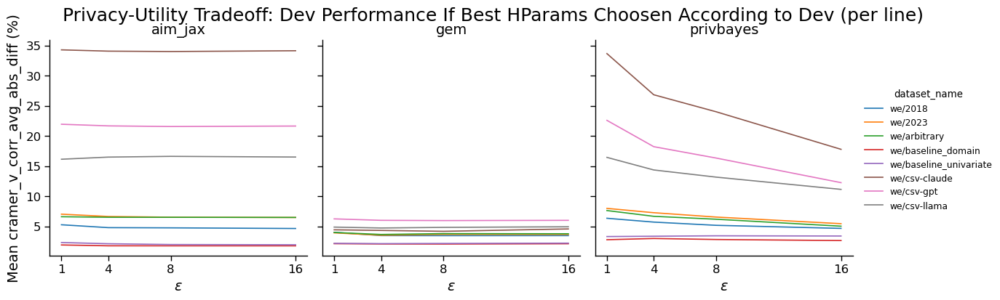

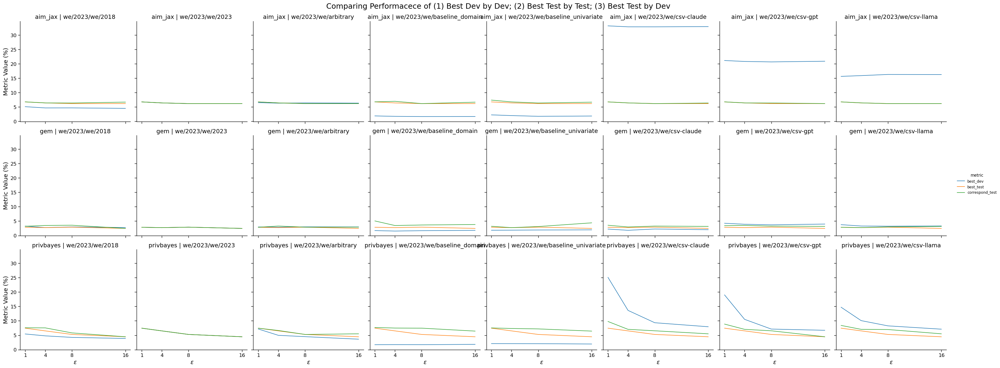

### error_rate_diff

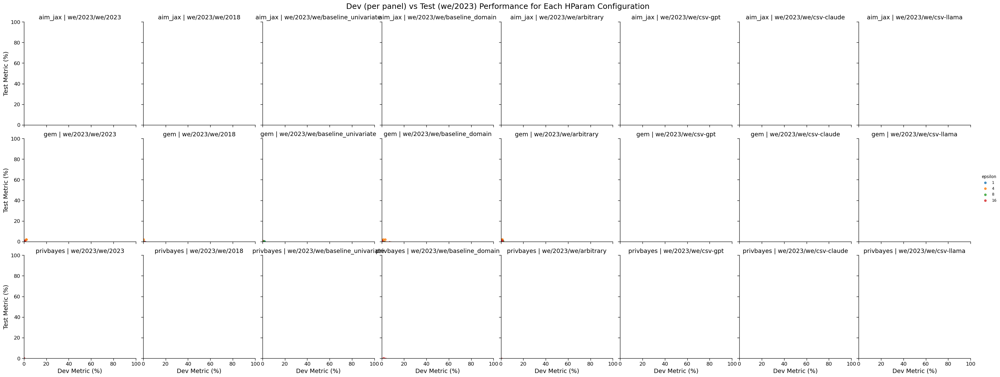

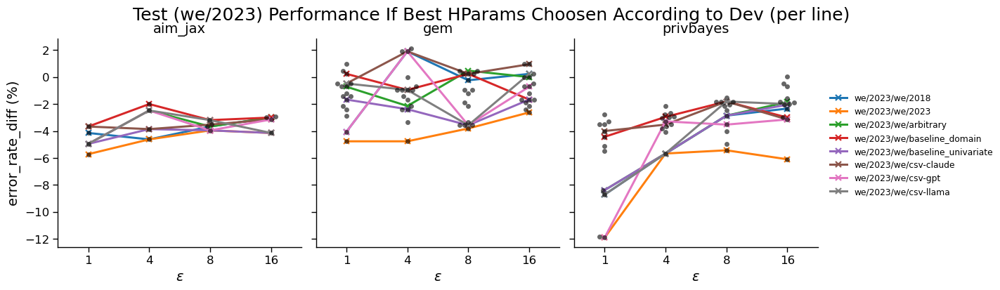

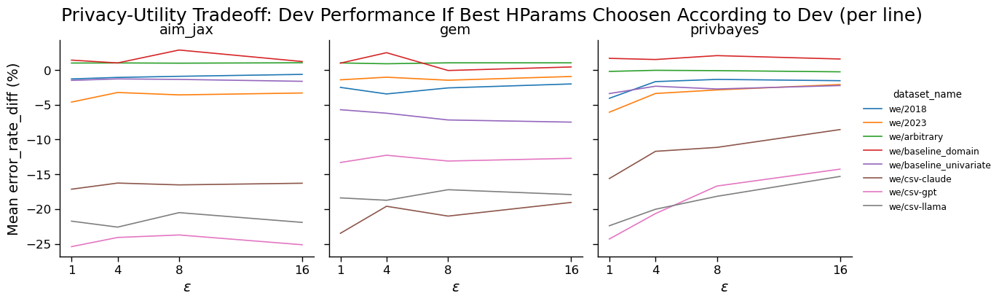

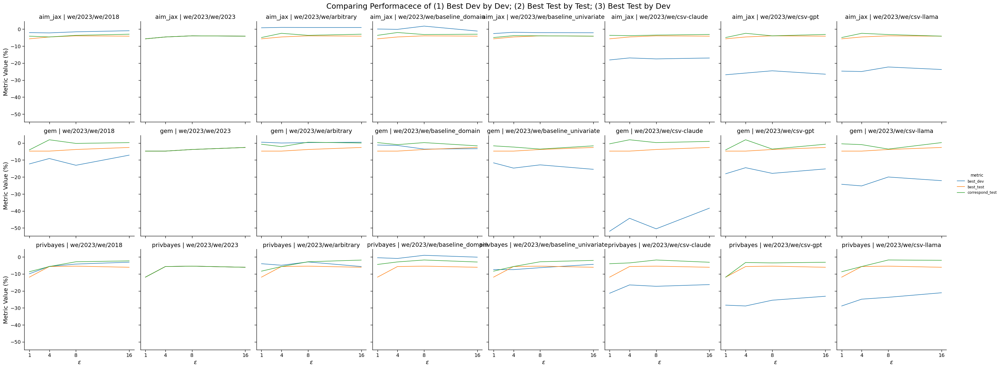

### error_rate_train_dataset

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



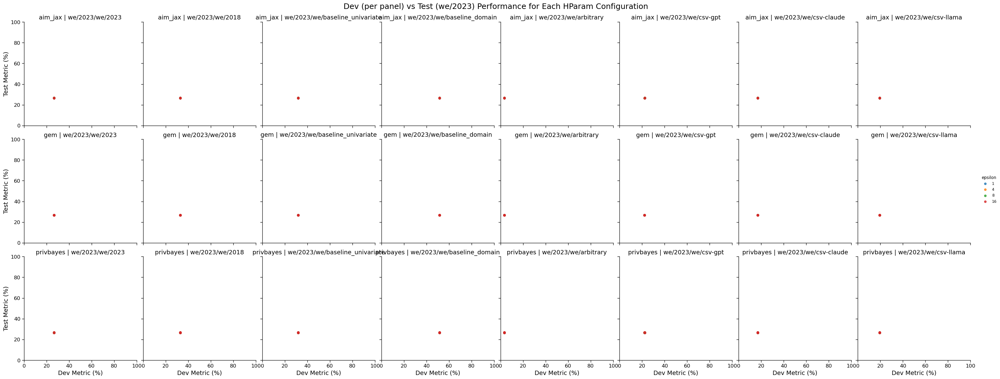

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



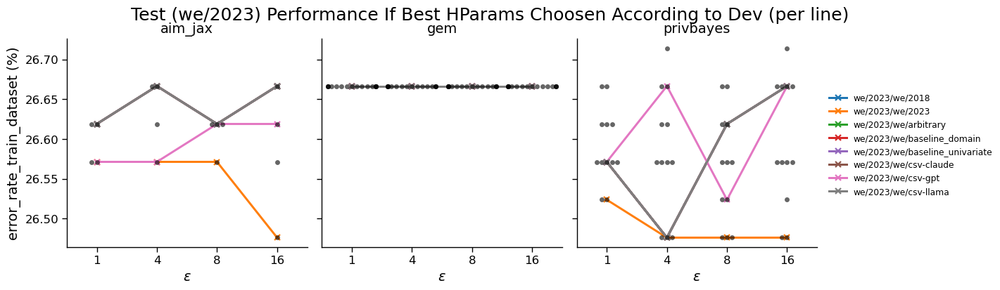

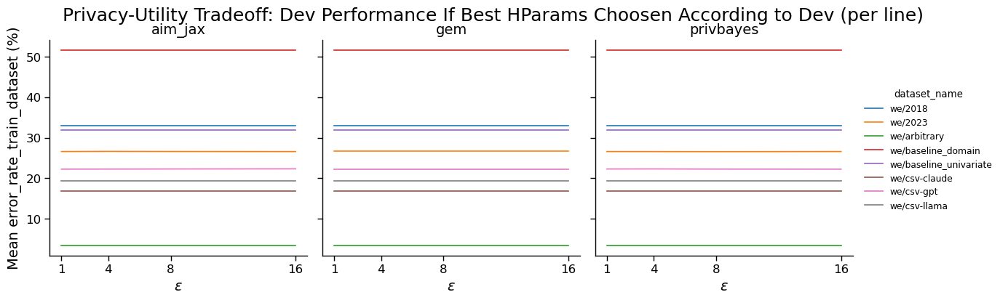

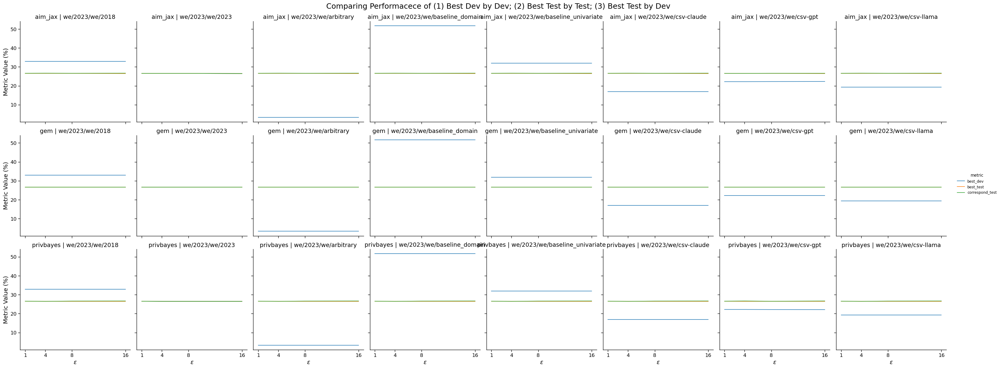

### error_rate_synth_dataset

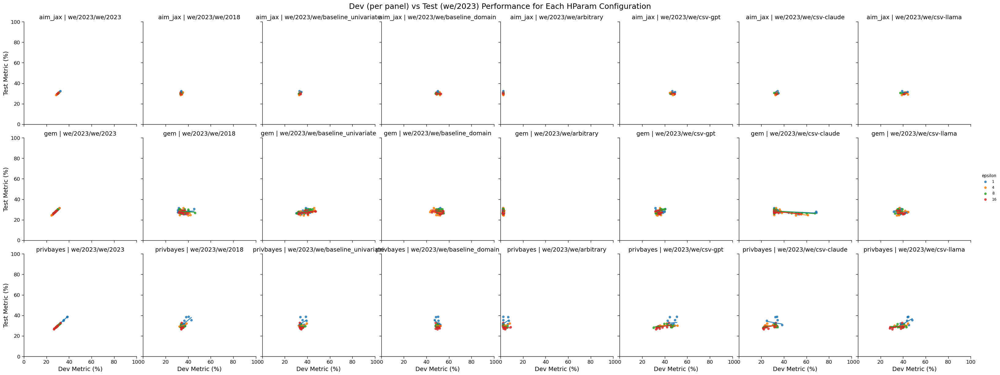

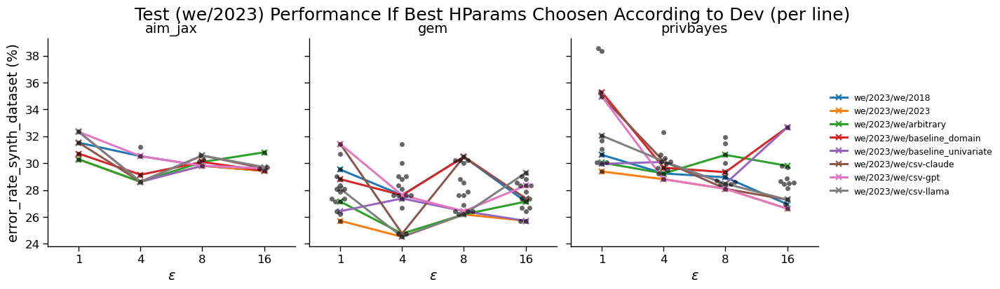

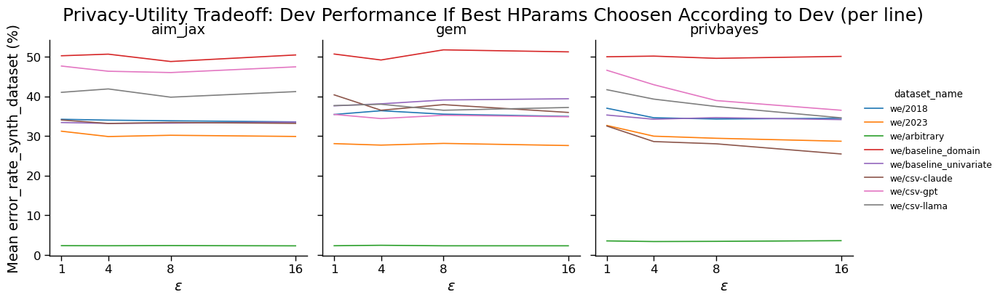

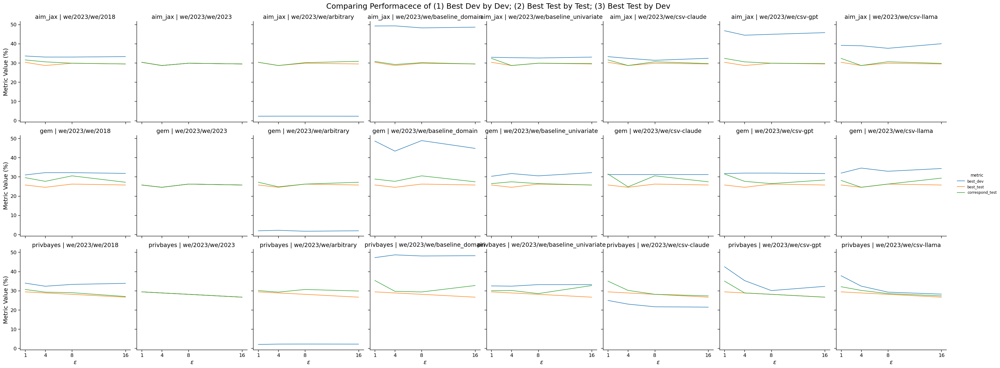

### aoc_diff

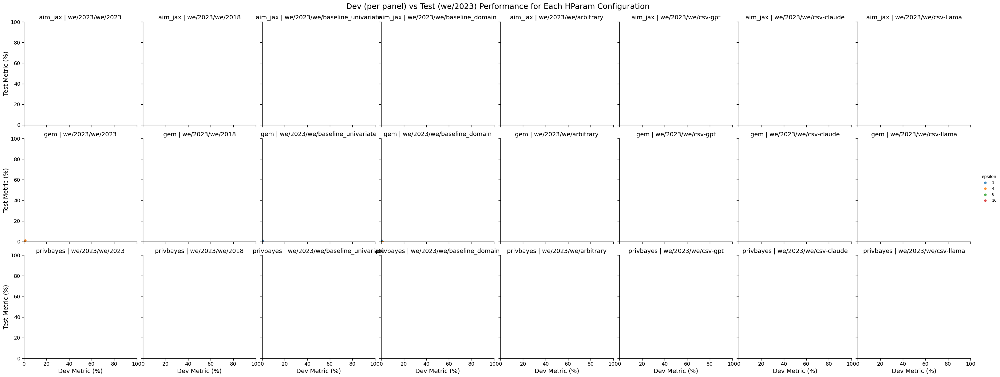

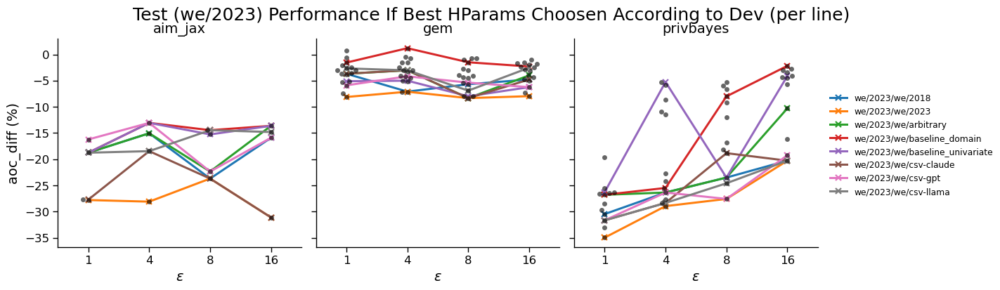

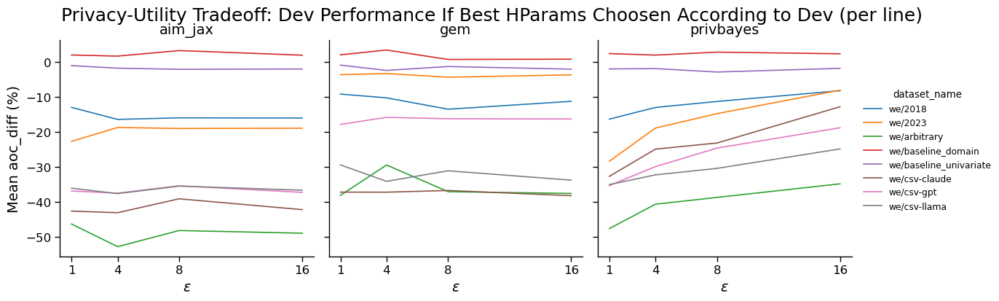

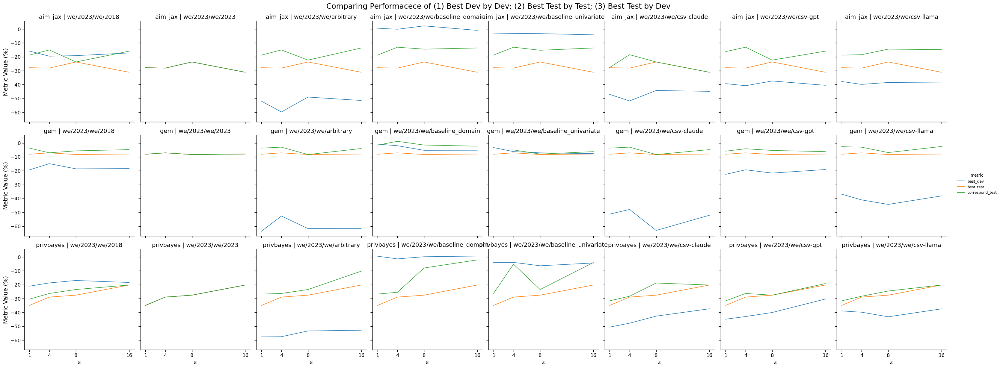

### aoc_train_dataset

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



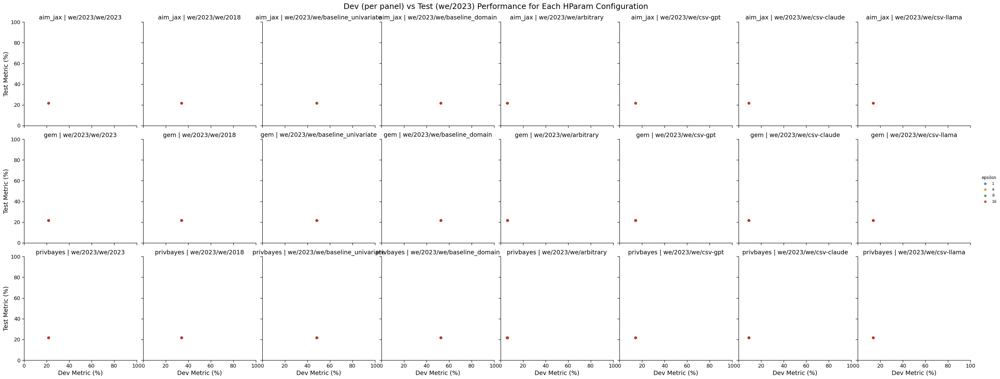

/opt/homebrew/Caskroom/miniconda/base/envs/ydnpd/lib/python3.10/site-packages/seaborn/categorical.py:3399: UserWarning:

43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.



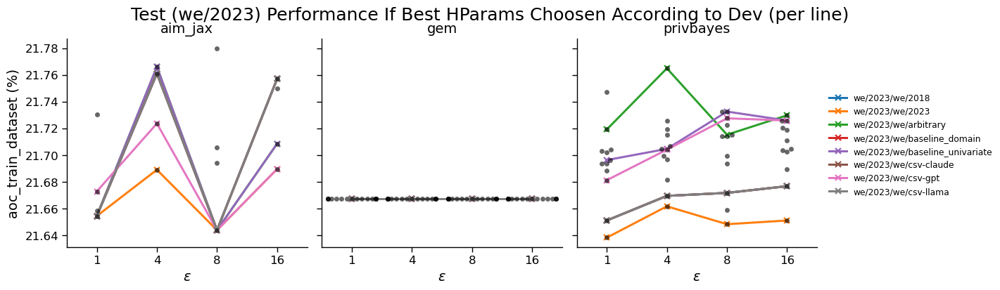

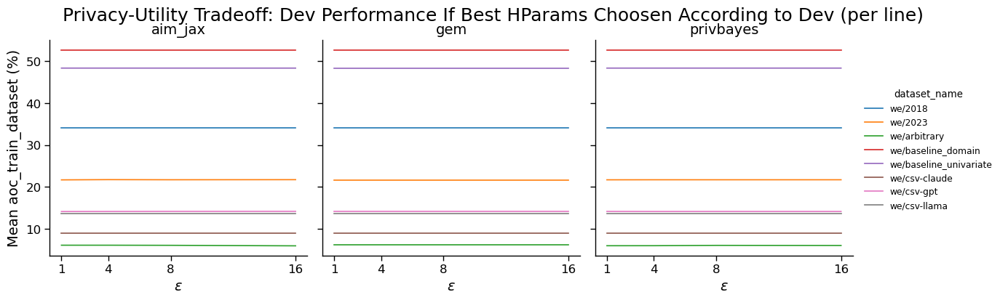

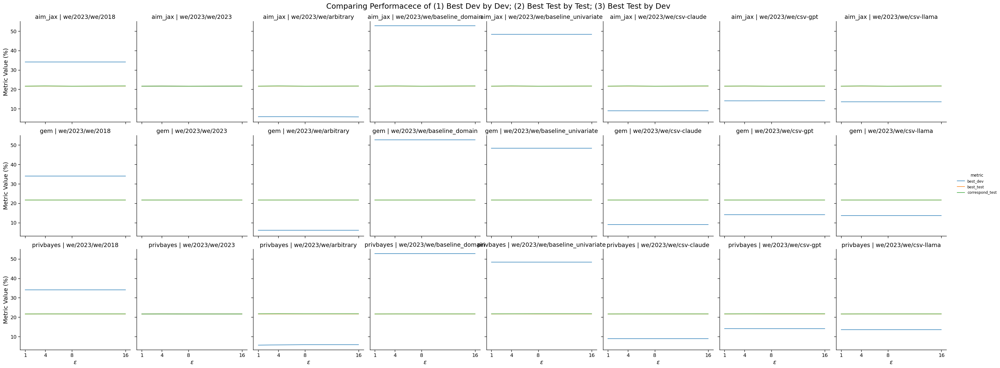

### aoc_synth_dataset

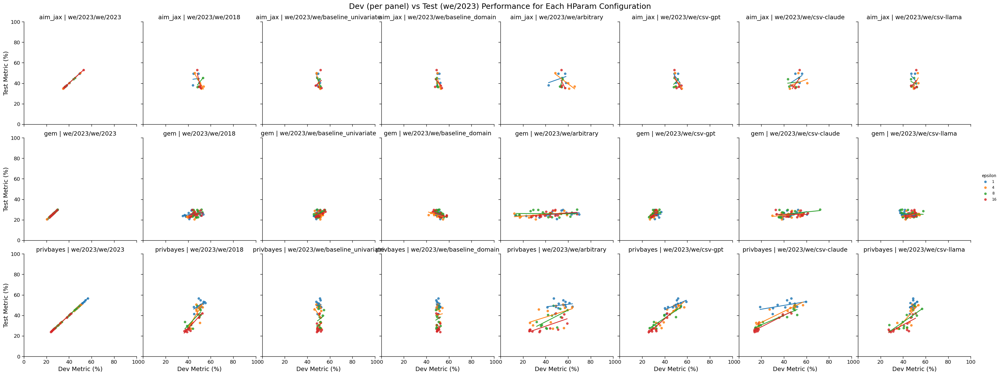

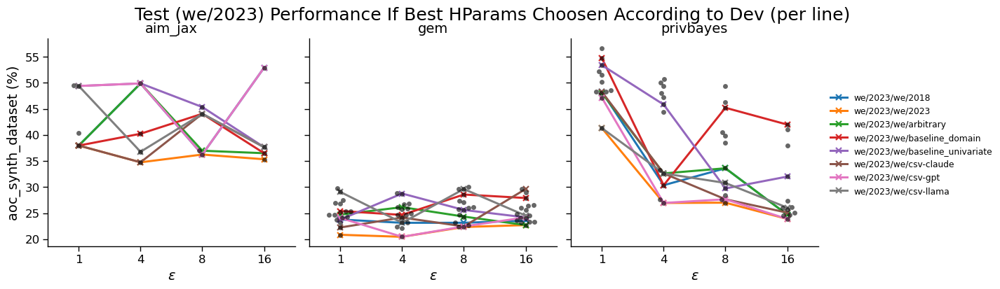

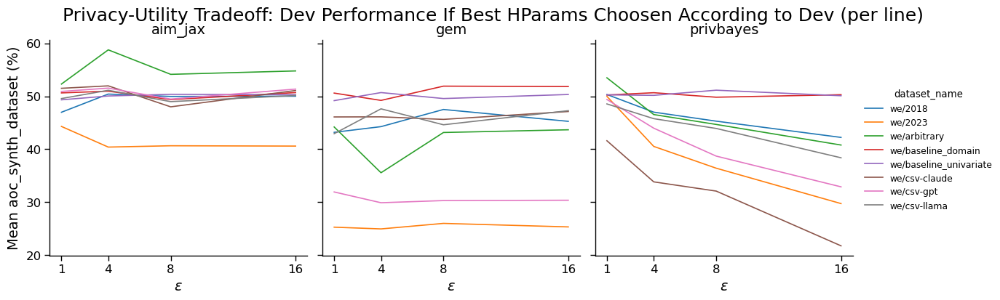

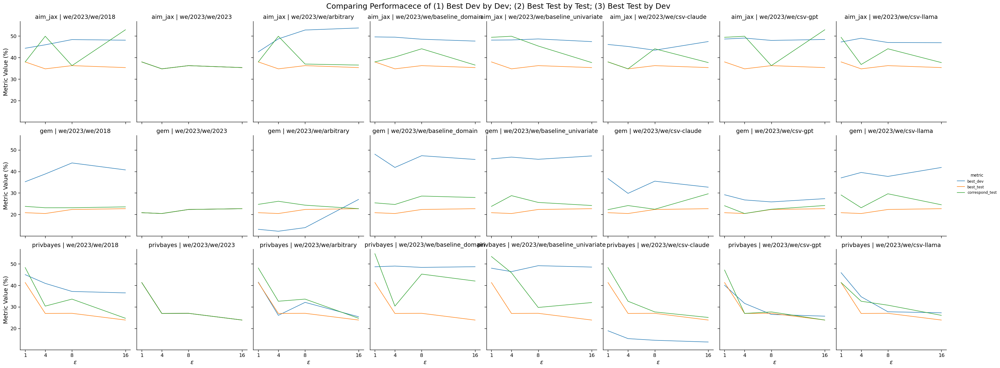

### total_variation_distance

quantile  best_dev  \
synth_name experiment                     epsilon                       
aim_jax    we/2023/we/2018                1             0.0      93.5   
                                          4            50.0      92.4   
                                          8             0.0      93.1   
                                          16           25.0      92.9   
           we/2023/we/2023                1             0.0      85.2   
                                          4             0.0      85.4   
                                          8             0.0      84.8   
                                          16            0.0      85.6   
           we/2023/we/arbitrary           1            50.0      99.4   
                                          4            25.0      99.1   
                                          8             0.0      99.4   
                                          16            0.0      99.2   
           we/2023/we/baseline_domain     1             0.0     100.0   
                                          4            50.0      99.9   
                                          8            25.0      99.9   
                                          16           25.0      99.9   
           we/2023/we/baseline_univariate 1             0.0      84.4   
                                          4            25.0      83.8   
                                          8            25.0      83.7   
                                          16           50.0      84.1   
           we/2023/we/csv-claude          1             0.0      91.8   
                                          4            25.0      91.2   
                                          8             0.0      91.6   
                                          16           75.0      92.2   
           we/2023/we/csv-gpt             1            50.0      98.5   
                                          4            75.0      98.5   
                                          8            25.0      98.4   
                                          16            0.0      98.5   
           we/2023/we/csv-llama           1            50.0      99.0   
                                          4            75.0      98.5   
                                          8            25.0      98.3   
                                          16           25.0      98.4   
gem        we/2023/we/2018                1            56.2      99.7   
                                          4            31.2      99.7   
                                          8            25.0      99.5   
                                          16           43.8      99.5   
           we/2023/we/2023                1             0.0      91.6   
                                          4             0.0      91.5   
                                          8             0.0      92.0   
                                          16            0.0      91.6   
           we/2023/we/arbitrary           1            25.0      97.7   
                                          4            43.8      97.4   
                                          8            25.0      97.8   
                                          16            0.0      97.6   
           we/2023/we/baseline_domain     1            87.5      99.9   
                                          4            87.5      99.7   
                                          8            93.8      99.7   
                                          16           68.8      99.8   
           we/2023/we/baseline_univariate 1            25.0      98.4   
                                          4            87.5      98.3   
                                          8            56.2      98.4   
                                          16           93.8      98.3   
           we/2023/we/csv-claude          1            75.0      99.9   
                                    

### marginals_3_max_abs_diff_error

quantile  best_dev  \
synth_name experiment                     epsilon                       
aim_jax    we/2023/we/2018                1             0.0      10.8   
                                          4             0.0       9.1   
                                          8            25.0       9.4   
                                          16           25.0       8.5   
           we/2023/we/2023                1             0.0      10.0   
                                          4             0.0       8.6   
                                          8             0.0       8.5   
                                          16            0.0       8.9   
           we/2023/we/arbitrary           1            75.0      11.0   
                                          4             0.0      11.2   
                                          8            25.0      11.9   
                                          16            0.0      11.7   
           we/2023/we/baseline_domain     1             0.0       3.7   
                                          4            50.0       3.1   
                                          8            25.0       3.1   
                                          16           25.0       3.0   
           we/2023/we/baseline_univariate 1             0.0       5.1   
                                          4            25.0       3.8   
                                          8            50.0       3.6   
                                          16           50.0       3.5   
           we/2023/we/csv-claude          1             0.0      28.9   
                                          4             0.0      28.7   
                                          8             0.0      29.3   
                                          16            0.0      29.2   
           we/2023/we/csv-gpt             1             0.0      16.7   
                                          4            25.0      17.7   
                                          8             0.0      17.6   
                                          16            0.0      17.7   
           we/2023/we/csv-llama           1            75.0      16.3   
                                          4            25.0      16.3   
                                          8             0.0      16.7   
                                          16           25.0      16.4   
gem        we/2023/we/2018                1             0.0      45.0   
                                          4             0.0      45.0   
                                          8             0.0      45.0   
                                          16            0.0      45.0   
           we/2023/we/2023                1             0.0      34.8   
                                          4             0.0      34.8   
                                          8             0.0      34.8   
                                          16            0.0      34.8   
           we/2023/we/arbitrary           1             0.0       3.8   
                                          4             0.0       3.8   
                                          8             0.0       3.2   
                                          16            0.0       3.4   
           we/2023/we/baseline_domain     1             0.0       2.9   
                                          4             0.0       2.8   
                                          8             0.0       2.7   
                                          16            0.0       2.8   
           we/2023/we/baseline_univariate 1             0.0      35.8   
                                          4             0.0      36.0   
                                          8             0.0      35.9   
                                          16            0.0      35.8   
           we/2023/we/csv-claude          1             0.0      56.2   
                                    

### marginals_3_avg_abs_diff_error

quantile  best_dev  \
synth_name experiment                     epsilon                       
aim_jax    we/2023/we/2018                1             0.0      31.5   
                                          4             0.0      23.0   
                                          8             0.0      21.9   
                                          16            0.0      21.3   
           we/2023/we/2023                1             0.0      25.1   
                                          4             0.0      20.4   
                                          8             0.0      20.1   
                                          16            0.0      19.9   
           we/2023/we/arbitrary           1             0.0      32.1   
                                          4             0.0      27.7   
                                          8            25.0      27.3   
                                          16           25.0      27.5   
           we/2023/we/baseline_domain     1            25.0      25.1   
                                          4             0.0      20.9   
                                          8             0.0      20.4   
                                          16           25.0      20.0   
           we/2023/we/baseline_univariate 1             0.0      16.8   
                                          4             0.0      12.4   
                                          8            25.0      11.5   
                                          16           25.0      11.4   
           we/2023/we/csv-claude          1             0.0      56.1   
                                          4             0.0      54.6   
                                          8            25.0      54.9   
                                          16            0.0      54.6   
           we/2023/we/csv-gpt             1             0.0      50.3   
                                          4             0.0      49.0   
                                          8             0.0      48.1   
                                          16            0.0      48.4   
           we/2023/we/csv-llama           1             0.0      40.8   
                                          4             0.0      38.3   
                                          8             0.0      37.6   
                                          16            0.0      37.6   
gem        we/2023/we/2018                1            43.8      79.0   
                                          4            81.2      78.4   
                                          8            87.5      79.2   
                                          16           50.0      78.8   
           we/2023/we/2023                1             0.0      43.6   
                                          4             0.0      43.5   
                                          8             0.0      42.7   
                                          16            0.0      43.2   
           we/2023/we/arbitrary           1             6.2      21.8   
                                          4            18.8      21.7   
                                          8             0.0      21.1   
                                          16            0.0      21.5   
           we/2023/we/baseline_domain     1            56.2      21.4   
                                          4            62.5      21.4   
                                          8             0.0      21.2   
                                          16           56.2      20.9   
           we/2023/we/baseline_univariate 1            93.8      74.0   
                                          4            93.8      73.3   
                                          8            81.2      73.0   
                                          16           68.8      73.0   
           we/2023/we/csv-claude          1            43.8     169.7   
                                    

### thresholded_marginals_3_max_abs_diff_error

quantile  best_dev  \
synth_name experiment                     epsilon                       
aim_jax    we/2023/we/2018                1            75.0      12.3   
                                          4             0.0       5.5   
                                          8             0.0       4.6   
                                          16           50.0       4.8   
           we/2023/we/2023                1             0.0       9.4   
                                          4             0.0       6.0   
                                          8             0.0       4.8   
                                          16            0.0       4.9   
           we/2023/we/arbitrary           1            25.0      11.2   
                                          4             0.0      11.0   
                                          8             0.0      11.3   
                                          16           25.0      11.9   
           we/2023/we/baseline_domain     1             0.0       6.0   
                                          4            75.0       3.4   
                                          8             0.0       3.5   
                                          16            0.0       3.4   
           we/2023/we/baseline_univariate 1            25.0       7.4   
                                          4             0.0       3.1   
                                          8             0.0       2.4   
                                          16            0.0       2.4   
           we/2023/we/csv-claude          1             0.0      13.0   
                                          4            75.0       6.8   
                                          8            50.0       6.3   
                                          16           50.0       6.3   
           we/2023/we/csv-gpt             1            25.0      10.2   
                                          4            25.0      12.1   
                                          8            25.0      13.5   
                                          16           25.0      13.5   
           we/2023/we/csv-llama           1             0.0       9.1   
                                          4            75.0       9.0   
                                          8            50.0       8.6   
                                          16           50.0       8.3   
gem        we/2023/we/2018                1            12.5      70.6   
                                          4            25.0      72.6   
                                          8             0.0      73.7   
                                          16           25.0      73.0   
           we/2023/we/2023                1             0.0       4.0   
                                          4             0.0       3.4   
                                          8             0.0       2.9   
                                          16            0.0       3.5   
           we/2023/we/arbitrary           1            37.5       3.3   
                                          4            43.8       3.7   
                                          8             6.2       4.6   
                                          16           25.0       3.9   
           we/2023/we/baseline_domain     1            56.2       3.9   
                                          4            56.2       3.9   
                                          8            75.0       3.7   
                                          16           62.5       3.5   
           we/2023/we/baseline_univariate 1            37.5      15.8   
                                          4            18.8      15.7   
                                          8            50.0      15.3   
                                          16           18.8      16.4   
           we/2023/we/csv-claude          1            68.8      91.4   
                                    

### thresholded_marginals_3_avg_abs_diff_error

quantile  best_dev  \
synth_name experiment                     epsilon                       
aim_jax    we/2023/we/2018                1            25.0      14.1   
                                          4             0.0       7.0   
                                          8             0.0       6.2   
                                          16           75.0       6.0   
           we/2023/we/2023                1             0.0      10.0   
                                          4             0.0       5.5   
                                          8             0.0       5.0   
                                          16            0.0       4.8   
           we/2023/we/arbitrary           1            25.0      12.6   
                                          4             0.0       9.7   
                                          8             0.0      10.0   
                                          16            0.0      10.2   
           we/2023/we/baseline_domain     1             0.0       9.7   
                                          4            50.0       6.6   
                                          8             0.0       6.4   
                                          16           25.0       6.4   
           we/2023/we/baseline_univariate 1            25.0       7.3   
                                          4             0.0       3.5   
                                          8             0.0       2.8   
                                          16           25.0       2.5   
           we/2023/we/csv-claude          1             0.0       8.3   
                                          4            50.0       4.9   
                                          8            50.0       4.5   
                                          16           75.0       4.6   
           we/2023/we/csv-gpt             1            25.0      13.8   
                                          4             0.0      13.0   
                                          8             0.0      13.3   
                                          16           25.0      13.1   
           we/2023/we/csv-llama           1            25.0       6.7   
                                          4            50.0       4.8   
                                          8             0.0       4.2   
                                          16           50.0       3.8   
gem        we/2023/we/2018                1             6.2      40.5   
                                          4            12.5      41.8   
                                          8             6.2      42.1   
                                          16           37.5      41.2   
           we/2023/we/2023                1             0.0       4.8   
                                          4             0.0       4.5   
                                          8             0.0       4.0   
                                          16            0.0       4.4   
           we/2023/we/arbitrary           1             6.2       5.5   
                                          4             6.2       5.8   
                                          8             0.0       6.8   
                                          16           31.2       5.8   
           we/2023/we/baseline_domain     1            56.2       7.2   
                                          4            56.2       7.4   
                                          8            31.2       7.0   
                                          16           81.2       7.1   
           we/2023/we/baseline_univariate 1            18.8      11.2   
                                          4            18.8      11.0   
                                          8            56.2      11.1   
                                          16           31.2      11.2   
           we/2023/we/csv-claude          1            56.2     122.6   
                                    

### pearson_corr_max_abs_diff

quantile  best_dev  \
synth_name experiment                     epsilon                       
aim_jax    we/2023/we/2018                1            75.0      27.8   
                                          4            50.0      26.1   
                                          8             0.0      25.1   
                                          16           50.0      25.0   
           we/2023/we/2023                1             0.0      35.7   
                                          4             0.0      35.3   
                                          8             0.0      36.5   
                                          16            0.0      36.0   
           we/2023/we/arbitrary           1            50.0      35.8   
                                          4            25.0      35.7   
                                          8            75.0      35.6   
                                          16           25.0      37.3   
           we/2023/we/baseline_domain     1            75.0       7.2   
                                          4            75.0       6.5   
                                          8            75.0       7.0   
                                          16           50.0       6.7   
           we/2023/we/baseline_univariate 1             0.0      12.6   
                                          4             0.0       9.6   
                                          8            75.0       8.7   
                                          16           75.0       9.2   
           we/2023/we/csv-claude          1             0.0      64.4   
                                          4             0.0      61.7   
                                          8            25.0      62.9   
                                          16           50.0      63.4   
           we/2023/we/csv-gpt             1            25.0      50.2   
                                          4            75.0      48.7   
                                          8            75.0      50.0   
                                          16           75.0      50.8   
           we/2023/we/csv-llama           1            75.0      44.2   
                                          4            50.0      40.1   
                                          8            50.0      40.9   
                                          16           50.0      41.2   
gem        we/2023/we/2018                1            18.8      10.3   
                                          4            93.8      11.1   
                                          8             6.2      11.8   
                                          16            0.0      10.1   
           we/2023/we/2023                1             0.0      21.2   
                                          4             0.0      23.7   
                                          8             0.0      25.4   
                                          16            0.0      24.2   
           we/2023/we/arbitrary           1            50.0      14.4   
                                          4            12.5      12.4   
                                          8            31.2      15.2   
                                          16           43.8      15.3   
           we/2023/we/baseline_domain     1             6.2       7.1   
                                          4            81.2       5.7   
                                          8            43.8       6.7   
                                          16           81.2       6.0   
           we/2023/we/baseline_univariate 1            12.5       7.2   
                                          4            43.8       6.5   
                                          8             0.0       7.4   
                                          16           50.0       7.3   
           we/2023/we/csv-claude          1            12.5       8.6   
                                    

### pearson_corr_avg_abs_diff

quantile  best_dev  \
synth_name experiment                     epsilon                       
aim_jax    we/2023/we/2018                1             0.0       6.2   
                                          4             0.0       5.6   
                                          8            25.0       5.5   
                                          16           75.0       5.4   
           we/2023/we/2023                1             0.0       8.4   
                                          4             0.0       7.8   
                                          8             0.0       7.5   
                                          16            0.0       7.5   
           we/2023/we/arbitrary           1             0.0       7.5   
                                          4             0.0       7.2   
                                          8             0.0       7.4   
                                          16            0.0       7.4   
           we/2023/we/baseline_domain     1             0.0       2.3   
                                          4            25.0       2.1   
                                          8             0.0       2.0   
                                          16           50.0       2.0   
           we/2023/we/baseline_univariate 1            75.0       2.8   
                                          4            50.0       2.5   
                                          8            25.0       2.2   
                                          16           50.0       2.3   
           we/2023/we/csv-claude          1            25.0      30.1   
                                          4             0.0      29.8   
                                          8             0.0      29.8   
                                          16           25.0      29.9   
           we/2023/we/csv-gpt             1             0.0      23.6   
                                          4             0.0      23.1   
                                          8            25.0      22.9   
                                          16           25.0      23.1   
           we/2023/we/csv-llama           1            25.0      15.3   
                                          4            25.0      15.4   
                                          8             0.0      15.6   
                                          16            0.0      15.5   
gem        we/2023/we/2018                1             6.2       3.8   
                                          4            37.5       3.2   
                                          8            25.0       3.5   
                                          16            0.0       3.2   
           we/2023/we/2023                1             0.0       3.5   
                                          4             0.0       3.3   
                                          8             0.0       3.5   
                                          16            0.0       3.0   
           we/2023/we/arbitrary           1             0.0       3.4   
                                          4             6.2       3.4   
                                          8             0.0       3.5   
                                          16           18.8       3.4   
           we/2023/we/baseline_domain     1            87.5       2.0   
                                          4            43.8       1.9   
                                          8            50.0       2.0   
                                          16           50.0       2.1   
           we/2023/we/baseline_univariate 1             6.2       2.2   
                                          4             0.0       2.2   
                                          8            18.8       2.2   
                                          16           81.2       2.4   
           we/2023/we/csv-claude          1            31.2       1.9   
                                    

### cramer_v_corr_max_abs_diff

quantile  best_dev  \
synth_name experiment                     epsilon                       
aim_jax    we/2023/we/2018                1            75.0      23.4   
                                          4            75.0      26.6   
                                          8            25.0      23.9   
                                          16           50.0      25.0   
           we/2023/we/2023                1             0.0      30.5   
                                          4             0.0      29.8   
                                          8             0.0      30.2   
                                          16            0.0      29.2   
           we/2023/we/arbitrary           1             0.0      36.1   
                                          4            25.0      32.2   
                                          8            75.0      33.1   
                                          16           25.0      31.9   
           we/2023/we/baseline_domain     1            75.0       5.7   
                                          4            25.0       5.9   
                                          8            25.0       5.7   
                                          16           50.0       5.9   
           we/2023/we/baseline_univariate 1            75.0       8.3   
                                          4            50.0       7.0   
                                          8            75.0       6.2   
                                          16            0.0       6.1   
           we/2023/we/csv-claude          1             0.0      89.4   
                                          4            25.0      85.6   
                                          8            75.0      86.4   
                                          16           50.0      86.9   
           we/2023/we/csv-gpt             1            50.0      51.8   
                                          4            50.0      54.1   
                                          8             0.0      57.1   
                                          16            0.0      57.3   
           we/2023/we/csv-llama           1            25.0      42.6   
                                          4             0.0      44.8   
                                          8            25.0      45.7   
                                          16           50.0      45.9   
gem        we/2023/we/2018                1            43.8       9.4   
                                          4            75.0       9.9   
                                          8            93.8       9.0   
                                          16           25.0       9.4   
           we/2023/we/2023                1             0.0      17.7   
                                          4             0.0      18.2   
                                          8             0.0      19.4   
                                          16            0.0      18.5   
           we/2023/we/arbitrary           1            43.8      13.3   
                                          4            12.5      11.5   
                                          8            31.2      15.9   
                                          16           43.8      14.9   
           we/2023/we/baseline_domain     1             0.0       5.3   
                                          4            50.0       5.3   
                                          8            43.8       6.7   
                                          16           37.5       5.1   
           we/2023/we/baseline_univariate 1            18.8       5.4   
                                          4            43.8       6.2   
                                          8            31.2       6.4   
                                          16           25.0       5.5   
           we/2023/we/csv-claude          1            12.5       6.9   
                                    

### cramer_v_corr_avg_abs_diff

quantile  best_dev  \
synth_name experiment                     epsilon                       
aim_jax    we/2023/we/2018                1            25.0       5.1   
                                          4             0.0       4.7   
                                          8            25.0       4.7   
                                          16           75.0       4.5   
           we/2023/we/2023                1             0.0       6.8   
                                          4             0.0       6.4   
                                          8             0.0       6.2   
                                          16            0.0       6.2   
           we/2023/we/arbitrary           1             0.0       6.5   
                                          4             0.0       6.3   
                                          8             0.0       6.4   
                                          16            0.0       6.3   
           we/2023/we/baseline_domain     1            25.0       1.9   
                                          4            75.0       1.8   
                                          8             0.0       1.7   
                                          16           50.0       1.7   
           we/2023/we/baseline_univariate 1            75.0       2.3   
                                          4            50.0       2.0   
                                          8            25.0       1.8   
                                          16           50.0       1.9   
           we/2023/we/csv-claude          1             0.0      33.2   
                                          4             0.0      32.9   
                                          8             0.0      32.9   
                                          16           25.0      32.9   
           we/2023/we/csv-gpt             1            25.0      21.2   
                                          4             0.0      20.8   
                                          8            25.0      20.7   
                                          16            0.0      20.9   
           we/2023/we/csv-llama           1             0.0      15.6   
                                          4            25.0      15.9   
                                          8             0.0      16.3   
                                          16            0.0      16.3   
gem        we/2023/we/2018                1             6.2       3.3   
                                          4            43.8       2.8   
                                          8            43.8       3.0   
                                          16            0.0       2.8   
           we/2023/we/2023                1             0.0       2.9   
                                          4             0.0       2.7   
                                          8             0.0       2.9   
                                          16            0.0       2.5   
           we/2023/we/arbitrary           1             0.0       3.0   
                                          4            25.0       2.9   
                                          8             0.0       3.0   
                                          16           18.8       3.0   
           we/2023/we/baseline_domain     1            81.2       1.7   
                                          4            37.5       1.5   
                                          8            50.0       1.7   
                                          16           50.0       1.8   
           we/2023/we/baseline_univariate 1             6.2       1.8   
                                          4             0.0       1.9   
                                          8            18.8       1.9   
                                          16           81.2       2.0   
           we/2023/we/csv-claude          1            31.2       2.2   
                                    

### error_rate_diff

quantile  best_dev  \
synth_name experiment                     epsilon                       
aim_jax    we/2023/we/2018                1            50.0      -2.1   
                                          4             0.0      -2.2   
                                          8            25.0      -1.6   
                                          16           50.0      -1.0   
           we/2023/we/2023                1             0.0      -5.7   
                                          4             0.0      -4.6   
                                          8             0.0      -4.0   
                                          16            0.0      -4.1   
           we/2023/we/arbitrary           1            25.0       0.8   
                                          4            50.0       1.0   
                                          8            25.0       1.0   
                                          16           50.0       1.0   
           we/2023/we/baseline_domain     1            75.0       0.0   
                                          4            75.0      -0.1   
                                          8            75.0       1.8   
                                          16           50.0      -1.1   
           we/2023/we/baseline_univariate 1            25.0      -2.6   
                                          4            25.0      -1.9   
                                          8             0.0      -2.1   
                                          16            0.0      -2.1   
           we/2023/we/csv-claude          1            75.0     -18.1   
                                          4            25.0     -17.0   
                                          8            50.0     -17.5   
                                          16           25.0     -17.0   
           we/2023/we/csv-gpt             1            25.0     -26.9   
                                          4            50.0     -25.9   
                                          8             0.0     -24.5   
                                          16           25.0     -26.5   
           we/2023/we/csv-llama           1            25.0     -24.7   
                                          4            50.0     -25.0   
                                          8            75.0     -22.3   
                                          16            0.0     -23.8   
gem        we/2023/we/2018                1             6.2     -12.3   
                                          4            81.2      -9.1   
                                          8            62.5     -13.1   
                                          16           81.2      -7.1   
           we/2023/we/2023                1             0.0      -4.8   
                                          4             0.0      -4.8   
                                          8             0.0      -3.8   
                                          16            0.0      -2.6   
           we/2023/we/arbitrary           1            56.2       0.5   
                                          4            25.0       0.0   
                                          8            87.5       0.2   
                                          16           68.8       0.5   
           we/2023/we/baseline_domain     1            81.2      -1.2   
                                          4            43.8      -1.4   
                                          8            68.8      -3.6   
                                          16           25.0      -3.3   
           we/2023/we/baseline_univariate 1            31.2     -11.7   
                                          4            12.5     -14.8   
                                          8             6.2     -12.9   
                                          16           25.0     -15.5   
           we/2023/we/csv-claude          1            68.8     -51.9   
                                    

### error_rate_train_dataset

quantile  best_dev  \
synth_name experiment                     epsilon                       
aim_jax    we/2023/we/2018                1            50.0      32.9   
                                          4            50.0      32.9   
                                          8            25.0      32.9   
                                          16           75.0      32.9   
           we/2023/we/2023                1             0.0      26.6   
                                          4             0.0      26.6   
                                          8             0.0      26.6   
                                          16            0.0      26.5   
           we/2023/we/arbitrary           1            50.0       3.3   
                                          4            50.0       3.3   
                                          8            25.0       3.3   
                                          16           75.0       3.3   
           we/2023/we/baseline_domain     1            50.0      51.7   
                                          4            50.0      51.7   
                                          8            25.0      51.7   
                                          16           75.0      51.7   
           we/2023/we/baseline_univariate 1            50.0      31.9   
                                          4            50.0      31.9   
                                          8            25.0      31.9   
                                          16           75.0      31.9   
           we/2023/we/csv-claude          1            50.0      16.9   
                                          4            50.0      16.9   
                                          8            25.0      16.9   
                                          16           75.0      16.9   
           we/2023/we/csv-gpt             1             0.0      22.2   
                                          4             0.0      22.2   
                                          8            25.0      22.2   
                                          16           50.0      22.3   
           we/2023/we/csv-llama           1            50.0      19.3   
                                          4            50.0      19.3   
                                          8            25.0      19.3   
                                          16           75.0      19.3   
gem        we/2023/we/2018                1             0.0      32.9   
                                          4             0.0      32.9   
                                          8             0.0      32.9   
                                          16            0.0      32.9   
           we/2023/we/2023                1             0.0      26.7   
                                          4             0.0      26.7   
                                          8             0.0      26.7   
                                          16            0.0      26.7   
           we/2023/we/arbitrary           1             0.0       3.3   
                                          4             0.0       3.3   
                                          8             0.0       3.3   
                                          16            0.0       3.3   
           we/2023/we/baseline_domain     1             0.0      51.7   
                                          4             0.0      51.7   
                                          8             0.0      51.7   
                                          16            0.0      51.7   
           we/2023/we/baseline_univariate 1             0.0      31.9   
                                          4             0.0      31.9   
                                          8             0.0      31.9   
                                          16            0.0      31.9   
           we/2023/we/csv-claude          1             0.0      16.9   
                                    

### error_rate_synth_dataset

quantile  best_dev  \
synth_name experiment                     epsilon                       
aim_jax    we/2023/we/2018                1            50.0      33.6   
                                          4            50.0      33.0   
                                          8             0.0      33.0   
                                          16            0.0      33.3   
           we/2023/we/2023                1             0.0      30.3   
                                          4             0.0      28.6   
                                          8             0.0      29.8   
                                          16            0.0      29.4   
           we/2023/we/arbitrary           1             0.0       2.2   
                                          4             0.0       2.3   
                                          8            25.0       2.3   
                                          16           75.0       2.2   
           we/2023/we/baseline_domain     1            25.0      49.2   
                                          4            25.0      49.2   
                                          8            25.0      48.2   
                                          16            0.0      48.6   
           we/2023/we/baseline_univariate 1            75.0      32.9   
                                          4             0.0      32.7   
                                          8             0.0      32.5   
                                          16           25.0      33.0   
           we/2023/we/csv-claude          1            50.0      33.2   
                                          4             0.0      32.3   
                                          8            75.0      31.3   
                                          16           25.0      32.4   
           we/2023/we/csv-gpt             1            75.0      46.7   
                                          4            50.0      44.4   
                                          8             0.0      44.9   
                                          16           25.0      45.7   
           we/2023/we/csv-llama           1            75.0      39.1   
                                          4             0.0      38.9   
                                          8            75.0      37.6   
                                          16           50.0      40.0   
gem        we/2023/we/2018                1            81.2      31.0   
                                          4            31.2      32.1   
                                          8            93.8      32.1   
                                          16           31.2      31.7   
           we/2023/we/2023                1             0.0      25.7   
                                          4             0.0      24.5   
                                          8             0.0      26.2   
                                          16            0.0      25.7   
           we/2023/we/arbitrary           1            18.8       1.9   
                                          4             6.2       2.1   
                                          8             0.0       1.7   
                                          16           31.2       1.9   
           we/2023/we/baseline_domain     1            68.8      48.6   
                                          4            31.2      43.3   
                                          8            93.8      48.8   
                                          16           37.5      44.8   
           we/2023/we/baseline_univariate 1            12.5      30.2   
                                          4            25.0      31.7   
                                          8            12.5      30.5   
                                          16            0.0      32.1   
           we/2023/we/csv-claude          1            93.8      31.2   
                                    

### aoc_diff

quantile  best_dev  \
synth_name experiment                     epsilon                       
aim_jax    we/2023/we/2018                1            50.0     -15.9   
                                          4            50.0     -19.5   
                                          8             0.0     -19.1   
                                          16           25.0     -17.2   
           we/2023/we/2023                1             0.0     -27.8   
                                          4             0.0     -28.1   
                                          8             0.0     -23.7   
                                          16            0.0     -31.1   
           we/2023/we/arbitrary           1            50.0     -52.0   
                                          4            50.0     -59.7   
                                          8            25.0     -49.0   
                                          16           75.0     -51.5   
           we/2023/we/baseline_domain     1            50.0       0.6   
                                          4            75.0      -0.1   
                                          8            75.0       2.3   
                                          16           75.0      -0.9   
           we/2023/we/baseline_univariate 1            50.0      -2.9   
                                          4            75.0      -3.1   
                                          8            50.0      -3.3   
                                          16           75.0      -4.1   
           we/2023/we/csv-claude          1            25.0     -47.0   
                                          4            25.0     -51.8   
                                          8             0.0     -44.3   
                                          16            0.0     -44.9   
           we/2023/we/csv-gpt             1            75.0     -39.3   
                                          4            75.0     -40.8   
                                          8            25.0     -37.4   
                                          16           25.0     -40.5   
           we/2023/we/csv-llama           1            50.0     -37.8   
                                          4            25.0     -39.9   
                                          8            75.0     -38.5   
                                          16           50.0     -38.2   
gem        we/2023/we/2018                1            37.5     -19.4   
                                          4             6.2     -14.9   
                                          8            25.0     -18.6   
                                          16           25.0     -18.4   
           we/2023/we/2023                1             0.0      -8.1   
                                          4             0.0      -7.1   
                                          8             0.0      -8.3   
                                          16            0.0      -8.0   
           we/2023/we/arbitrary           1            37.5     -63.6   
                                          4            50.0     -52.7   
                                          8             0.0     -61.7   
                                          16           37.5     -61.7   
           we/2023/we/baseline_domain     1            81.2      -0.8   
                                          4            93.8      -2.0   
                                          8            75.0      -5.3   
                                          16           62.5      -5.2   
           we/2023/we/baseline_univariate 1            25.0      -3.3   
                                          4            18.8      -6.2   
                                          8             6.2      -7.1   
                                          16           12.5      -7.7   
           we/2023/we/csv-claude          1            37.5     -51.3   
                                    

### aoc_train_dataset

quantile  best_dev  \
synth_name experiment                     epsilon                       
aim_jax    we/2023/we/2018                1             0.0      34.1   
                                          4            50.0      34.1   
                                          8             0.0      34.1   
                                          16           75.0      34.1   
           we/2023/we/2023                1             0.0      21.7   
                                          4             0.0      21.7   
                                          8             0.0      21.6   
                                          16            0.0      21.7   
           we/2023/we/arbitrary           1             0.0       5.9   
                                          4            75.0       5.9   
                                          8             0.0       5.9   
                                          16           25.0       5.8   
           we/2023/we/baseline_domain     1             0.0      52.7   
                                          4            50.0      52.7   
                                          8             0.0      52.7   
                                          16           75.0      52.7   
           we/2023/we/baseline_univariate 1             0.0      48.3   
                                          4            75.0      48.3   
                                          8             0.0      48.3   
                                          16           25.0      48.3   
           we/2023/we/csv-claude          1             0.0       9.0   
                                          4            50.0       9.0   
                                          8             0.0       9.0   
                                          16           75.0       9.0   
           we/2023/we/csv-gpt             1            50.0      14.1   
                                          4            25.0      14.1   
                                          8             0.0      14.1   
                                          16            0.0      14.1   
           we/2023/we/csv-llama           1             0.0      13.6   
                                          4            50.0      13.6   
                                          8             0.0      13.6   
                                          16           75.0      13.6   
gem        we/2023/we/2018                1             0.0      34.1   
                                          4             0.0      34.1   
                                          8             0.0      34.1   
                                          16            0.0      34.1   
           we/2023/we/2023                1             0.0      21.7   
                                          4             0.0      21.7   
                                          8             0.0      21.7   
                                          16            0.0      21.7   
           we/2023/we/arbitrary           1             0.0       6.2   
                                          4             0.0       6.2   
                                          8             0.0       6.2   
                                          16            0.0       6.2   
           we/2023/we/baseline_domain     1             0.0      52.7   
                                          4             0.0      52.7   
                                          8             0.0      52.7   
                                          16            0.0      52.7   
           we/2023/we/baseline_univariate 1             0.0      48.3   
                                          4             0.0      48.3   
                                          8             0.0      48.3   
                                          16            0.0      48.3   
           we/2023/we/csv-claude          1             0.0       9.0   
                                    

### aoc_synth_dataset

quantile  best_dev  \
synth_name experiment                     epsilon                       
aim_jax    we/2023/we/2018                1             0.0      44.3   
                                          4            75.0      45.9   
                                          8             0.0      48.3   
                                          16           75.0      48.0   
           we/2023/we/2023                1             0.0      38.0   
                                          4             0.0      34.8   
                                          8             0.0      36.2   
                                          16            0.0      35.3   
           we/2023/we/arbitrary           1             0.0      42.7   
                                          4            75.0      48.7   
                                          8            25.0      52.8   
                                          16           25.0      53.7   
           we/2023/we/baseline_domain     1             0.0      49.6   
                                          4            50.0      49.4   
                                          8            50.0      48.5   
                                          16           25.0      47.6   
           we/2023/we/baseline_univariate 1            50.0      48.1   
                                          4            75.0      48.2   
                                          8            75.0      48.6   
                                          16           50.0      47.4   
           we/2023/we/csv-claude          1             0.0      46.1   
                                          4             0.0      45.1   
                                          8            50.0      43.4   
                                          16           50.0      47.4   
           we/2023/we/csv-gpt             1            50.0      48.6   
                                          4            75.0      49.0   
                                          8             0.0      47.9   
                                          16           75.0      48.4   
           we/2023/we/csv-llama           1            50.0      47.2   
                                          4            25.0      48.9   
                                          8            50.0      47.0   
                                          16           50.0      46.9   
gem        we/2023/we/2018                1            18.8      35.2   
                                          4            18.8      38.8   
                                          8            18.8      43.9   
                                          16           25.0      40.7   
           we/2023/we/2023                1             0.0      20.9   
                                          4             0.0      20.5   
                                          8             0.0      22.3   
                                          16            0.0      22.7   
           we/2023/we/arbitrary           1            43.8      13.1   
                                          4            68.8      12.2   
                                          8            25.0      13.9   
                                          16            0.0      27.0   
           we/2023/we/baseline_domain     1            62.5      48.0   
                                          4            37.5      41.9   
                                          8            75.0      47.3   
                                          16           81.2      45.6   
           we/2023/we/baseline_univariate 1            18.8      45.8   
                                          4            87.5      46.7   
                                          8            37.5      45.6   
                                          16           37.5      47.2   
           we/2023/we/csv-claude          1             6.2      36.7   
                                    

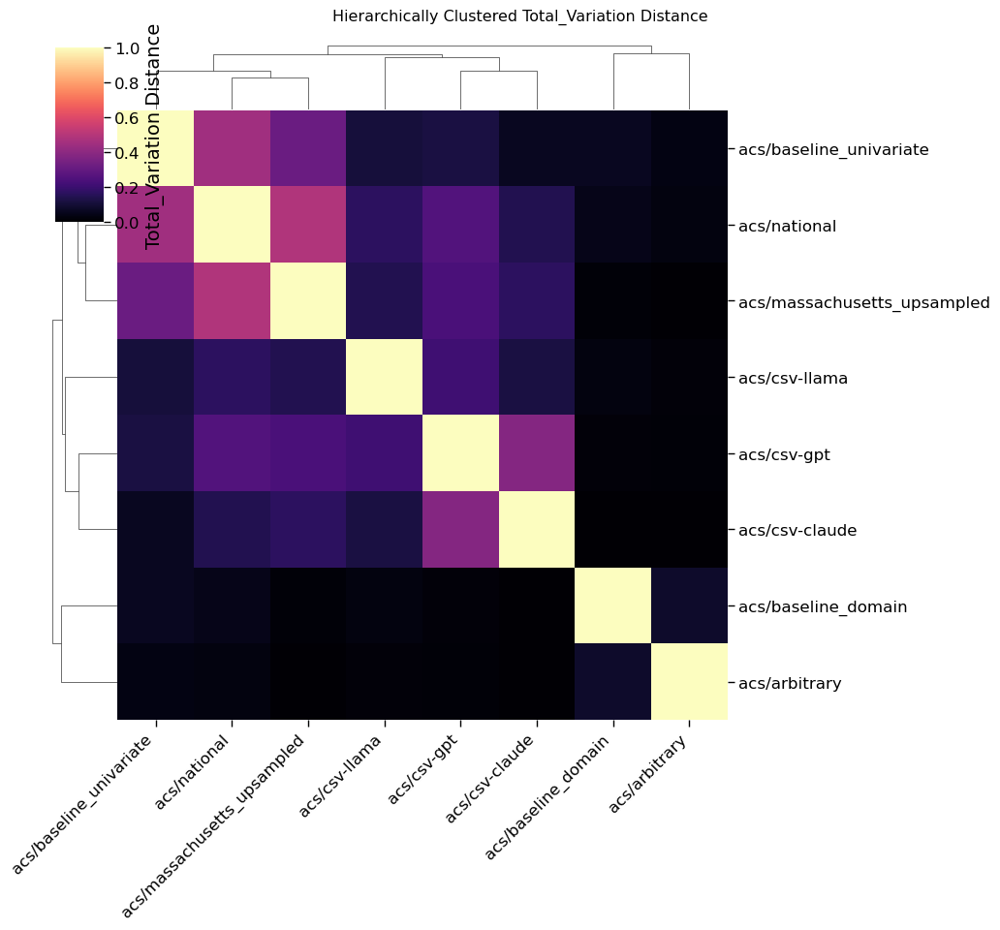

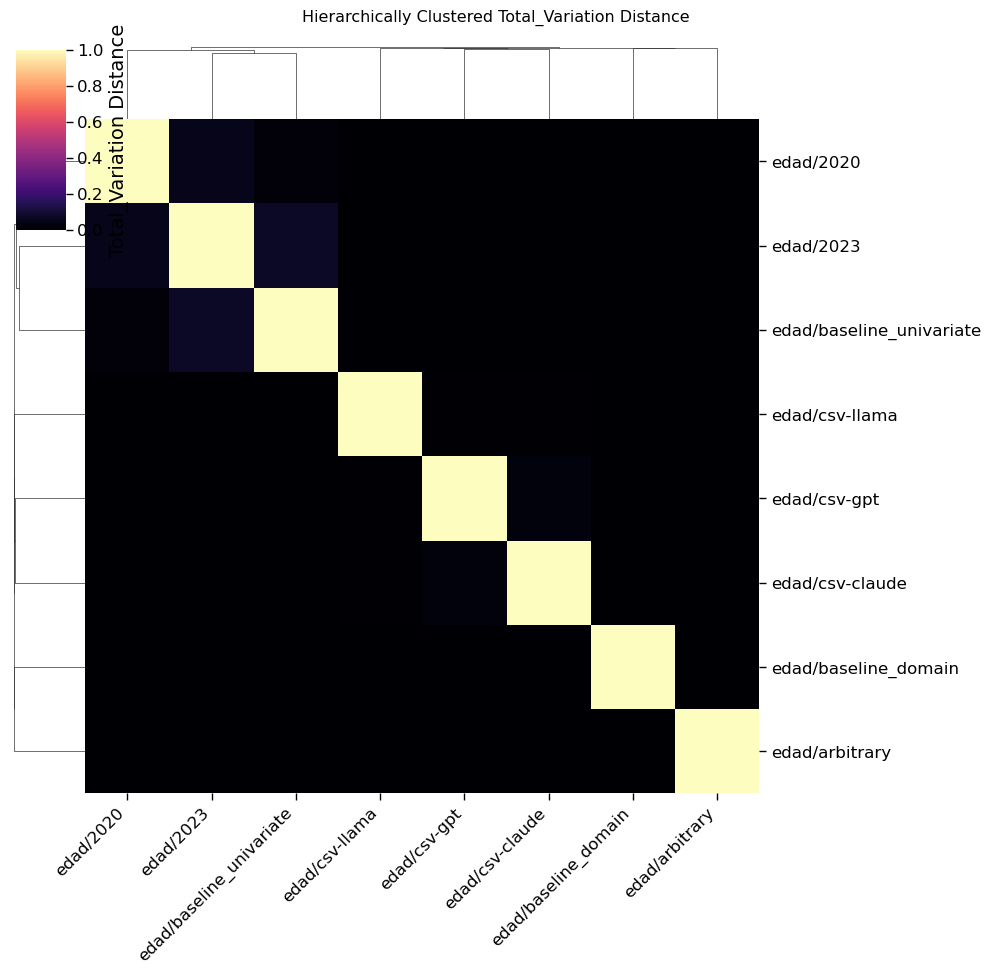

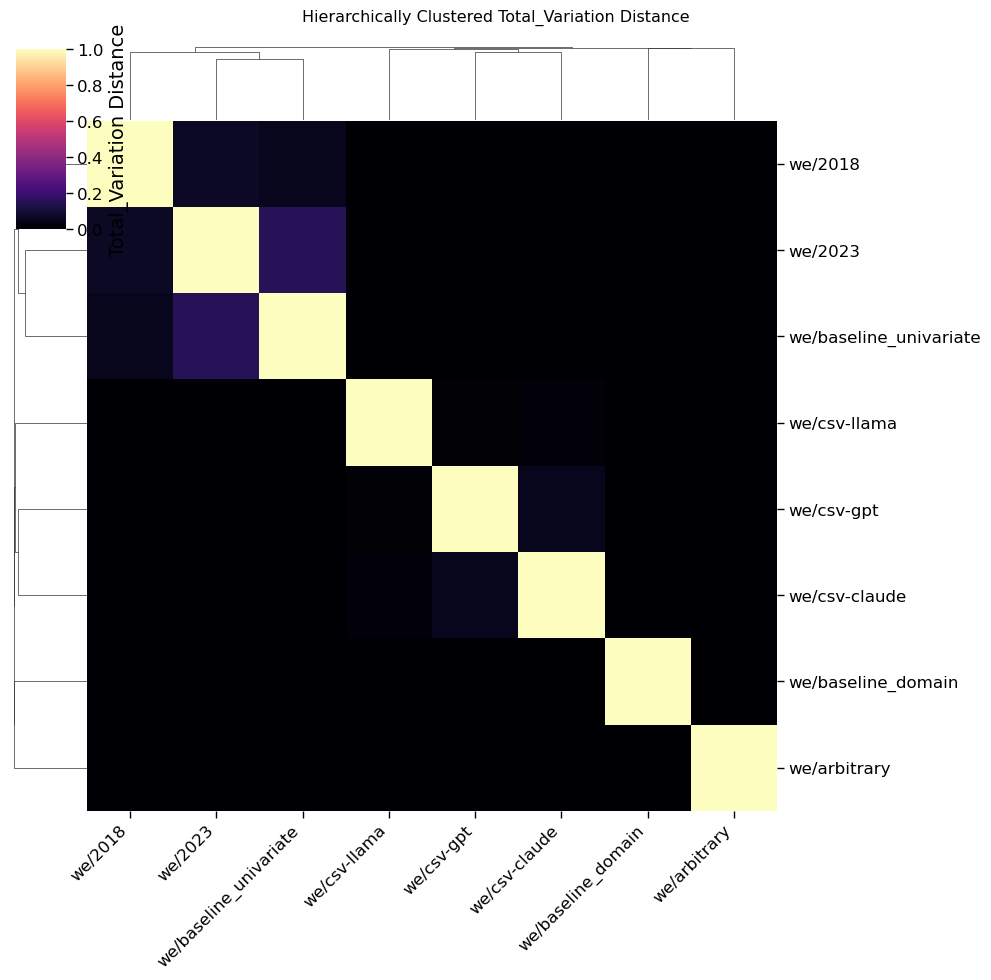

In [17]:
for experiments_name, experiments in ydnpd.ALL_EXPERIMENTS.items():

      if (additional_experiment_datasets := SUBSET_ADDITIONAL_EXPERIMENTS.get(experiments_name)):
            additional_dataset_names = [dataset_name for dataset_name, _ in additional_experiment_datasets]
            experiments = ydnpd.Experiments(experiments.test_name,
                                            experiments.dev_names + additional_dataset_names)            

      display(Markdown(f"## {experiments_name.upper()}"))

      datasets = {}
      for name in experiments.dev_names:
            try:
                  df = ydnpd.load_dataset(name)[0]
            except ValueError:
                  df = ydnpd.load_dataset(name, ADDITIONAL_PATH)[0]
            datasets[name] = df
      g = ydnpd.plot_distribution_distances(datasets)
      display(g.fig)

      ogs = (ydnpd.UtilityTask
            .plot_overall(utility_tasks_results,
                          experiments,
                          epsilon_reference=1)
                                          
      )

      for g in ogs:
            g.show()
            
      for metric in ydnpd.EVALUATION_METRICS:
          if metric not in utility_tasks_results[0]["evaluation"]:
              continue

          display(Markdown(f"### {metric}"))

          gs = ydnpd.UtilityTask.plot(utility_tasks_results, experiments, metric=metric)

          for g in gs:
              display(g.fig)
              plt.close(g.fig)

      for metric in ydnpd.EVALUATION_METRICS:
          if metric not in utility_tasks_results[0]["evaluation"]:
              continue

          display(Markdown(f"### {metric}"))
          with pd.option_context("display.max_rows", None):
              display(
                  ydnpd.UtilityTask.evaluate(utility_tasks_results, experiments, metric)
                  .multiply(100)
                  .round(1)
              )